# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

J  existe uma subpasta ou um arquivo data.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [22:57, 132kB/s]                                                                                                                                                                                                                                     
SVHN Testing Set: 64.3MB [09:09, 117kB/s]                                                                                                                                                                                                                                     


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

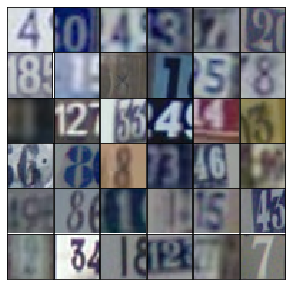

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    """
    z: noise vector
    """
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        # 5x5 kernel
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.4127... Generator Loss: 0.5544
Epoch 1/25... Discriminator Loss: 0.4049... Generator Loss: 1.8469
Epoch 1/25... Discriminator Loss: 0.1328... Generator Loss: 2.7972
Epoch 1/25... Discriminator Loss: 0.1490... Generator Loss: 2.9265
Epoch 1/25... Discriminator Loss: 0.1908... Generator Loss: 2.2790
Epoch 1/25... Discriminator Loss: 0.0981... Generator Loss: 3.1021
Epoch 1/25... Discriminator Loss: 0.0842... Generator Loss: 3.4111
Epoch 1/25... Discriminator Loss: 0.0956... Generator Loss: 3.8307
Epoch 1/25... Discriminator Loss: 0.2567... Generator Loss: 1.9203
Epoch 1/25... Discriminator Loss: 0.2373... Generator Loss: 2.2876


c:\users\christian\appdata\local\programs\python\python36\lib\site-packages\matplotlib\axes\_base.py:1330: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


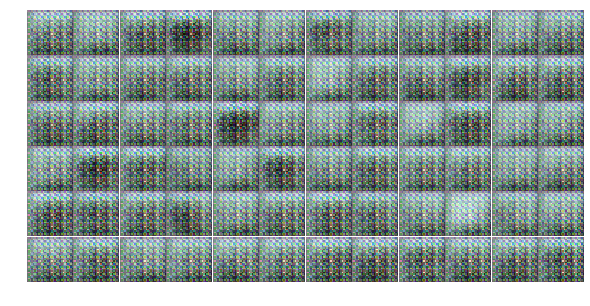

Epoch 1/25... Discriminator Loss: 0.7941... Generator Loss: 2.5893
Epoch 1/25... Discriminator Loss: 0.6012... Generator Loss: 1.9416
Epoch 1/25... Discriminator Loss: 0.6928... Generator Loss: 1.3758
Epoch 1/25... Discriminator Loss: 0.3224... Generator Loss: 2.2858
Epoch 1/25... Discriminator Loss: 0.5073... Generator Loss: 1.3630
Epoch 1/25... Discriminator Loss: 0.3029... Generator Loss: 3.0615
Epoch 1/25... Discriminator Loss: 0.3594... Generator Loss: 2.0199
Epoch 1/25... Discriminator Loss: 0.6456... Generator Loss: 1.1489
Epoch 1/25... Discriminator Loss: 0.6218... Generator Loss: 2.9015
Epoch 1/25... Discriminator Loss: 0.3431... Generator Loss: 1.9124


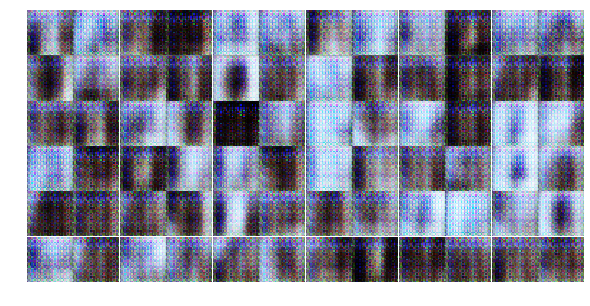

Epoch 1/25... Discriminator Loss: 0.3827... Generator Loss: 1.4921
Epoch 1/25... Discriminator Loss: 1.6586... Generator Loss: 8.1143
Epoch 1/25... Discriminator Loss: 1.2576... Generator Loss: 2.7404
Epoch 1/25... Discriminator Loss: 0.8036... Generator Loss: 0.9136
Epoch 1/25... Discriminator Loss: 0.6599... Generator Loss: 1.5730
Epoch 1/25... Discriminator Loss: 1.1487... Generator Loss: 0.7117
Epoch 1/25... Discriminator Loss: 0.4230... Generator Loss: 2.1951
Epoch 1/25... Discriminator Loss: 0.4795... Generator Loss: 1.6498
Epoch 1/25... Discriminator Loss: 1.2492... Generator Loss: 3.0163
Epoch 1/25... Discriminator Loss: 0.8904... Generator Loss: 3.0005


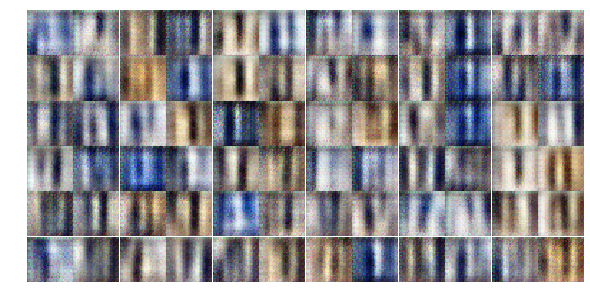

Epoch 1/25... Discriminator Loss: 0.5402... Generator Loss: 1.9090
Epoch 1/25... Discriminator Loss: 0.6685... Generator Loss: 1.8317
Epoch 1/25... Discriminator Loss: 0.5074... Generator Loss: 2.2716
Epoch 1/25... Discriminator Loss: 1.0584... Generator Loss: 0.6165
Epoch 1/25... Discriminator Loss: 0.7419... Generator Loss: 1.1037
Epoch 1/25... Discriminator Loss: 0.8192... Generator Loss: 1.2471
Epoch 1/25... Discriminator Loss: 0.9559... Generator Loss: 0.7756
Epoch 1/25... Discriminator Loss: 0.4147... Generator Loss: 2.0470
Epoch 1/25... Discriminator Loss: 0.3473... Generator Loss: 2.3822
Epoch 1/25... Discriminator Loss: 0.5495... Generator Loss: 1.7041


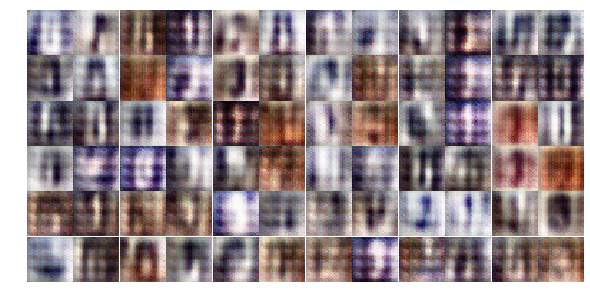

Epoch 1/25... Discriminator Loss: 0.9149... Generator Loss: 2.0310
Epoch 1/25... Discriminator Loss: 1.0610... Generator Loss: 1.0147
Epoch 1/25... Discriminator Loss: 0.8683... Generator Loss: 3.0712
Epoch 1/25... Discriminator Loss: 0.7448... Generator Loss: 3.3164
Epoch 1/25... Discriminator Loss: 0.7650... Generator Loss: 1.5522
Epoch 1/25... Discriminator Loss: 2.1728... Generator Loss: 0.2636
Epoch 1/25... Discriminator Loss: 0.8306... Generator Loss: 1.0158
Epoch 1/25... Discriminator Loss: 1.1603... Generator Loss: 1.0797
Epoch 1/25... Discriminator Loss: 0.9406... Generator Loss: 0.9047
Epoch 1/25... Discriminator Loss: 0.9008... Generator Loss: 0.9339


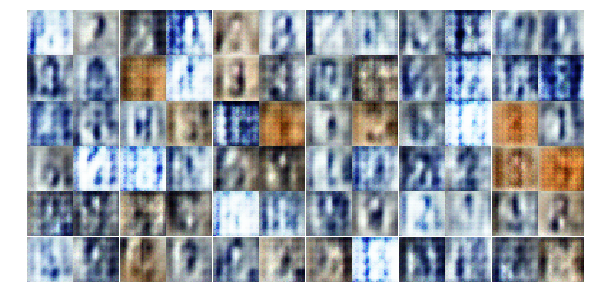

Epoch 1/25... Discriminator Loss: 0.8289... Generator Loss: 1.3736
Epoch 1/25... Discriminator Loss: 0.8017... Generator Loss: 1.2410
Epoch 1/25... Discriminator Loss: 0.9644... Generator Loss: 1.4893
Epoch 1/25... Discriminator Loss: 1.0866... Generator Loss: 0.8166
Epoch 1/25... Discriminator Loss: 1.0102... Generator Loss: 0.8137
Epoch 1/25... Discriminator Loss: 0.5999... Generator Loss: 1.4907
Epoch 1/25... Discriminator Loss: 0.7645... Generator Loss: 1.3531
Epoch 2/25... Discriminator Loss: 1.0749... Generator Loss: 1.1266
Epoch 2/25... Discriminator Loss: 0.6914... Generator Loss: 1.6712
Epoch 2/25... Discriminator Loss: 1.1053... Generator Loss: 0.6036


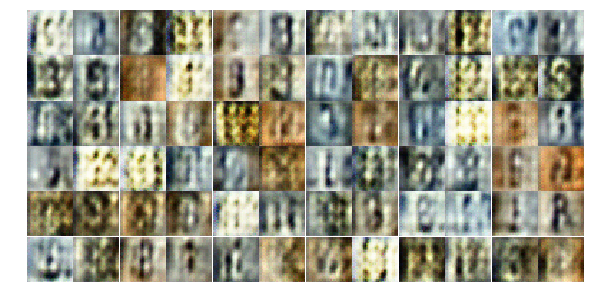

Epoch 2/25... Discriminator Loss: 1.3551... Generator Loss: 0.9941
Epoch 2/25... Discriminator Loss: 1.4607... Generator Loss: 1.4465
Epoch 2/25... Discriminator Loss: 1.0311... Generator Loss: 0.9279
Epoch 2/25... Discriminator Loss: 0.8202... Generator Loss: 1.3514
Epoch 2/25... Discriminator Loss: 1.1183... Generator Loss: 0.7854
Epoch 2/25... Discriminator Loss: 0.9842... Generator Loss: 0.9693
Epoch 2/25... Discriminator Loss: 1.1528... Generator Loss: 0.9860
Epoch 2/25... Discriminator Loss: 1.0087... Generator Loss: 1.0835
Epoch 2/25... Discriminator Loss: 1.1332... Generator Loss: 0.7256
Epoch 2/25... Discriminator Loss: 0.9716... Generator Loss: 0.9775


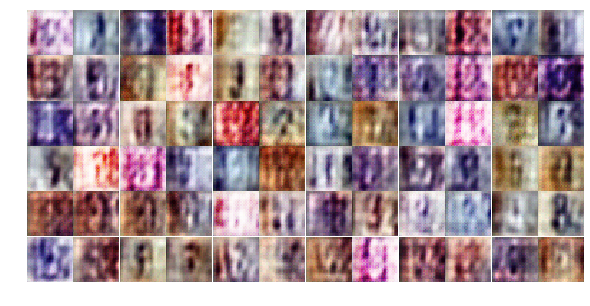

Epoch 2/25... Discriminator Loss: 1.0517... Generator Loss: 1.0455
Epoch 2/25... Discriminator Loss: 0.8533... Generator Loss: 1.7214
Epoch 2/25... Discriminator Loss: 0.8473... Generator Loss: 1.0260
Epoch 2/25... Discriminator Loss: 1.3003... Generator Loss: 0.6358
Epoch 2/25... Discriminator Loss: 1.1460... Generator Loss: 0.8530
Epoch 2/25... Discriminator Loss: 1.2048... Generator Loss: 0.8423
Epoch 2/25... Discriminator Loss: 1.2339... Generator Loss: 0.8034
Epoch 2/25... Discriminator Loss: 1.1282... Generator Loss: 0.8336
Epoch 2/25... Discriminator Loss: 1.2053... Generator Loss: 1.0737
Epoch 2/25... Discriminator Loss: 1.2982... Generator Loss: 0.8331


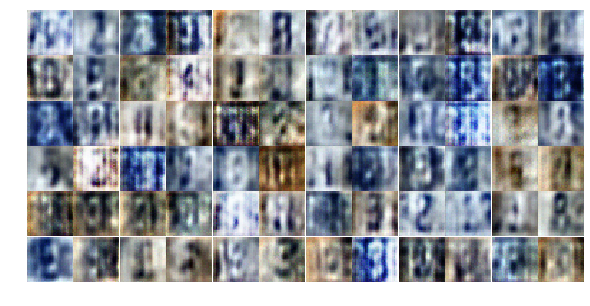

Epoch 2/25... Discriminator Loss: 1.2990... Generator Loss: 0.6947
Epoch 2/25... Discriminator Loss: 0.9515... Generator Loss: 1.1745
Epoch 2/25... Discriminator Loss: 1.0356... Generator Loss: 0.9101
Epoch 2/25... Discriminator Loss: 0.9238... Generator Loss: 1.2435
Epoch 2/25... Discriminator Loss: 0.7924... Generator Loss: 1.4291
Epoch 2/25... Discriminator Loss: 0.9638... Generator Loss: 1.1465
Epoch 2/25... Discriminator Loss: 1.0600... Generator Loss: 0.8666
Epoch 2/25... Discriminator Loss: 1.0527... Generator Loss: 0.7587
Epoch 2/25... Discriminator Loss: 1.1464... Generator Loss: 0.8615
Epoch 2/25... Discriminator Loss: 0.9283... Generator Loss: 1.1498


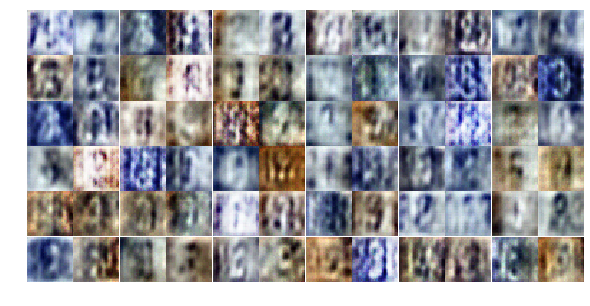

Epoch 2/25... Discriminator Loss: 1.0621... Generator Loss: 1.0675
Epoch 2/25... Discriminator Loss: 1.2082... Generator Loss: 1.2141
Epoch 2/25... Discriminator Loss: 1.3388... Generator Loss: 0.6495
Epoch 2/25... Discriminator Loss: 1.2644... Generator Loss: 0.7487
Epoch 2/25... Discriminator Loss: 0.9365... Generator Loss: 1.2668
Epoch 2/25... Discriminator Loss: 1.0175... Generator Loss: 1.0380
Epoch 2/25... Discriminator Loss: 1.0714... Generator Loss: 0.9558
Epoch 2/25... Discriminator Loss: 1.2034... Generator Loss: 0.9372
Epoch 2/25... Discriminator Loss: 1.2809... Generator Loss: 0.8911
Epoch 2/25... Discriminator Loss: 0.9039... Generator Loss: 1.0554


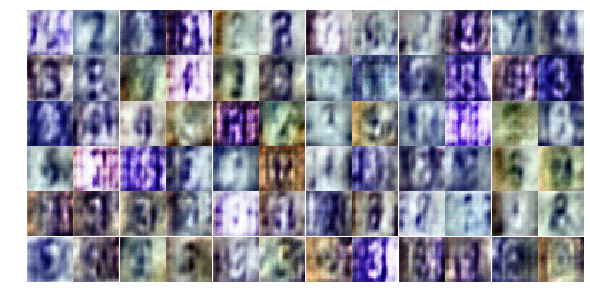

Epoch 2/25... Discriminator Loss: 0.9261... Generator Loss: 1.2116
Epoch 2/25... Discriminator Loss: 1.2371... Generator Loss: 1.0069
Epoch 2/25... Discriminator Loss: 0.9323... Generator Loss: 0.9962
Epoch 2/25... Discriminator Loss: 1.0741... Generator Loss: 0.8905
Epoch 2/25... Discriminator Loss: 0.9539... Generator Loss: 1.0493
Epoch 2/25... Discriminator Loss: 1.2296... Generator Loss: 0.8746
Epoch 2/25... Discriminator Loss: 0.9556... Generator Loss: 1.1751
Epoch 2/25... Discriminator Loss: 1.0851... Generator Loss: 1.0766
Epoch 2/25... Discriminator Loss: 1.1152... Generator Loss: 0.9713
Epoch 2/25... Discriminator Loss: 0.8925... Generator Loss: 1.1576


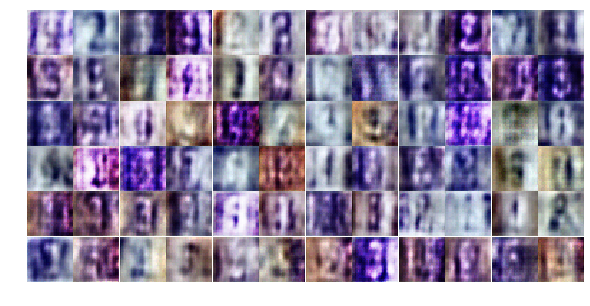

Epoch 2/25... Discriminator Loss: 1.1079... Generator Loss: 1.1187
Epoch 2/25... Discriminator Loss: 1.1035... Generator Loss: 0.7087
Epoch 2/25... Discriminator Loss: 1.1635... Generator Loss: 0.7511
Epoch 2/25... Discriminator Loss: 1.1297... Generator Loss: 0.9057
Epoch 3/25... Discriminator Loss: 0.9657... Generator Loss: 1.7853
Epoch 3/25... Discriminator Loss: 1.1477... Generator Loss: 0.8622
Epoch 3/25... Discriminator Loss: 1.1168... Generator Loss: 0.8353
Epoch 3/25... Discriminator Loss: 0.9213... Generator Loss: 0.9858
Epoch 3/25... Discriminator Loss: 0.9081... Generator Loss: 1.3709
Epoch 3/25... Discriminator Loss: 0.9037... Generator Loss: 1.4665


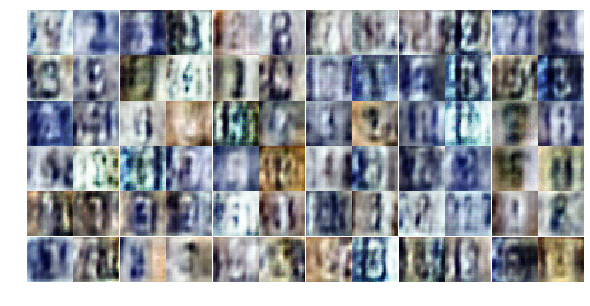

Epoch 3/25... Discriminator Loss: 0.9389... Generator Loss: 1.4158
Epoch 3/25... Discriminator Loss: 0.8724... Generator Loss: 1.0887
Epoch 3/25... Discriminator Loss: 0.9723... Generator Loss: 1.2311
Epoch 3/25... Discriminator Loss: 0.9393... Generator Loss: 1.0264
Epoch 3/25... Discriminator Loss: 0.9807... Generator Loss: 0.8754
Epoch 3/25... Discriminator Loss: 0.9570... Generator Loss: 0.8228
Epoch 3/25... Discriminator Loss: 1.1192... Generator Loss: 0.7256
Epoch 3/25... Discriminator Loss: 0.6683... Generator Loss: 1.5043
Epoch 3/25... Discriminator Loss: 0.8608... Generator Loss: 1.2861
Epoch 3/25... Discriminator Loss: 0.6835... Generator Loss: 1.5101


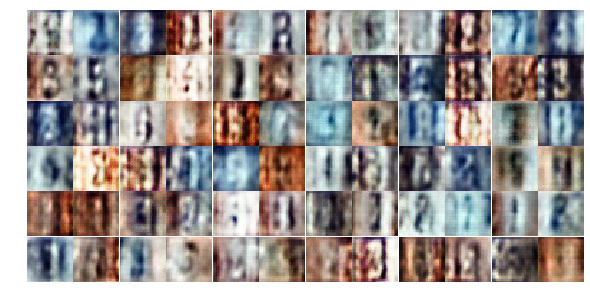

Epoch 3/25... Discriminator Loss: 0.5778... Generator Loss: 1.6472
Epoch 3/25... Discriminator Loss: 0.8848... Generator Loss: 0.9845
Epoch 3/25... Discriminator Loss: 0.8877... Generator Loss: 1.0198
Epoch 3/25... Discriminator Loss: 1.2294... Generator Loss: 1.8892
Epoch 3/25... Discriminator Loss: 0.7330... Generator Loss: 2.0179
Epoch 3/25... Discriminator Loss: 0.8007... Generator Loss: 1.3058
Epoch 3/25... Discriminator Loss: 0.9715... Generator Loss: 1.2563
Epoch 3/25... Discriminator Loss: 0.8451... Generator Loss: 1.7645
Epoch 3/25... Discriminator Loss: 0.6007... Generator Loss: 1.1868
Epoch 3/25... Discriminator Loss: 0.9213... Generator Loss: 0.9126


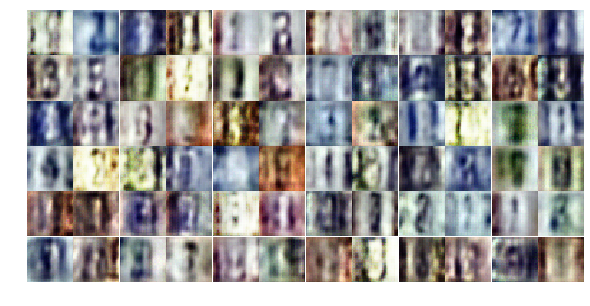

Epoch 3/25... Discriminator Loss: 0.7909... Generator Loss: 1.8794
Epoch 3/25... Discriminator Loss: 0.7500... Generator Loss: 1.4353
Epoch 3/25... Discriminator Loss: 0.6663... Generator Loss: 1.1789
Epoch 3/25... Discriminator Loss: 0.7205... Generator Loss: 0.9457
Epoch 3/25... Discriminator Loss: 0.6480... Generator Loss: 1.4935
Epoch 3/25... Discriminator Loss: 0.6196... Generator Loss: 1.2475
Epoch 3/25... Discriminator Loss: 1.0299... Generator Loss: 0.7004
Epoch 3/25... Discriminator Loss: 1.1671... Generator Loss: 0.6007
Epoch 3/25... Discriminator Loss: 0.5219... Generator Loss: 1.6604
Epoch 3/25... Discriminator Loss: 0.8028... Generator Loss: 1.3805


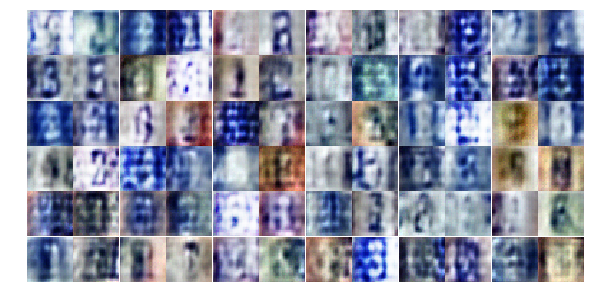

Epoch 3/25... Discriminator Loss: 1.1833... Generator Loss: 2.6945
Epoch 3/25... Discriminator Loss: 0.5662... Generator Loss: 1.7074
Epoch 3/25... Discriminator Loss: 1.0239... Generator Loss: 1.6598
Epoch 3/25... Discriminator Loss: 0.6527... Generator Loss: 1.1825
Epoch 3/25... Discriminator Loss: 0.7403... Generator Loss: 2.8736
Epoch 3/25... Discriminator Loss: 0.9861... Generator Loss: 0.7092
Epoch 3/25... Discriminator Loss: 0.7315... Generator Loss: 1.6775
Epoch 3/25... Discriminator Loss: 0.7113... Generator Loss: 1.1226
Epoch 3/25... Discriminator Loss: 0.6244... Generator Loss: 1.2192
Epoch 3/25... Discriminator Loss: 0.5361... Generator Loss: 1.9324


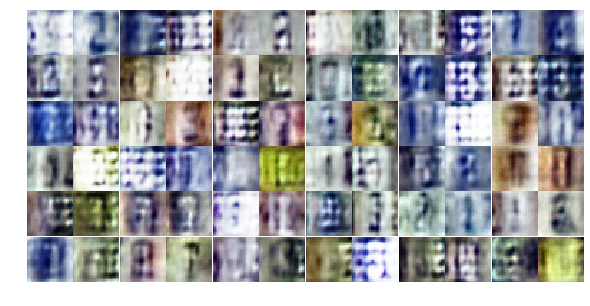

Epoch 3/25... Discriminator Loss: 0.4269... Generator Loss: 1.5330
Epoch 3/25... Discriminator Loss: 1.1584... Generator Loss: 2.1786
Epoch 3/25... Discriminator Loss: 0.6403... Generator Loss: 1.3766
Epoch 3/25... Discriminator Loss: 0.5227... Generator Loss: 1.3691
Epoch 3/25... Discriminator Loss: 0.6054... Generator Loss: 1.3410
Epoch 3/25... Discriminator Loss: 0.5397... Generator Loss: 1.9708
Epoch 3/25... Discriminator Loss: 0.3761... Generator Loss: 2.0770
Epoch 3/25... Discriminator Loss: 0.4661... Generator Loss: 1.6886
Epoch 3/25... Discriminator Loss: 0.6566... Generator Loss: 2.2907
Epoch 3/25... Discriminator Loss: 0.4097... Generator Loss: 1.8921


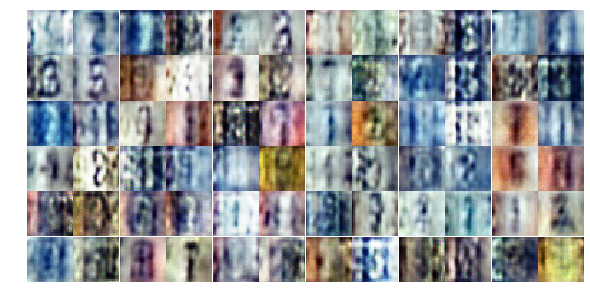

Epoch 3/25... Discriminator Loss: 0.9793... Generator Loss: 0.6859
Epoch 4/25... Discriminator Loss: 0.7769... Generator Loss: 1.0015
Epoch 4/25... Discriminator Loss: 0.6067... Generator Loss: 1.2844
Epoch 4/25... Discriminator Loss: 0.5966... Generator Loss: 1.1995
Epoch 4/25... Discriminator Loss: 0.7105... Generator Loss: 3.0396
Epoch 4/25... Discriminator Loss: 0.4947... Generator Loss: 1.3822
Epoch 4/25... Discriminator Loss: 0.6591... Generator Loss: 2.3322
Epoch 4/25... Discriminator Loss: 0.6563... Generator Loss: 1.0753
Epoch 4/25... Discriminator Loss: 0.6747... Generator Loss: 0.9734
Epoch 4/25... Discriminator Loss: 0.7246... Generator Loss: 1.0405


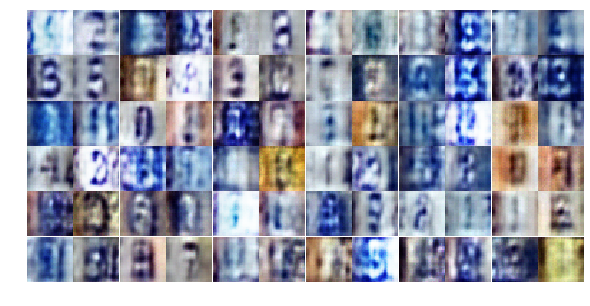

Epoch 4/25... Discriminator Loss: 0.3871... Generator Loss: 1.7956
Epoch 4/25... Discriminator Loss: 0.4769... Generator Loss: 1.4554
Epoch 4/25... Discriminator Loss: 0.4702... Generator Loss: 1.6684
Epoch 4/25... Discriminator Loss: 0.5112... Generator Loss: 1.4319
Epoch 4/25... Discriminator Loss: 1.4323... Generator Loss: 0.3906
Epoch 4/25... Discriminator Loss: 1.3102... Generator Loss: 0.5266
Epoch 4/25... Discriminator Loss: 0.6682... Generator Loss: 1.2051
Epoch 4/25... Discriminator Loss: 0.7016... Generator Loss: 1.0700
Epoch 4/25... Discriminator Loss: 0.8006... Generator Loss: 0.9030
Epoch 4/25... Discriminator Loss: 0.6295... Generator Loss: 1.5918


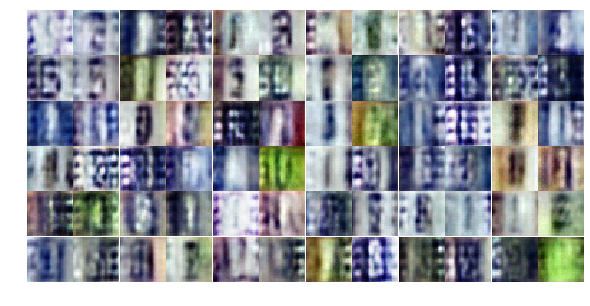

Epoch 4/25... Discriminator Loss: 0.3734... Generator Loss: 1.9545
Epoch 4/25... Discriminator Loss: 0.4883... Generator Loss: 1.4064
Epoch 4/25... Discriminator Loss: 0.3689... Generator Loss: 2.1146
Epoch 4/25... Discriminator Loss: 0.6273... Generator Loss: 1.2436
Epoch 4/25... Discriminator Loss: 0.4530... Generator Loss: 1.6285
Epoch 4/25... Discriminator Loss: 0.5839... Generator Loss: 2.6261
Epoch 4/25... Discriminator Loss: 0.4680... Generator Loss: 1.5553
Epoch 4/25... Discriminator Loss: 0.6861... Generator Loss: 1.1039
Epoch 4/25... Discriminator Loss: 0.4313... Generator Loss: 1.5847
Epoch 4/25... Discriminator Loss: 0.9419... Generator Loss: 3.5015


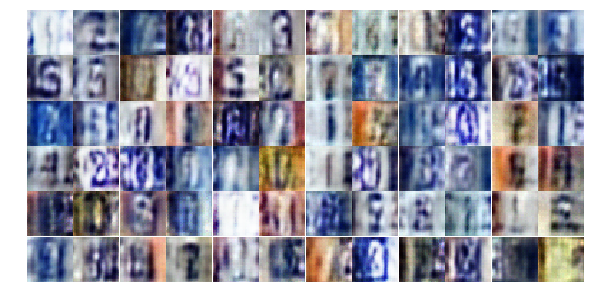

Epoch 4/25... Discriminator Loss: 0.4803... Generator Loss: 1.6428
Epoch 4/25... Discriminator Loss: 0.5915... Generator Loss: 2.3406
Epoch 4/25... Discriminator Loss: 0.3721... Generator Loss: 2.1002
Epoch 4/25... Discriminator Loss: 0.5480... Generator Loss: 1.4908
Epoch 4/25... Discriminator Loss: 0.2196... Generator Loss: 2.2663
Epoch 4/25... Discriminator Loss: 0.5015... Generator Loss: 1.3519
Epoch 4/25... Discriminator Loss: 0.6838... Generator Loss: 3.5796
Epoch 4/25... Discriminator Loss: 0.3106... Generator Loss: 1.7747
Epoch 4/25... Discriminator Loss: 0.4080... Generator Loss: 1.7757
Epoch 4/25... Discriminator Loss: 0.4833... Generator Loss: 1.9675


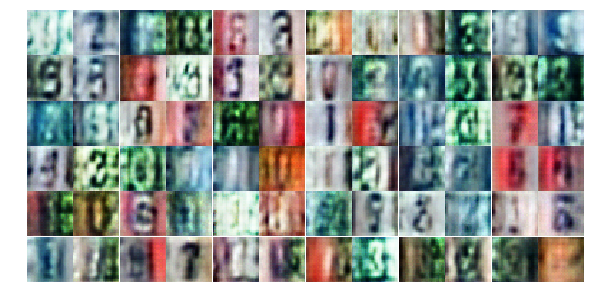

Epoch 4/25... Discriminator Loss: 0.5916... Generator Loss: 1.2445
Epoch 4/25... Discriminator Loss: 0.5628... Generator Loss: 1.4042
Epoch 4/25... Discriminator Loss: 0.5849... Generator Loss: 1.2781
Epoch 4/25... Discriminator Loss: 0.4813... Generator Loss: 1.3755
Epoch 4/25... Discriminator Loss: 0.4342... Generator Loss: 1.8146
Epoch 4/25... Discriminator Loss: 0.6492... Generator Loss: 2.0767
Epoch 4/25... Discriminator Loss: 0.9591... Generator Loss: 0.6960
Epoch 4/25... Discriminator Loss: 0.6331... Generator Loss: 1.5998
Epoch 4/25... Discriminator Loss: 0.5546... Generator Loss: 1.4159
Epoch 4/25... Discriminator Loss: 0.7681... Generator Loss: 2.6553


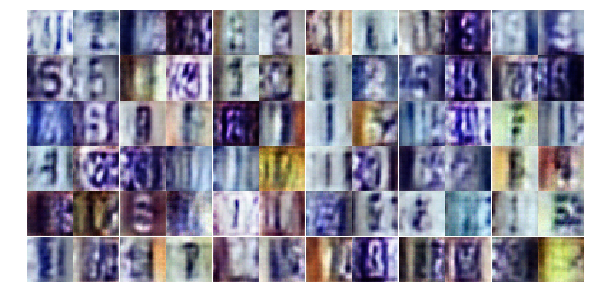

Epoch 4/25... Discriminator Loss: 0.5950... Generator Loss: 1.2827
Epoch 4/25... Discriminator Loss: 0.5637... Generator Loss: 1.3031
Epoch 4/25... Discriminator Loss: 0.4431... Generator Loss: 1.8365
Epoch 4/25... Discriminator Loss: 0.4832... Generator Loss: 1.6652
Epoch 4/25... Discriminator Loss: 0.3961... Generator Loss: 1.7337
Epoch 4/25... Discriminator Loss: 0.5772... Generator Loss: 1.7231
Epoch 4/25... Discriminator Loss: 0.4990... Generator Loss: 1.2753
Epoch 4/25... Discriminator Loss: 0.4659... Generator Loss: 1.6341
Epoch 4/25... Discriminator Loss: 0.5148... Generator Loss: 1.8242
Epoch 5/25... Discriminator Loss: 0.4494... Generator Loss: 1.6320


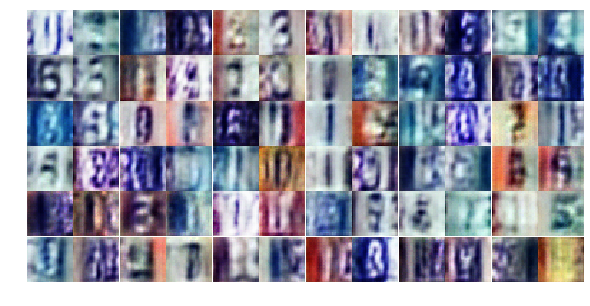

Epoch 5/25... Discriminator Loss: 1.3205... Generator Loss: 0.4464
Epoch 5/25... Discriminator Loss: 0.5660... Generator Loss: 1.2594
Epoch 5/25... Discriminator Loss: 0.9226... Generator Loss: 0.8088
Epoch 5/25... Discriminator Loss: 0.4648... Generator Loss: 1.4692
Epoch 5/25... Discriminator Loss: 0.6507... Generator Loss: 2.7244
Epoch 5/25... Discriminator Loss: 0.8149... Generator Loss: 0.8985
Epoch 5/25... Discriminator Loss: 0.5030... Generator Loss: 1.4883
Epoch 5/25... Discriminator Loss: 0.5279... Generator Loss: 1.4282
Epoch 5/25... Discriminator Loss: 0.5599... Generator Loss: 1.1666
Epoch 5/25... Discriminator Loss: 0.8669... Generator Loss: 0.7971


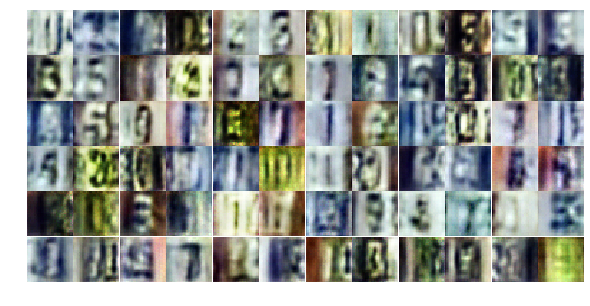

Epoch 5/25... Discriminator Loss: 0.7444... Generator Loss: 0.8280
Epoch 5/25... Discriminator Loss: 1.8855... Generator Loss: 4.0382
Epoch 5/25... Discriminator Loss: 0.5416... Generator Loss: 2.2132
Epoch 5/25... Discriminator Loss: 0.6989... Generator Loss: 1.2419
Epoch 5/25... Discriminator Loss: 0.7009... Generator Loss: 1.0847
Epoch 5/25... Discriminator Loss: 0.9122... Generator Loss: 0.9400
Epoch 5/25... Discriminator Loss: 0.5718... Generator Loss: 1.5654
Epoch 5/25... Discriminator Loss: 0.7260... Generator Loss: 1.1777
Epoch 5/25... Discriminator Loss: 0.4108... Generator Loss: 2.7318
Epoch 5/25... Discriminator Loss: 0.4877... Generator Loss: 1.6230


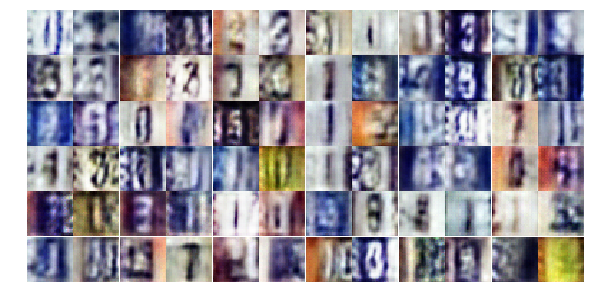

Epoch 5/25... Discriminator Loss: 0.6130... Generator Loss: 1.0634
Epoch 5/25... Discriminator Loss: 0.6414... Generator Loss: 1.2198
Epoch 5/25... Discriminator Loss: 0.5071... Generator Loss: 2.0413
Epoch 5/25... Discriminator Loss: 0.8455... Generator Loss: 1.3599
Epoch 5/25... Discriminator Loss: 1.1656... Generator Loss: 0.5548
Epoch 5/25... Discriminator Loss: 0.6219... Generator Loss: 1.4832
Epoch 5/25... Discriminator Loss: 0.7274... Generator Loss: 0.8638
Epoch 5/25... Discriminator Loss: 0.3383... Generator Loss: 1.8874
Epoch 5/25... Discriminator Loss: 1.8650... Generator Loss: 0.3472
Epoch 5/25... Discriminator Loss: 0.4695... Generator Loss: 1.5576


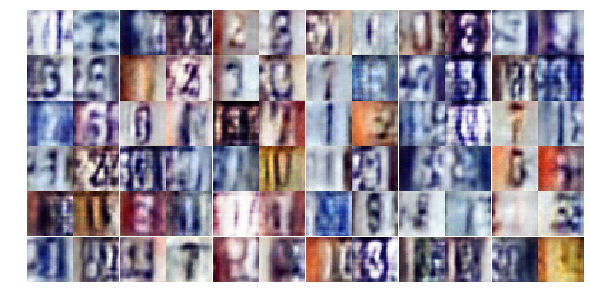

Epoch 5/25... Discriminator Loss: 0.6556... Generator Loss: 1.0588
Epoch 5/25... Discriminator Loss: 0.4389... Generator Loss: 1.5055
Epoch 5/25... Discriminator Loss: 0.4164... Generator Loss: 1.8128
Epoch 5/25... Discriminator Loss: 0.5648... Generator Loss: 1.1973
Epoch 5/25... Discriminator Loss: 0.5872... Generator Loss: 1.3240
Epoch 5/25... Discriminator Loss: 0.5175... Generator Loss: 1.9734
Epoch 5/25... Discriminator Loss: 0.6998... Generator Loss: 0.9255
Epoch 5/25... Discriminator Loss: 0.6752... Generator Loss: 0.9563
Epoch 5/25... Discriminator Loss: 0.7804... Generator Loss: 0.8707
Epoch 5/25... Discriminator Loss: 0.7502... Generator Loss: 0.8358


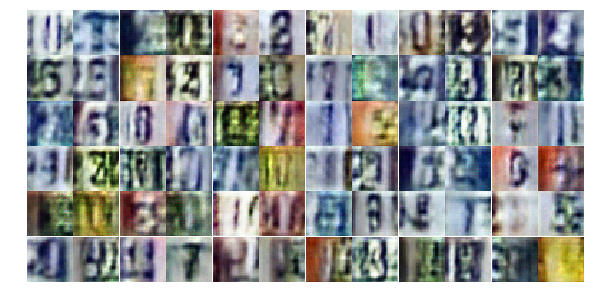

Epoch 5/25... Discriminator Loss: 0.4295... Generator Loss: 2.2753
Epoch 5/25... Discriminator Loss: 0.8094... Generator Loss: 0.7558
Epoch 5/25... Discriminator Loss: 1.7281... Generator Loss: 0.2708
Epoch 5/25... Discriminator Loss: 0.7607... Generator Loss: 1.1369
Epoch 5/25... Discriminator Loss: 0.7904... Generator Loss: 0.9640
Epoch 5/25... Discriminator Loss: 0.6698... Generator Loss: 1.4188
Epoch 5/25... Discriminator Loss: 0.7056... Generator Loss: 1.0060
Epoch 5/25... Discriminator Loss: 0.6712... Generator Loss: 1.2254
Epoch 5/25... Discriminator Loss: 1.0613... Generator Loss: 0.5497
Epoch 5/25... Discriminator Loss: 0.6600... Generator Loss: 1.5415


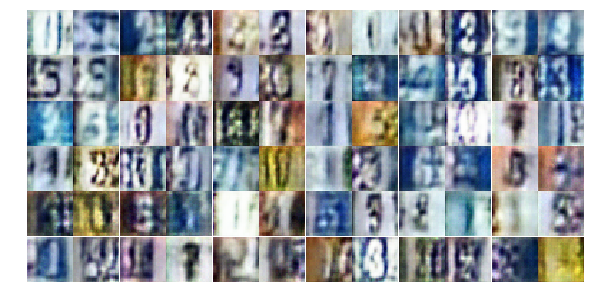

Epoch 5/25... Discriminator Loss: 0.5064... Generator Loss: 1.3236
Epoch 5/25... Discriminator Loss: 1.0235... Generator Loss: 0.5797
Epoch 5/25... Discriminator Loss: 0.7376... Generator Loss: 0.9426
Epoch 5/25... Discriminator Loss: 0.8156... Generator Loss: 0.7884
Epoch 5/25... Discriminator Loss: 0.6096... Generator Loss: 1.2280
Epoch 5/25... Discriminator Loss: 1.4334... Generator Loss: 0.4157
Epoch 6/25... Discriminator Loss: 0.6433... Generator Loss: 1.2889
Epoch 6/25... Discriminator Loss: 0.4903... Generator Loss: 1.4536
Epoch 6/25... Discriminator Loss: 0.6077... Generator Loss: 1.2388
Epoch 6/25... Discriminator Loss: 0.6543... Generator Loss: 1.0617


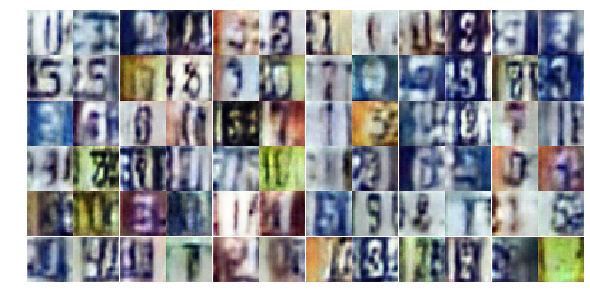

Epoch 6/25... Discriminator Loss: 1.0327... Generator Loss: 0.6324
Epoch 6/25... Discriminator Loss: 0.6148... Generator Loss: 1.2867
Epoch 6/25... Discriminator Loss: 0.5970... Generator Loss: 1.6644
Epoch 6/25... Discriminator Loss: 0.6348... Generator Loss: 1.4235
Epoch 6/25... Discriminator Loss: 0.7499... Generator Loss: 0.8931
Epoch 6/25... Discriminator Loss: 0.5110... Generator Loss: 1.2063
Epoch 6/25... Discriminator Loss: 0.6231... Generator Loss: 1.9029
Epoch 6/25... Discriminator Loss: 0.8980... Generator Loss: 0.7607
Epoch 6/25... Discriminator Loss: 0.6955... Generator Loss: 0.9093
Epoch 6/25... Discriminator Loss: 0.7136... Generator Loss: 0.9356


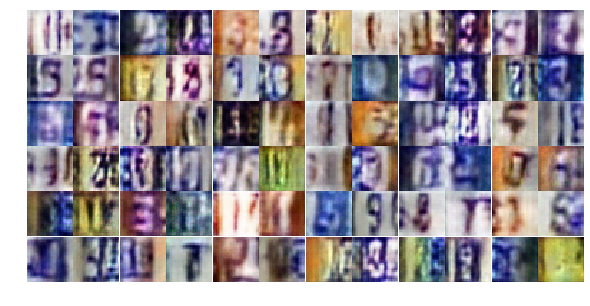

Epoch 6/25... Discriminator Loss: 0.6279... Generator Loss: 1.8812
Epoch 6/25... Discriminator Loss: 1.0704... Generator Loss: 0.5851
Epoch 6/25... Discriminator Loss: 1.9441... Generator Loss: 0.2630
Epoch 6/25... Discriminator Loss: 0.6725... Generator Loss: 1.1639
Epoch 6/25... Discriminator Loss: 0.3594... Generator Loss: 2.3824
Epoch 6/25... Discriminator Loss: 0.6165... Generator Loss: 1.3528
Epoch 6/25... Discriminator Loss: 0.5842... Generator Loss: 1.5022
Epoch 6/25... Discriminator Loss: 0.6453... Generator Loss: 1.3560
Epoch 6/25... Discriminator Loss: 0.5333... Generator Loss: 1.4275
Epoch 6/25... Discriminator Loss: 0.7735... Generator Loss: 1.0067


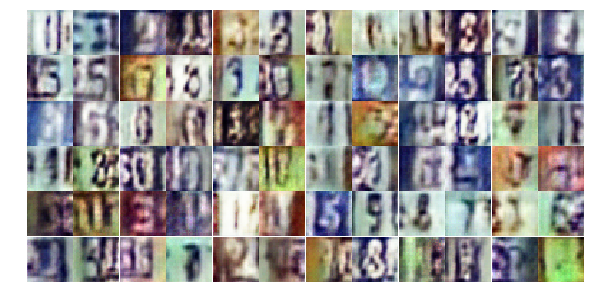

Epoch 6/25... Discriminator Loss: 0.8017... Generator Loss: 0.8405
Epoch 6/25... Discriminator Loss: 0.4920... Generator Loss: 1.4072
Epoch 6/25... Discriminator Loss: 0.9073... Generator Loss: 0.7026
Epoch 6/25... Discriminator Loss: 0.4708... Generator Loss: 1.3206
Epoch 6/25... Discriminator Loss: 0.8697... Generator Loss: 3.2544
Epoch 6/25... Discriminator Loss: 1.1129... Generator Loss: 0.6069
Epoch 6/25... Discriminator Loss: 0.7049... Generator Loss: 1.4806
Epoch 6/25... Discriminator Loss: 0.3929... Generator Loss: 1.4945
Epoch 6/25... Discriminator Loss: 0.4997... Generator Loss: 1.7655
Epoch 6/25... Discriminator Loss: 0.5632... Generator Loss: 1.5302


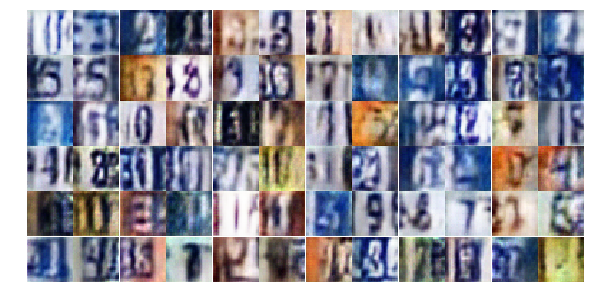

Epoch 6/25... Discriminator Loss: 1.2106... Generator Loss: 0.5305
Epoch 6/25... Discriminator Loss: 1.4313... Generator Loss: 3.5274
Epoch 6/25... Discriminator Loss: 0.7343... Generator Loss: 0.9877
Epoch 6/25... Discriminator Loss: 0.6865... Generator Loss: 0.9259
Epoch 6/25... Discriminator Loss: 0.6121... Generator Loss: 1.4547
Epoch 6/25... Discriminator Loss: 0.9528... Generator Loss: 0.7461
Epoch 6/25... Discriminator Loss: 0.4986... Generator Loss: 1.5466
Epoch 6/25... Discriminator Loss: 1.2614... Generator Loss: 0.4714
Epoch 6/25... Discriminator Loss: 0.6425... Generator Loss: 1.3664
Epoch 6/25... Discriminator Loss: 0.8337... Generator Loss: 0.8365


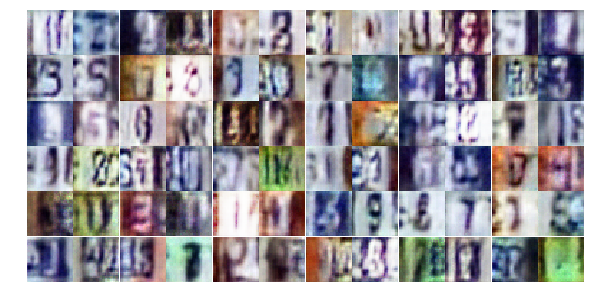

Epoch 6/25... Discriminator Loss: 1.0326... Generator Loss: 2.8299
Epoch 6/25... Discriminator Loss: 0.8836... Generator Loss: 0.7738
Epoch 6/25... Discriminator Loss: 1.0630... Generator Loss: 0.5845
Epoch 6/25... Discriminator Loss: 0.4890... Generator Loss: 1.4880
Epoch 6/25... Discriminator Loss: 0.4274... Generator Loss: 1.5940
Epoch 6/25... Discriminator Loss: 0.6243... Generator Loss: 1.0007
Epoch 6/25... Discriminator Loss: 1.4211... Generator Loss: 0.4090
Epoch 6/25... Discriminator Loss: 1.8409... Generator Loss: 0.2698
Epoch 6/25... Discriminator Loss: 1.0946... Generator Loss: 0.5993
Epoch 6/25... Discriminator Loss: 1.3518... Generator Loss: 0.4282


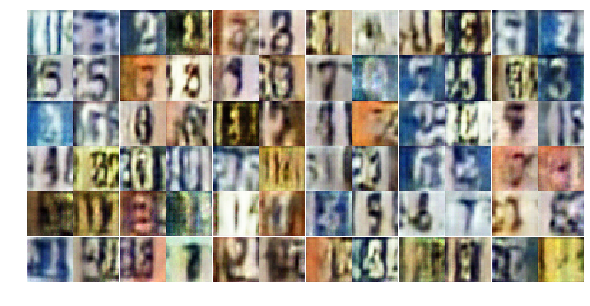

Epoch 6/25... Discriminator Loss: 0.5111... Generator Loss: 1.4552
Epoch 6/25... Discriminator Loss: 0.5502... Generator Loss: 1.2909
Epoch 6/25... Discriminator Loss: 0.9496... Generator Loss: 0.7209
Epoch 7/25... Discriminator Loss: 0.6168... Generator Loss: 1.5416
Epoch 7/25... Discriminator Loss: 0.5744... Generator Loss: 1.3310
Epoch 7/25... Discriminator Loss: 0.4860... Generator Loss: 1.4586
Epoch 7/25... Discriminator Loss: 0.5828... Generator Loss: 1.1644
Epoch 7/25... Discriminator Loss: 0.7353... Generator Loss: 2.5957
Epoch 7/25... Discriminator Loss: 0.7806... Generator Loss: 2.5533
Epoch 7/25... Discriminator Loss: 1.5714... Generator Loss: 0.3536


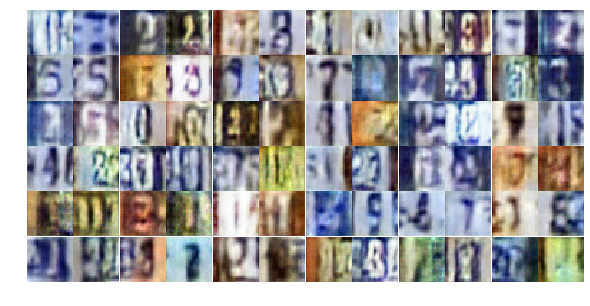

Epoch 7/25... Discriminator Loss: 0.6130... Generator Loss: 1.2814
Epoch 7/25... Discriminator Loss: 0.6856... Generator Loss: 0.9634
Epoch 7/25... Discriminator Loss: 0.9652... Generator Loss: 0.7060
Epoch 7/25... Discriminator Loss: 0.6175... Generator Loss: 1.3148
Epoch 7/25... Discriminator Loss: 0.4403... Generator Loss: 1.4353
Epoch 7/25... Discriminator Loss: 0.7588... Generator Loss: 0.9189
Epoch 7/25... Discriminator Loss: 0.9259... Generator Loss: 2.9203
Epoch 7/25... Discriminator Loss: 0.7827... Generator Loss: 1.5003
Epoch 7/25... Discriminator Loss: 0.7102... Generator Loss: 1.9579
Epoch 7/25... Discriminator Loss: 0.6421... Generator Loss: 1.0394


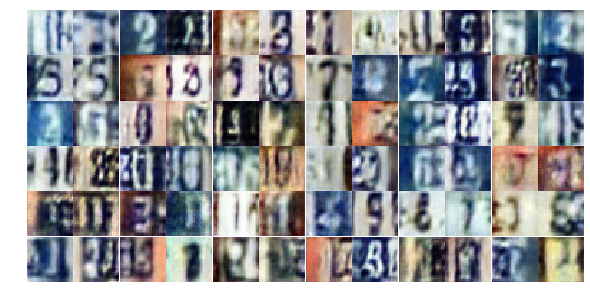

Epoch 7/25... Discriminator Loss: 0.6845... Generator Loss: 0.9854
Epoch 7/25... Discriminator Loss: 0.5532... Generator Loss: 1.2313
Epoch 7/25... Discriminator Loss: 0.6917... Generator Loss: 1.1383
Epoch 7/25... Discriminator Loss: 0.7256... Generator Loss: 1.0097
Epoch 7/25... Discriminator Loss: 0.5572... Generator Loss: 1.3291
Epoch 7/25... Discriminator Loss: 0.4758... Generator Loss: 1.3153
Epoch 7/25... Discriminator Loss: 0.5905... Generator Loss: 1.1669
Epoch 7/25... Discriminator Loss: 1.3496... Generator Loss: 0.4022
Epoch 7/25... Discriminator Loss: 0.4019... Generator Loss: 1.6537
Epoch 7/25... Discriminator Loss: 0.5763... Generator Loss: 1.2543


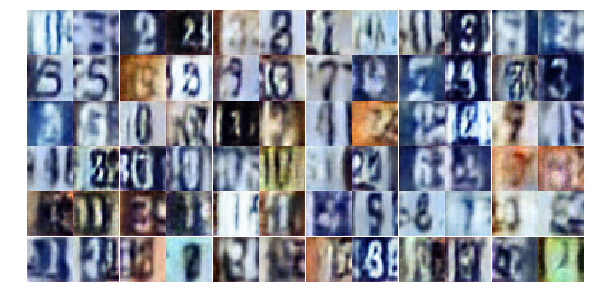

Epoch 7/25... Discriminator Loss: 0.8040... Generator Loss: 1.7352
Epoch 7/25... Discriminator Loss: 0.7040... Generator Loss: 0.9193
Epoch 7/25... Discriminator Loss: 0.5147... Generator Loss: 1.5458
Epoch 7/25... Discriminator Loss: 0.8266... Generator Loss: 0.7542
Epoch 7/25... Discriminator Loss: 0.7676... Generator Loss: 0.8202
Epoch 7/25... Discriminator Loss: 0.7805... Generator Loss: 0.8768
Epoch 7/25... Discriminator Loss: 0.4569... Generator Loss: 1.4459
Epoch 7/25... Discriminator Loss: 0.6724... Generator Loss: 1.0315
Epoch 7/25... Discriminator Loss: 1.1743... Generator Loss: 0.5138
Epoch 7/25... Discriminator Loss: 0.6576... Generator Loss: 2.5224


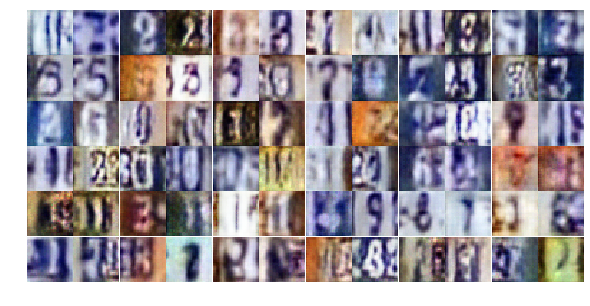

Epoch 7/25... Discriminator Loss: 0.8715... Generator Loss: 1.1316
Epoch 7/25... Discriminator Loss: 0.8785... Generator Loss: 1.6236
Epoch 7/25... Discriminator Loss: 0.5158... Generator Loss: 1.8123
Epoch 7/25... Discriminator Loss: 0.3999... Generator Loss: 2.0076
Epoch 7/25... Discriminator Loss: 0.7740... Generator Loss: 0.9245
Epoch 7/25... Discriminator Loss: 0.6345... Generator Loss: 1.1402
Epoch 7/25... Discriminator Loss: 0.6925... Generator Loss: 0.9834
Epoch 7/25... Discriminator Loss: 1.0644... Generator Loss: 1.9790
Epoch 7/25... Discriminator Loss: 0.3172... Generator Loss: 2.1666
Epoch 7/25... Discriminator Loss: 0.8052... Generator Loss: 0.8749


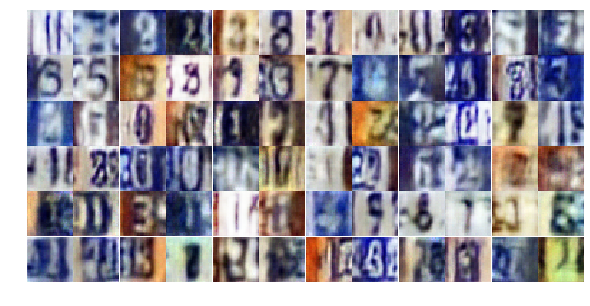

Epoch 7/25... Discriminator Loss: 0.7269... Generator Loss: 2.7872
Epoch 7/25... Discriminator Loss: 0.7808... Generator Loss: 1.4402
Epoch 7/25... Discriminator Loss: 0.8311... Generator Loss: 1.1355
Epoch 7/25... Discriminator Loss: 0.9030... Generator Loss: 0.7618
Epoch 7/25... Discriminator Loss: 0.5599... Generator Loss: 1.3067
Epoch 7/25... Discriminator Loss: 0.4763... Generator Loss: 1.5701
Epoch 7/25... Discriminator Loss: 1.3636... Generator Loss: 0.3813
Epoch 7/25... Discriminator Loss: 0.6022... Generator Loss: 1.3383
Epoch 7/25... Discriminator Loss: 0.8965... Generator Loss: 1.8620
Epoch 7/25... Discriminator Loss: 1.3205... Generator Loss: 0.4261


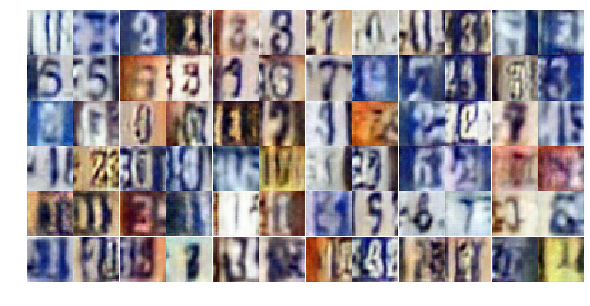

Epoch 7/25... Discriminator Loss: 0.5731... Generator Loss: 1.5637
Epoch 8/25... Discriminator Loss: 0.9012... Generator Loss: 0.6980
Epoch 8/25... Discriminator Loss: 0.9336... Generator Loss: 0.6158
Epoch 8/25... Discriminator Loss: 0.7076... Generator Loss: 1.0083
Epoch 8/25... Discriminator Loss: 0.6652... Generator Loss: 1.3000
Epoch 8/25... Discriminator Loss: 0.8382... Generator Loss: 1.4743
Epoch 8/25... Discriminator Loss: 0.7127... Generator Loss: 0.9639
Epoch 8/25... Discriminator Loss: 0.5176... Generator Loss: 1.6986
Epoch 8/25... Discriminator Loss: 0.7294... Generator Loss: 0.9263
Epoch 8/25... Discriminator Loss: 0.6802... Generator Loss: 0.9191


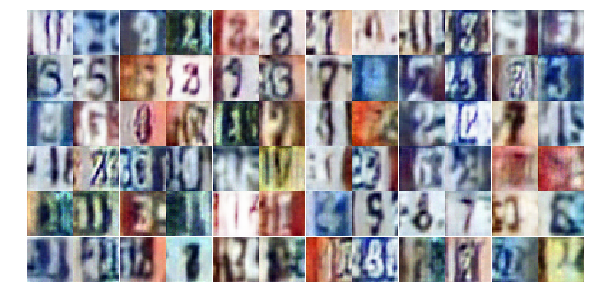

Epoch 8/25... Discriminator Loss: 0.7827... Generator Loss: 3.3108
Epoch 8/25... Discriminator Loss: 0.4969... Generator Loss: 1.4662
Epoch 8/25... Discriminator Loss: 0.7962... Generator Loss: 0.8804
Epoch 8/25... Discriminator Loss: 0.4325... Generator Loss: 1.9197
Epoch 8/25... Discriminator Loss: 0.9052... Generator Loss: 0.9789
Epoch 8/25... Discriminator Loss: 0.8832... Generator Loss: 1.8634
Epoch 8/25... Discriminator Loss: 0.6045... Generator Loss: 1.4109
Epoch 8/25... Discriminator Loss: 0.8176... Generator Loss: 0.8587
Epoch 8/25... Discriminator Loss: 0.8445... Generator Loss: 0.7915
Epoch 8/25... Discriminator Loss: 1.5628... Generator Loss: 0.3214


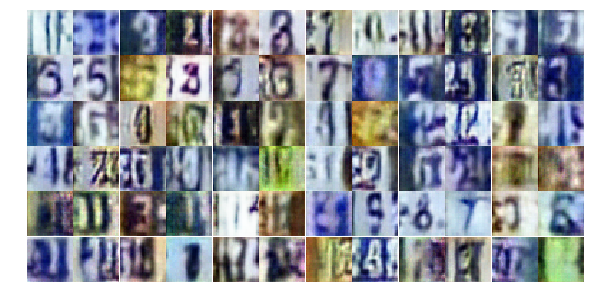

Epoch 8/25... Discriminator Loss: 0.4162... Generator Loss: 2.1498
Epoch 8/25... Discriminator Loss: 0.6400... Generator Loss: 1.0357
Epoch 8/25... Discriminator Loss: 0.7403... Generator Loss: 1.1404
Epoch 8/25... Discriminator Loss: 0.7139... Generator Loss: 1.1341
Epoch 8/25... Discriminator Loss: 0.4518... Generator Loss: 1.6269
Epoch 8/25... Discriminator Loss: 0.5935... Generator Loss: 1.1154
Epoch 8/25... Discriminator Loss: 0.6609... Generator Loss: 1.3343
Epoch 8/25... Discriminator Loss: 0.4386... Generator Loss: 1.5283
Epoch 8/25... Discriminator Loss: 0.5999... Generator Loss: 1.2875
Epoch 8/25... Discriminator Loss: 0.7071... Generator Loss: 0.9629


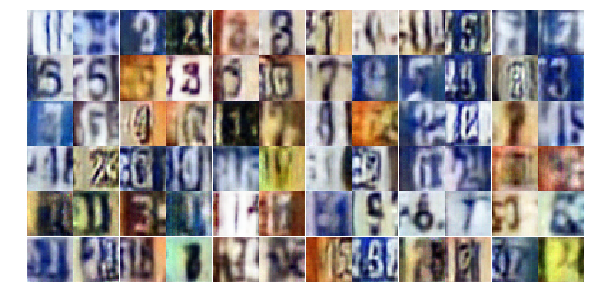

Epoch 8/25... Discriminator Loss: 0.7474... Generator Loss: 2.0612
Epoch 8/25... Discriminator Loss: 1.0256... Generator Loss: 0.6310
Epoch 8/25... Discriminator Loss: 0.8560... Generator Loss: 0.8420
Epoch 8/25... Discriminator Loss: 0.7698... Generator Loss: 0.9497
Epoch 8/25... Discriminator Loss: 0.5686... Generator Loss: 1.1868
Epoch 8/25... Discriminator Loss: 0.5151... Generator Loss: 1.2831
Epoch 8/25... Discriminator Loss: 0.5404... Generator Loss: 1.4549
Epoch 8/25... Discriminator Loss: 0.3051... Generator Loss: 2.1282
Epoch 8/25... Discriminator Loss: 0.4820... Generator Loss: 1.4787
Epoch 8/25... Discriminator Loss: 0.5499... Generator Loss: 1.2271


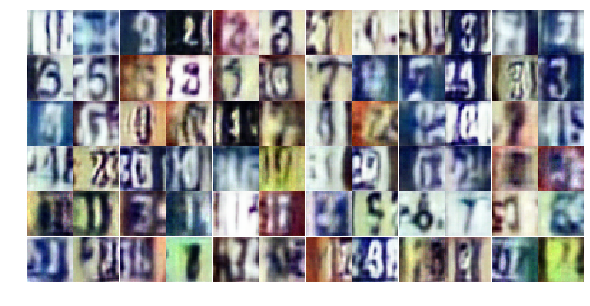

Epoch 8/25... Discriminator Loss: 0.5433... Generator Loss: 1.7742
Epoch 8/25... Discriminator Loss: 0.9691... Generator Loss: 0.6744
Epoch 8/25... Discriminator Loss: 0.8057... Generator Loss: 0.8072
Epoch 8/25... Discriminator Loss: 0.6416... Generator Loss: 1.2325
Epoch 8/25... Discriminator Loss: 1.3280... Generator Loss: 2.8134
Epoch 8/25... Discriminator Loss: 0.6788... Generator Loss: 0.9758
Epoch 8/25... Discriminator Loss: 0.3159... Generator Loss: 1.9021
Epoch 8/25... Discriminator Loss: 1.3492... Generator Loss: 0.6070
Epoch 8/25... Discriminator Loss: 1.0114... Generator Loss: 0.9742
Epoch 8/25... Discriminator Loss: 1.3715... Generator Loss: 0.4279


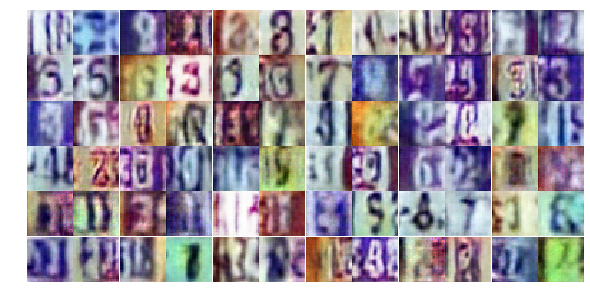

Epoch 8/25... Discriminator Loss: 0.7205... Generator Loss: 1.4298
Epoch 8/25... Discriminator Loss: 0.6796... Generator Loss: 1.0679
Epoch 8/25... Discriminator Loss: 0.5789... Generator Loss: 1.3915
Epoch 8/25... Discriminator Loss: 0.7917... Generator Loss: 0.8272
Epoch 8/25... Discriminator Loss: 0.6548... Generator Loss: 2.1579
Epoch 8/25... Discriminator Loss: 1.0086... Generator Loss: 0.6631
Epoch 8/25... Discriminator Loss: 0.5834... Generator Loss: 1.0937
Epoch 8/25... Discriminator Loss: 0.6433... Generator Loss: 1.6978
Epoch 9/25... Discriminator Loss: 1.1023... Generator Loss: 0.5821
Epoch 9/25... Discriminator Loss: 0.9603... Generator Loss: 0.6793


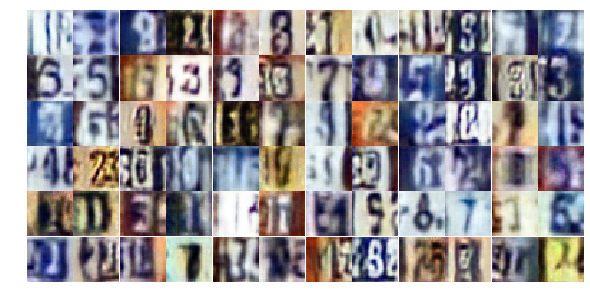

Epoch 9/25... Discriminator Loss: 0.8798... Generator Loss: 0.8208
Epoch 9/25... Discriminator Loss: 0.6480... Generator Loss: 1.0278
Epoch 9/25... Discriminator Loss: 0.9998... Generator Loss: 0.9422
Epoch 9/25... Discriminator Loss: 0.4640... Generator Loss: 1.3435
Epoch 9/25... Discriminator Loss: 0.9316... Generator Loss: 0.6828
Epoch 9/25... Discriminator Loss: 0.8992... Generator Loss: 2.8740
Epoch 9/25... Discriminator Loss: 0.6134... Generator Loss: 1.3510
Epoch 9/25... Discriminator Loss: 0.5255... Generator Loss: 1.3150
Epoch 9/25... Discriminator Loss: 0.8320... Generator Loss: 0.7837
Epoch 9/25... Discriminator Loss: 0.6639... Generator Loss: 1.8407


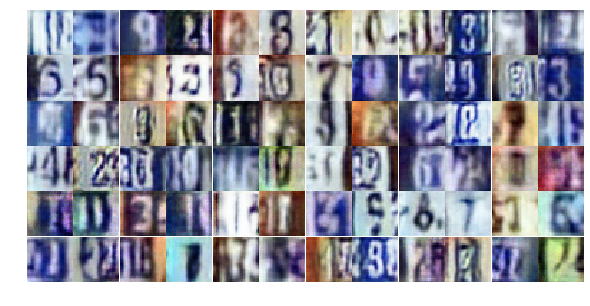

Epoch 9/25... Discriminator Loss: 1.2186... Generator Loss: 0.4747
Epoch 9/25... Discriminator Loss: 1.8175... Generator Loss: 1.8524
Epoch 9/25... Discriminator Loss: 0.7040... Generator Loss: 1.2595
Epoch 9/25... Discriminator Loss: 1.1104... Generator Loss: 0.6416
Epoch 9/25... Discriminator Loss: 0.5115... Generator Loss: 1.3174
Epoch 9/25... Discriminator Loss: 0.8070... Generator Loss: 1.0253
Epoch 9/25... Discriminator Loss: 1.0384... Generator Loss: 0.5869
Epoch 9/25... Discriminator Loss: 0.4986... Generator Loss: 2.2236
Epoch 9/25... Discriminator Loss: 1.2909... Generator Loss: 0.4569
Epoch 9/25... Discriminator Loss: 0.9154... Generator Loss: 0.7112


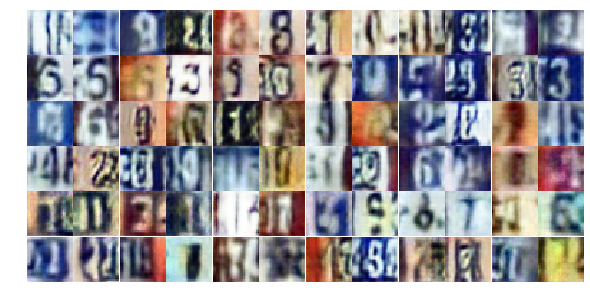

Epoch 9/25... Discriminator Loss: 0.9698... Generator Loss: 0.7624
Epoch 9/25... Discriminator Loss: 0.5830... Generator Loss: 1.2107
Epoch 9/25... Discriminator Loss: 0.6502... Generator Loss: 1.2630
Epoch 9/25... Discriminator Loss: 0.5614... Generator Loss: 1.2772
Epoch 9/25... Discriminator Loss: 0.4892... Generator Loss: 1.6955
Epoch 9/25... Discriminator Loss: 0.5470... Generator Loss: 1.2312
Epoch 9/25... Discriminator Loss: 0.9066... Generator Loss: 0.8488
Epoch 9/25... Discriminator Loss: 0.5855... Generator Loss: 1.2584
Epoch 9/25... Discriminator Loss: 0.5055... Generator Loss: 1.5069
Epoch 9/25... Discriminator Loss: 0.4287... Generator Loss: 1.6013


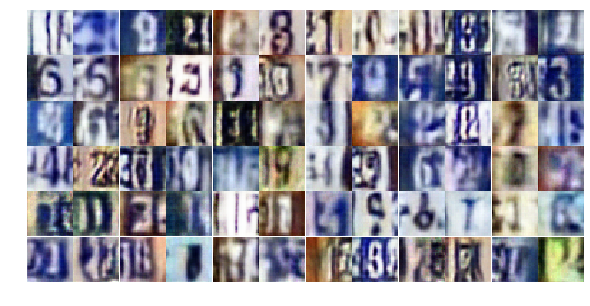

Epoch 9/25... Discriminator Loss: 0.5669... Generator Loss: 1.2191
Epoch 9/25... Discriminator Loss: 0.4590... Generator Loss: 1.4031
Epoch 9/25... Discriminator Loss: 1.8027... Generator Loss: 0.3436
Epoch 9/25... Discriminator Loss: 0.6757... Generator Loss: 1.0546
Epoch 9/25... Discriminator Loss: 0.6516... Generator Loss: 1.1243
Epoch 9/25... Discriminator Loss: 0.5501... Generator Loss: 1.4101
Epoch 9/25... Discriminator Loss: 1.0214... Generator Loss: 2.9840
Epoch 9/25... Discriminator Loss: 0.5628... Generator Loss: 2.0113
Epoch 9/25... Discriminator Loss: 1.4213... Generator Loss: 0.4021
Epoch 9/25... Discriminator Loss: 0.7669... Generator Loss: 0.9283


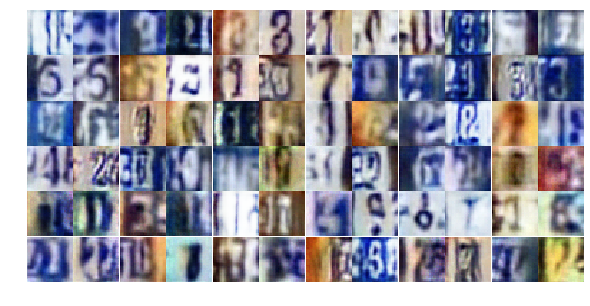

Epoch 9/25... Discriminator Loss: 0.4333... Generator Loss: 1.6421
Epoch 9/25... Discriminator Loss: 0.5488... Generator Loss: 1.6670
Epoch 9/25... Discriminator Loss: 0.5404... Generator Loss: 1.3466
Epoch 9/25... Discriminator Loss: 0.6679... Generator Loss: 1.3367
Epoch 9/25... Discriminator Loss: 0.4049... Generator Loss: 1.8905
Epoch 9/25... Discriminator Loss: 0.9453... Generator Loss: 0.6521
Epoch 9/25... Discriminator Loss: 0.7423... Generator Loss: 0.9115
Epoch 9/25... Discriminator Loss: 1.0514... Generator Loss: 0.6216
Epoch 9/25... Discriminator Loss: 0.5401... Generator Loss: 1.8363
Epoch 9/25... Discriminator Loss: 0.8800... Generator Loss: 3.2473


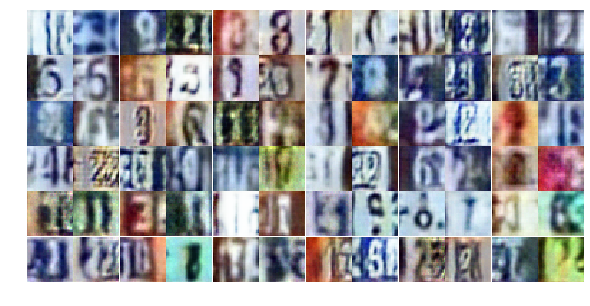

Epoch 9/25... Discriminator Loss: 1.1069... Generator Loss: 0.7198
Epoch 9/25... Discriminator Loss: 2.2134... Generator Loss: 4.4663
Epoch 9/25... Discriminator Loss: 0.6732... Generator Loss: 1.0844
Epoch 9/25... Discriminator Loss: 0.8627... Generator Loss: 0.8658
Epoch 9/25... Discriminator Loss: 0.8896... Generator Loss: 0.7624
Epoch 10/25... Discriminator Loss: 0.6353... Generator Loss: 1.0779
Epoch 10/25... Discriminator Loss: 0.4724... Generator Loss: 1.8472
Epoch 10/25... Discriminator Loss: 0.6845... Generator Loss: 0.9851
Epoch 10/25... Discriminator Loss: 0.9000... Generator Loss: 2.0764
Epoch 10/25... Discriminator Loss: 1.6663... Generator Loss: 0.2864


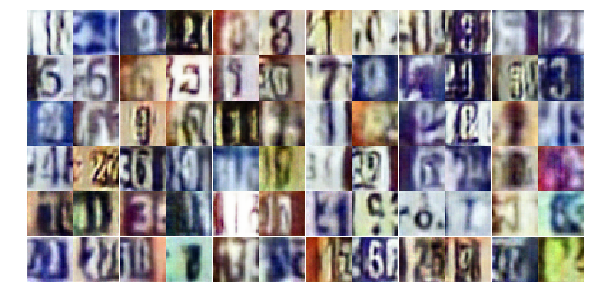

Epoch 10/25... Discriminator Loss: 1.4136... Generator Loss: 0.4100
Epoch 10/25... Discriminator Loss: 0.4748... Generator Loss: 1.4542
Epoch 10/25... Discriminator Loss: 0.8227... Generator Loss: 0.8182
Epoch 10/25... Discriminator Loss: 0.4544... Generator Loss: 1.6903
Epoch 10/25... Discriminator Loss: 0.8209... Generator Loss: 2.5905
Epoch 10/25... Discriminator Loss: 0.6718... Generator Loss: 1.0487
Epoch 10/25... Discriminator Loss: 0.5046... Generator Loss: 1.3461
Epoch 10/25... Discriminator Loss: 1.5365... Generator Loss: 0.3162
Epoch 10/25... Discriminator Loss: 1.0998... Generator Loss: 0.5541
Epoch 10/25... Discriminator Loss: 1.0092... Generator Loss: 0.6481


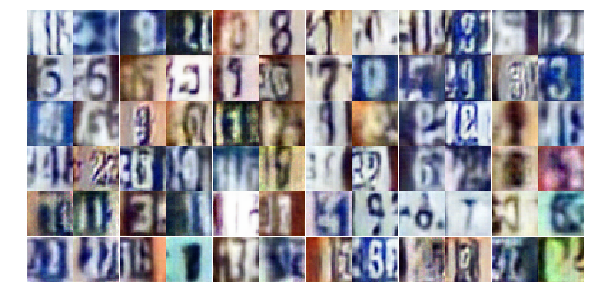

Epoch 10/25... Discriminator Loss: 0.9200... Generator Loss: 1.0877
Epoch 10/25... Discriminator Loss: 0.7238... Generator Loss: 1.0644
Epoch 10/25... Discriminator Loss: 0.7727... Generator Loss: 0.8806
Epoch 10/25... Discriminator Loss: 1.0271... Generator Loss: 0.6461
Epoch 10/25... Discriminator Loss: 0.5176... Generator Loss: 1.5771
Epoch 10/25... Discriminator Loss: 0.6487... Generator Loss: 1.0548
Epoch 10/25... Discriminator Loss: 0.6585... Generator Loss: 1.1561
Epoch 10/25... Discriminator Loss: 0.5619... Generator Loss: 1.2361
Epoch 10/25... Discriminator Loss: 0.6654... Generator Loss: 1.2421
Epoch 10/25... Discriminator Loss: 0.3664... Generator Loss: 2.0285


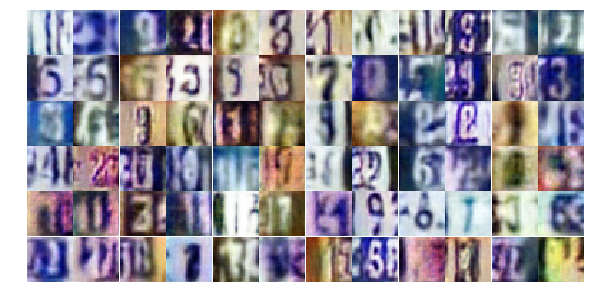

Epoch 10/25... Discriminator Loss: 1.0021... Generator Loss: 0.6049
Epoch 10/25... Discriminator Loss: 1.3956... Generator Loss: 0.4871
Epoch 10/25... Discriminator Loss: 0.4661... Generator Loss: 2.6926
Epoch 10/25... Discriminator Loss: 4.2671... Generator Loss: 5.2744
Epoch 10/25... Discriminator Loss: 1.4825... Generator Loss: 0.3847
Epoch 10/25... Discriminator Loss: 0.8015... Generator Loss: 0.9635
Epoch 10/25... Discriminator Loss: 0.4669... Generator Loss: 1.6361
Epoch 10/25... Discriminator Loss: 1.1521... Generator Loss: 0.5334
Epoch 10/25... Discriminator Loss: 0.7207... Generator Loss: 0.9126
Epoch 10/25... Discriminator Loss: 0.7248... Generator Loss: 0.8714


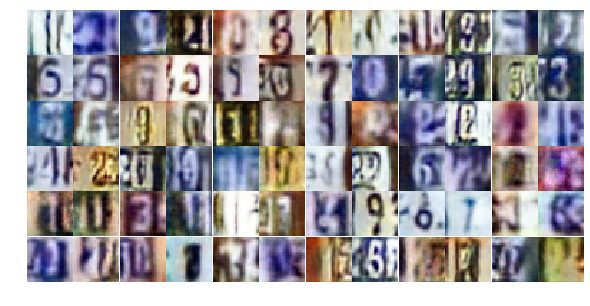

Epoch 10/25... Discriminator Loss: 0.5433... Generator Loss: 1.6533
Epoch 10/25... Discriminator Loss: 0.7468... Generator Loss: 0.9308
Epoch 10/25... Discriminator Loss: 0.5271... Generator Loss: 1.5280
Epoch 10/25... Discriminator Loss: 0.5168... Generator Loss: 1.7060
Epoch 10/25... Discriminator Loss: 0.5716... Generator Loss: 1.2271
Epoch 10/25... Discriminator Loss: 0.7083... Generator Loss: 0.9138
Epoch 10/25... Discriminator Loss: 0.7939... Generator Loss: 0.8740
Epoch 10/25... Discriminator Loss: 0.7920... Generator Loss: 0.8322
Epoch 10/25... Discriminator Loss: 0.6574... Generator Loss: 1.7050
Epoch 10/25... Discriminator Loss: 0.5531... Generator Loss: 1.6994


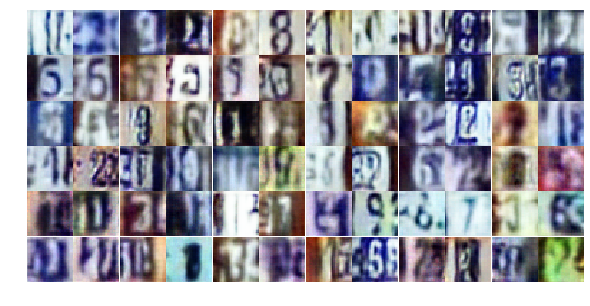

Epoch 10/25... Discriminator Loss: 1.3808... Generator Loss: 0.4733
Epoch 10/25... Discriminator Loss: 0.8275... Generator Loss: 1.2185
Epoch 10/25... Discriminator Loss: 0.6311... Generator Loss: 1.2554
Epoch 10/25... Discriminator Loss: 0.7768... Generator Loss: 0.8825
Epoch 10/25... Discriminator Loss: 0.5584... Generator Loss: 1.7196
Epoch 10/25... Discriminator Loss: 0.5680... Generator Loss: 1.4339
Epoch 10/25... Discriminator Loss: 0.5115... Generator Loss: 1.4199
Epoch 10/25... Discriminator Loss: 1.1666... Generator Loss: 3.5717
Epoch 10/25... Discriminator Loss: 0.7726... Generator Loss: 2.0569
Epoch 10/25... Discriminator Loss: 0.5021... Generator Loss: 1.5943


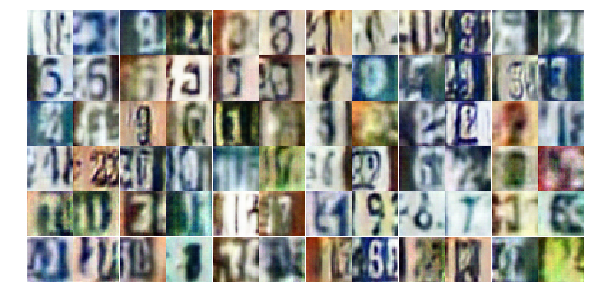

Epoch 10/25... Discriminator Loss: 0.9966... Generator Loss: 1.9000
Epoch 10/25... Discriminator Loss: 0.4707... Generator Loss: 1.5118
Epoch 10/25... Discriminator Loss: 1.0479... Generator Loss: 0.6010
Epoch 11/25... Discriminator Loss: 0.8567... Generator Loss: 0.8081
Epoch 11/25... Discriminator Loss: 0.6142... Generator Loss: 1.2272
Epoch 11/25... Discriminator Loss: 1.4495... Generator Loss: 0.3797
Epoch 11/25... Discriminator Loss: 1.0772... Generator Loss: 0.5434
Epoch 11/25... Discriminator Loss: 0.5952... Generator Loss: 2.5212
Epoch 11/25... Discriminator Loss: 1.3739... Generator Loss: 0.4707
Epoch 11/25... Discriminator Loss: 0.5869... Generator Loss: 2.0068


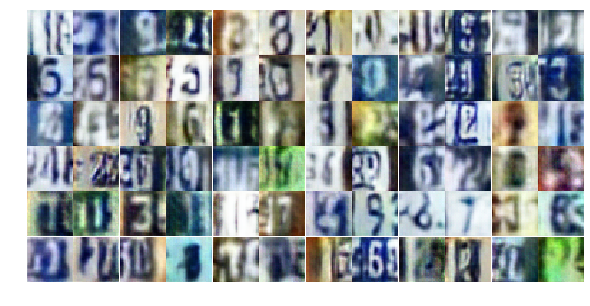

Epoch 11/25... Discriminator Loss: 0.4200... Generator Loss: 1.6822
Epoch 11/25... Discriminator Loss: 0.5882... Generator Loss: 1.5844
Epoch 11/25... Discriminator Loss: 0.5280... Generator Loss: 1.2942
Epoch 11/25... Discriminator Loss: 0.5176... Generator Loss: 1.3890
Epoch 11/25... Discriminator Loss: 0.7694... Generator Loss: 0.8617
Epoch 11/25... Discriminator Loss: 0.4134... Generator Loss: 1.7892
Epoch 11/25... Discriminator Loss: 0.6693... Generator Loss: 1.1716
Epoch 11/25... Discriminator Loss: 0.3673... Generator Loss: 1.9942
Epoch 11/25... Discriminator Loss: 1.0555... Generator Loss: 0.5680
Epoch 11/25... Discriminator Loss: 1.4413... Generator Loss: 0.4033


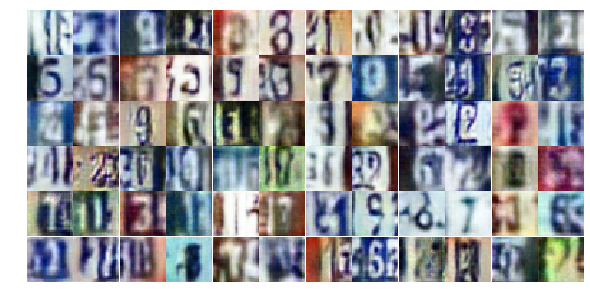

Epoch 11/25... Discriminator Loss: 0.5214... Generator Loss: 1.4088
Epoch 11/25... Discriminator Loss: 0.3976... Generator Loss: 2.2241
Epoch 11/25... Discriminator Loss: 1.5455... Generator Loss: 0.3549
Epoch 11/25... Discriminator Loss: 0.6551... Generator Loss: 1.0853
Epoch 11/25... Discriminator Loss: 0.4783... Generator Loss: 1.9146
Epoch 11/25... Discriminator Loss: 0.4883... Generator Loss: 1.6143
Epoch 11/25... Discriminator Loss: 0.4354... Generator Loss: 1.4626
Epoch 11/25... Discriminator Loss: 1.0319... Generator Loss: 0.6148
Epoch 11/25... Discriminator Loss: 0.2999... Generator Loss: 1.8413
Epoch 11/25... Discriminator Loss: 0.6713... Generator Loss: 1.0040


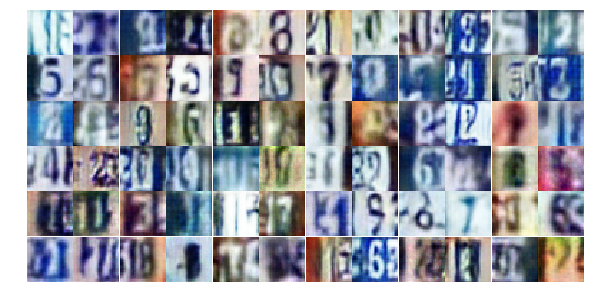

Epoch 11/25... Discriminator Loss: 1.6631... Generator Loss: 0.3176
Epoch 11/25... Discriminator Loss: 0.7854... Generator Loss: 1.6342
Epoch 11/25... Discriminator Loss: 1.0979... Generator Loss: 0.6672
Epoch 11/25... Discriminator Loss: 0.3974... Generator Loss: 1.5559
Epoch 11/25... Discriminator Loss: 0.9618... Generator Loss: 0.6663
Epoch 11/25... Discriminator Loss: 0.7946... Generator Loss: 0.8735
Epoch 11/25... Discriminator Loss: 0.9960... Generator Loss: 0.6774
Epoch 11/25... Discriminator Loss: 0.8882... Generator Loss: 0.7186
Epoch 11/25... Discriminator Loss: 0.4933... Generator Loss: 1.3210
Epoch 11/25... Discriminator Loss: 1.0311... Generator Loss: 0.5967


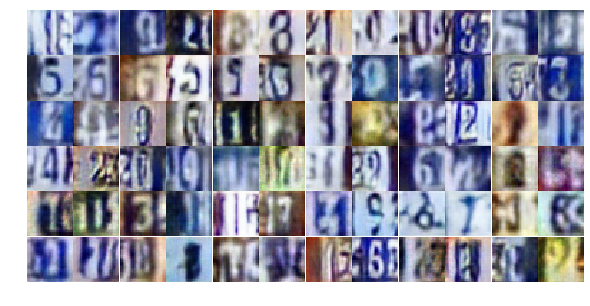

Epoch 11/25... Discriminator Loss: 0.4649... Generator Loss: 1.4911
Epoch 11/25... Discriminator Loss: 0.5049... Generator Loss: 1.2493
Epoch 11/25... Discriminator Loss: 0.9597... Generator Loss: 0.6583
Epoch 11/25... Discriminator Loss: 0.8446... Generator Loss: 0.8168
Epoch 11/25... Discriminator Loss: 0.7072... Generator Loss: 0.8779
Epoch 11/25... Discriminator Loss: 0.7763... Generator Loss: 0.7986
Epoch 11/25... Discriminator Loss: 0.3344... Generator Loss: 2.0159
Epoch 11/25... Discriminator Loss: 0.6733... Generator Loss: 1.6274
Epoch 11/25... Discriminator Loss: 1.3408... Generator Loss: 0.4273
Epoch 11/25... Discriminator Loss: 0.7061... Generator Loss: 0.9397


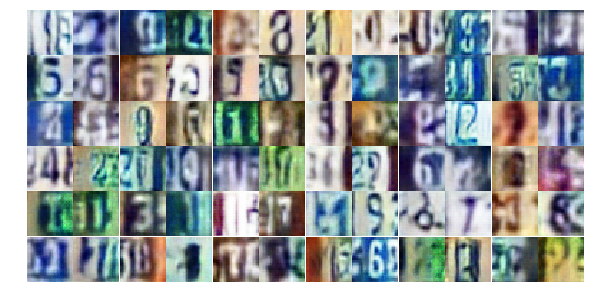

Epoch 11/25... Discriminator Loss: 0.7254... Generator Loss: 1.6833
Epoch 11/25... Discriminator Loss: 0.4067... Generator Loss: 1.6655
Epoch 11/25... Discriminator Loss: 0.6845... Generator Loss: 1.0786
Epoch 11/25... Discriminator Loss: 0.7643... Generator Loss: 0.8444
Epoch 11/25... Discriminator Loss: 1.0399... Generator Loss: 0.8049
Epoch 11/25... Discriminator Loss: 0.7198... Generator Loss: 0.9236
Epoch 11/25... Discriminator Loss: 1.3634... Generator Loss: 0.4093
Epoch 11/25... Discriminator Loss: 0.5606... Generator Loss: 2.1758
Epoch 11/25... Discriminator Loss: 1.2500... Generator Loss: 0.5006
Epoch 11/25... Discriminator Loss: 0.6952... Generator Loss: 1.0404


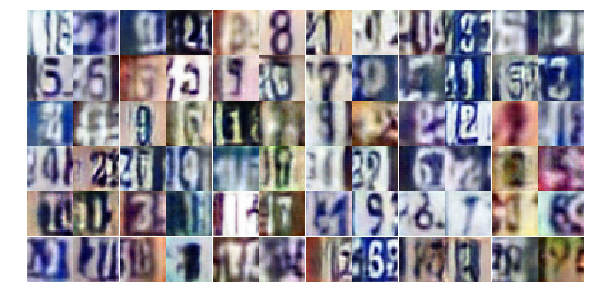

Epoch 12/25... Discriminator Loss: 0.6257... Generator Loss: 1.3646
Epoch 12/25... Discriminator Loss: 0.8353... Generator Loss: 1.6080
Epoch 12/25... Discriminator Loss: 0.7432... Generator Loss: 1.0313
Epoch 12/25... Discriminator Loss: 0.6264... Generator Loss: 1.2939
Epoch 12/25... Discriminator Loss: 0.5210... Generator Loss: 1.3880
Epoch 12/25... Discriminator Loss: 1.1573... Generator Loss: 0.4673
Epoch 12/25... Discriminator Loss: 0.6707... Generator Loss: 1.7051
Epoch 12/25... Discriminator Loss: 0.5258... Generator Loss: 1.5027
Epoch 12/25... Discriminator Loss: 0.7043... Generator Loss: 2.1835
Epoch 12/25... Discriminator Loss: 1.5679... Generator Loss: 0.3491


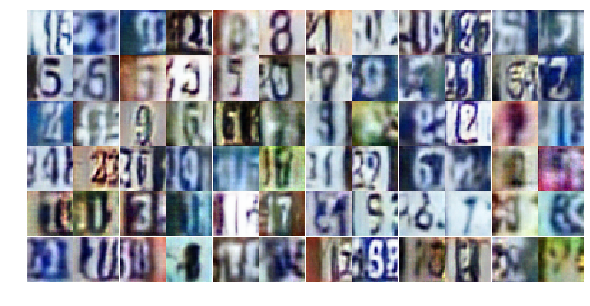

Epoch 12/25... Discriminator Loss: 0.5618... Generator Loss: 1.1690
Epoch 12/25... Discriminator Loss: 1.1159... Generator Loss: 0.5476
Epoch 12/25... Discriminator Loss: 0.6568... Generator Loss: 2.5662
Epoch 12/25... Discriminator Loss: 2.1982... Generator Loss: 3.6740
Epoch 12/25... Discriminator Loss: 0.6219... Generator Loss: 1.2072
Epoch 12/25... Discriminator Loss: 0.8798... Generator Loss: 1.1122
Epoch 12/25... Discriminator Loss: 1.4901... Generator Loss: 0.3361
Epoch 12/25... Discriminator Loss: 0.5288... Generator Loss: 1.6298
Epoch 12/25... Discriminator Loss: 0.7390... Generator Loss: 0.9984
Epoch 12/25... Discriminator Loss: 0.8538... Generator Loss: 0.7789


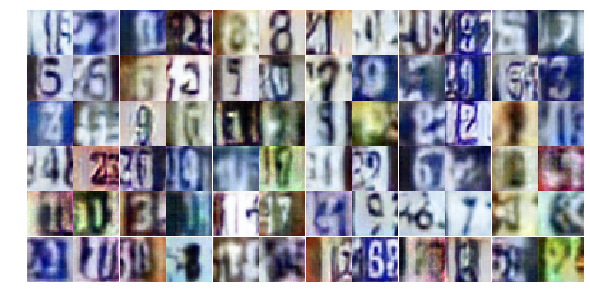

Epoch 12/25... Discriminator Loss: 0.3691... Generator Loss: 1.6216
Epoch 12/25... Discriminator Loss: 0.4596... Generator Loss: 1.4695
Epoch 12/25... Discriminator Loss: 1.2364... Generator Loss: 0.5645
Epoch 12/25... Discriminator Loss: 0.4129... Generator Loss: 1.5651
Epoch 12/25... Discriminator Loss: 0.4851... Generator Loss: 1.4936
Epoch 12/25... Discriminator Loss: 0.7764... Generator Loss: 1.3810
Epoch 12/25... Discriminator Loss: 0.9996... Generator Loss: 0.5895
Epoch 12/25... Discriminator Loss: 0.4378... Generator Loss: 1.7040
Epoch 12/25... Discriminator Loss: 0.6167... Generator Loss: 1.1494
Epoch 12/25... Discriminator Loss: 0.5499... Generator Loss: 1.4234


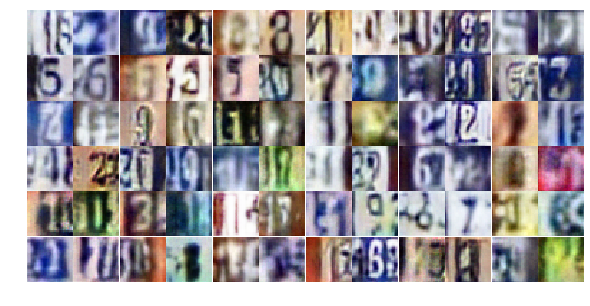

Epoch 12/25... Discriminator Loss: 0.6015... Generator Loss: 1.1212
Epoch 12/25... Discriminator Loss: 0.7786... Generator Loss: 0.9288
Epoch 12/25... Discriminator Loss: 0.8200... Generator Loss: 0.8344
Epoch 12/25... Discriminator Loss: 1.5940... Generator Loss: 0.2918
Epoch 12/25... Discriminator Loss: 1.7237... Generator Loss: 4.0288
Epoch 12/25... Discriminator Loss: 1.0390... Generator Loss: 0.6523
Epoch 12/25... Discriminator Loss: 0.6745... Generator Loss: 1.0909
Epoch 12/25... Discriminator Loss: 0.8151... Generator Loss: 1.0203
Epoch 12/25... Discriminator Loss: 0.5898... Generator Loss: 1.3787
Epoch 12/25... Discriminator Loss: 0.4022... Generator Loss: 1.5088


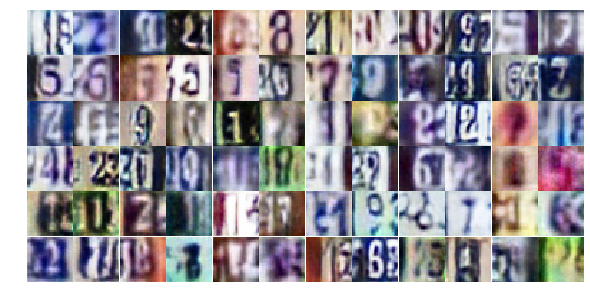

Epoch 12/25... Discriminator Loss: 0.8090... Generator Loss: 0.8273
Epoch 12/25... Discriminator Loss: 0.6271... Generator Loss: 2.1569
Epoch 12/25... Discriminator Loss: 0.5123... Generator Loss: 1.1770
Epoch 12/25... Discriminator Loss: 0.7617... Generator Loss: 1.2542
Epoch 12/25... Discriminator Loss: 1.3884... Generator Loss: 0.4196
Epoch 12/25... Discriminator Loss: 2.6678... Generator Loss: 0.1898
Epoch 12/25... Discriminator Loss: 0.6572... Generator Loss: 1.1872
Epoch 12/25... Discriminator Loss: 1.1677... Generator Loss: 0.5577
Epoch 12/25... Discriminator Loss: 0.5731... Generator Loss: 1.8601
Epoch 12/25... Discriminator Loss: 0.8064... Generator Loss: 0.8434


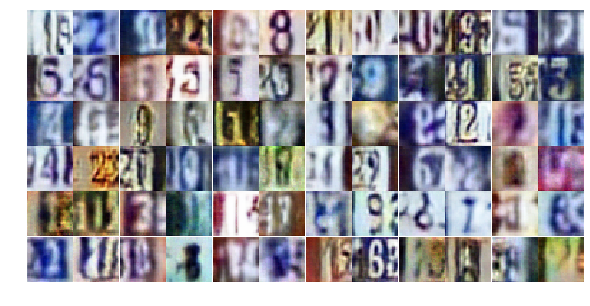

Epoch 12/25... Discriminator Loss: 0.8242... Generator Loss: 0.8903
Epoch 12/25... Discriminator Loss: 0.7357... Generator Loss: 1.1206
Epoch 12/25... Discriminator Loss: 0.4991... Generator Loss: 1.4223
Epoch 12/25... Discriminator Loss: 1.0376... Generator Loss: 0.6222
Epoch 12/25... Discriminator Loss: 0.6139... Generator Loss: 1.2559
Epoch 12/25... Discriminator Loss: 0.6653... Generator Loss: 2.1259
Epoch 12/25... Discriminator Loss: 1.1514... Generator Loss: 0.5462
Epoch 13/25... Discriminator Loss: 0.6060... Generator Loss: 1.2355
Epoch 13/25... Discriminator Loss: 0.5420... Generator Loss: 1.3223
Epoch 13/25... Discriminator Loss: 1.0260... Generator Loss: 0.6095


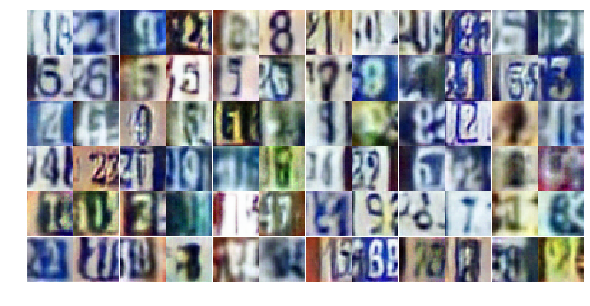

Epoch 13/25... Discriminator Loss: 0.6702... Generator Loss: 1.6610
Epoch 13/25... Discriminator Loss: 0.6357... Generator Loss: 1.5425
Epoch 13/25... Discriminator Loss: 0.8054... Generator Loss: 0.9079
Epoch 13/25... Discriminator Loss: 2.1958... Generator Loss: 0.2608
Epoch 13/25... Discriminator Loss: 0.6699... Generator Loss: 1.4898
Epoch 13/25... Discriminator Loss: 0.5953... Generator Loss: 1.1959
Epoch 13/25... Discriminator Loss: 0.5150... Generator Loss: 1.9320
Epoch 13/25... Discriminator Loss: 0.9720... Generator Loss: 0.6092
Epoch 13/25... Discriminator Loss: 0.7564... Generator Loss: 0.8740
Epoch 13/25... Discriminator Loss: 0.6189... Generator Loss: 1.1784


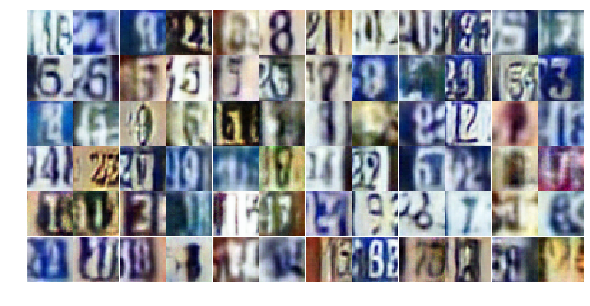

Epoch 13/25... Discriminator Loss: 0.9095... Generator Loss: 0.6896
Epoch 13/25... Discriminator Loss: 0.5021... Generator Loss: 1.3677
Epoch 13/25... Discriminator Loss: 1.0010... Generator Loss: 0.6955
Epoch 13/25... Discriminator Loss: 0.7454... Generator Loss: 1.0124
Epoch 13/25... Discriminator Loss: 0.6162... Generator Loss: 1.0978
Epoch 13/25... Discriminator Loss: 0.8318... Generator Loss: 0.8122
Epoch 13/25... Discriminator Loss: 0.6728... Generator Loss: 1.1071
Epoch 13/25... Discriminator Loss: 1.1028... Generator Loss: 0.5200
Epoch 13/25... Discriminator Loss: 0.7485... Generator Loss: 0.9533
Epoch 13/25... Discriminator Loss: 1.0006... Generator Loss: 0.6024


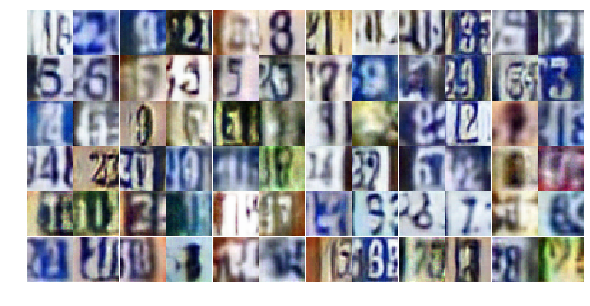

Epoch 13/25... Discriminator Loss: 0.7431... Generator Loss: 0.9072
Epoch 13/25... Discriminator Loss: 0.7044... Generator Loss: 0.9996
Epoch 13/25... Discriminator Loss: 0.8555... Generator Loss: 2.1291
Epoch 13/25... Discriminator Loss: 0.6981... Generator Loss: 0.9788
Epoch 13/25... Discriminator Loss: 0.8268... Generator Loss: 0.9317
Epoch 13/25... Discriminator Loss: 0.6634... Generator Loss: 1.0909
Epoch 13/25... Discriminator Loss: 0.8010... Generator Loss: 0.9524
Epoch 13/25... Discriminator Loss: 0.6273... Generator Loss: 1.0379
Epoch 13/25... Discriminator Loss: 0.7865... Generator Loss: 0.8784
Epoch 13/25... Discriminator Loss: 0.4638... Generator Loss: 1.8040


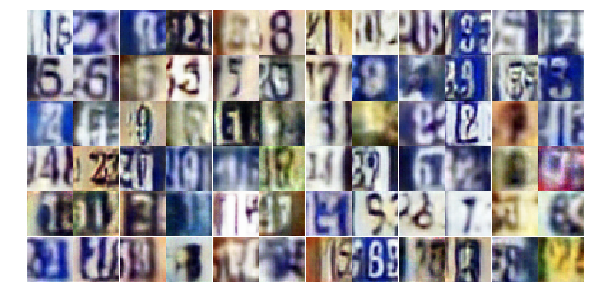

Epoch 13/25... Discriminator Loss: 0.9885... Generator Loss: 0.7097
Epoch 13/25... Discriminator Loss: 0.9105... Generator Loss: 2.0340
Epoch 13/25... Discriminator Loss: 1.3816... Generator Loss: 0.4043
Epoch 13/25... Discriminator Loss: 0.9479... Generator Loss: 0.6496
Epoch 13/25... Discriminator Loss: 0.4773... Generator Loss: 1.3400
Epoch 13/25... Discriminator Loss: 0.6781... Generator Loss: 0.9907
Epoch 13/25... Discriminator Loss: 0.4793... Generator Loss: 1.3981
Epoch 13/25... Discriminator Loss: 1.2297... Generator Loss: 0.5539
Epoch 13/25... Discriminator Loss: 0.7418... Generator Loss: 0.9783
Epoch 13/25... Discriminator Loss: 0.5931... Generator Loss: 1.1864


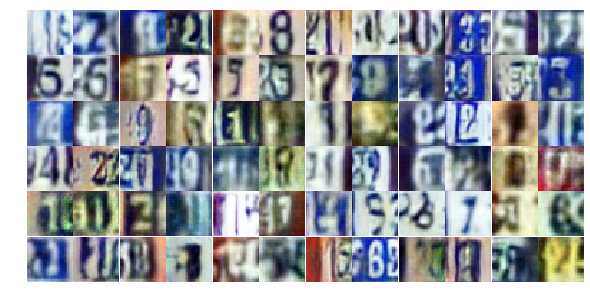

Epoch 13/25... Discriminator Loss: 0.7904... Generator Loss: 2.8380
Epoch 13/25... Discriminator Loss: 1.6769... Generator Loss: 0.3097
Epoch 13/25... Discriminator Loss: 0.7237... Generator Loss: 1.1124
Epoch 13/25... Discriminator Loss: 0.9881... Generator Loss: 0.8284
Epoch 13/25... Discriminator Loss: 1.1835... Generator Loss: 0.5817
Epoch 13/25... Discriminator Loss: 0.6506... Generator Loss: 1.4409
Epoch 13/25... Discriminator Loss: 0.6340... Generator Loss: 1.3441
Epoch 13/25... Discriminator Loss: 0.7069... Generator Loss: 1.2552
Epoch 13/25... Discriminator Loss: 1.0293... Generator Loss: 0.6198
Epoch 13/25... Discriminator Loss: 0.9416... Generator Loss: 0.6767


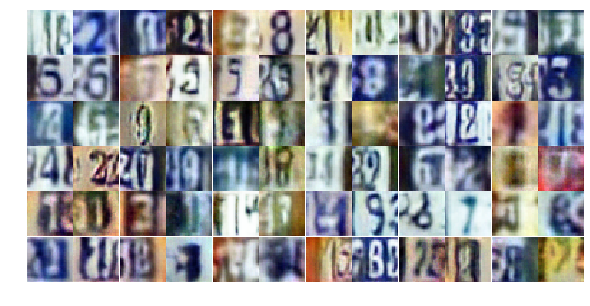

Epoch 13/25... Discriminator Loss: 0.3194... Generator Loss: 1.9036
Epoch 13/25... Discriminator Loss: 0.9338... Generator Loss: 0.6749
Epoch 13/25... Discriminator Loss: 0.3887... Generator Loss: 1.7234
Epoch 13/25... Discriminator Loss: 0.9494... Generator Loss: 0.7343
Epoch 14/25... Discriminator Loss: 0.8551... Generator Loss: 0.7687
Epoch 14/25... Discriminator Loss: 0.6225... Generator Loss: 1.2397
Epoch 14/25... Discriminator Loss: 1.1309... Generator Loss: 0.5468
Epoch 14/25... Discriminator Loss: 0.7574... Generator Loss: 3.0015
Epoch 14/25... Discriminator Loss: 0.6490... Generator Loss: 1.0407
Epoch 14/25... Discriminator Loss: 0.6595... Generator Loss: 1.2673


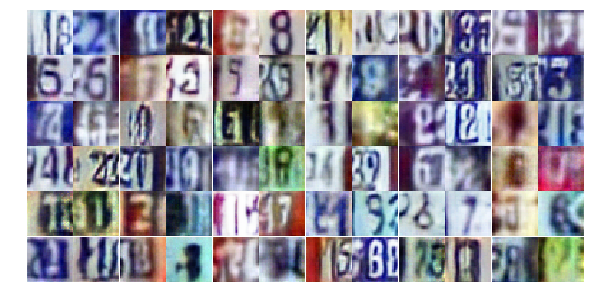

Epoch 14/25... Discriminator Loss: 0.5355... Generator Loss: 2.1542
Epoch 14/25... Discriminator Loss: 1.1382... Generator Loss: 0.5238
Epoch 14/25... Discriminator Loss: 0.7642... Generator Loss: 0.9646
Epoch 14/25... Discriminator Loss: 0.6829... Generator Loss: 1.1316
Epoch 14/25... Discriminator Loss: 1.2983... Generator Loss: 0.4375
Epoch 14/25... Discriminator Loss: 0.4784... Generator Loss: 1.3881
Epoch 14/25... Discriminator Loss: 0.5287... Generator Loss: 1.4344
Epoch 14/25... Discriminator Loss: 1.5665... Generator Loss: 0.3234
Epoch 14/25... Discriminator Loss: 0.8545... Generator Loss: 0.8919
Epoch 14/25... Discriminator Loss: 1.3940... Generator Loss: 0.3958


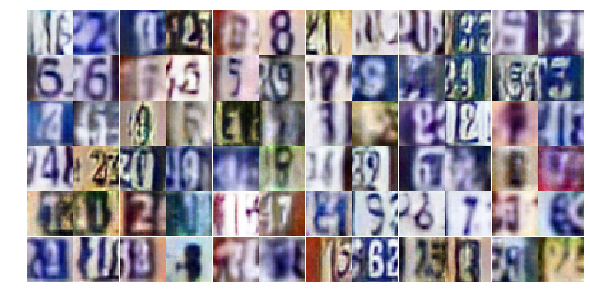

Epoch 14/25... Discriminator Loss: 0.4988... Generator Loss: 1.2055
Epoch 14/25... Discriminator Loss: 0.5420... Generator Loss: 2.4113
Epoch 14/25... Discriminator Loss: 0.9682... Generator Loss: 0.7395
Epoch 14/25... Discriminator Loss: 0.5643... Generator Loss: 1.2625
Epoch 14/25... Discriminator Loss: 0.7136... Generator Loss: 1.2308
Epoch 14/25... Discriminator Loss: 0.9567... Generator Loss: 0.7319
Epoch 14/25... Discriminator Loss: 0.6961... Generator Loss: 1.0426
Epoch 14/25... Discriminator Loss: 0.7032... Generator Loss: 0.9289
Epoch 14/25... Discriminator Loss: 0.9070... Generator Loss: 0.7611
Epoch 14/25... Discriminator Loss: 0.5402... Generator Loss: 1.5241


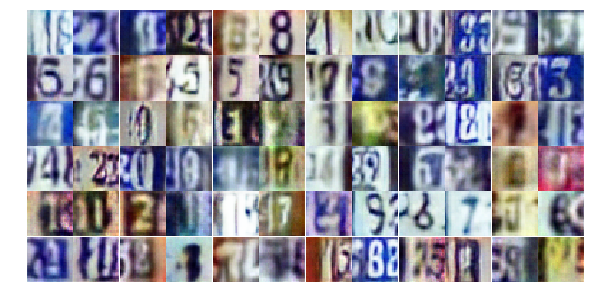

Epoch 14/25... Discriminator Loss: 1.2658... Generator Loss: 0.4537
Epoch 14/25... Discriminator Loss: 0.5380... Generator Loss: 1.3007
Epoch 14/25... Discriminator Loss: 0.4823... Generator Loss: 1.5185
Epoch 14/25... Discriminator Loss: 0.4972... Generator Loss: 1.3732
Epoch 14/25... Discriminator Loss: 0.6360... Generator Loss: 1.4472
Epoch 14/25... Discriminator Loss: 0.7358... Generator Loss: 0.9834
Epoch 14/25... Discriminator Loss: 0.6339... Generator Loss: 1.2990
Epoch 14/25... Discriminator Loss: 0.4758... Generator Loss: 1.6721
Epoch 14/25... Discriminator Loss: 0.3865... Generator Loss: 2.5452
Epoch 14/25... Discriminator Loss: 1.2676... Generator Loss: 0.4833


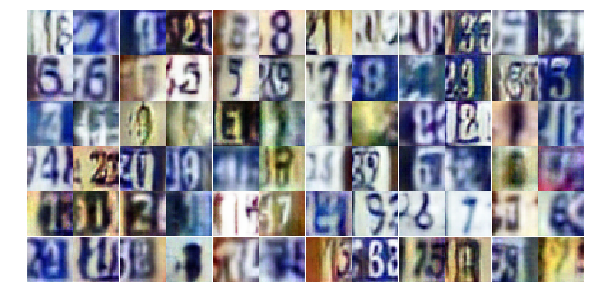

Epoch 14/25... Discriminator Loss: 1.6352... Generator Loss: 0.3549
Epoch 14/25... Discriminator Loss: 0.8149... Generator Loss: 1.3837
Epoch 14/25... Discriminator Loss: 0.7450... Generator Loss: 0.9361
Epoch 14/25... Discriminator Loss: 1.0149... Generator Loss: 0.7199
Epoch 14/25... Discriminator Loss: 1.3678... Generator Loss: 0.4396
Epoch 14/25... Discriminator Loss: 0.6813... Generator Loss: 1.1966
Epoch 14/25... Discriminator Loss: 0.6555... Generator Loss: 1.1560
Epoch 14/25... Discriminator Loss: 0.6340... Generator Loss: 1.0482
Epoch 14/25... Discriminator Loss: 1.6914... Generator Loss: 0.3073
Epoch 14/25... Discriminator Loss: 1.1898... Generator Loss: 0.5670


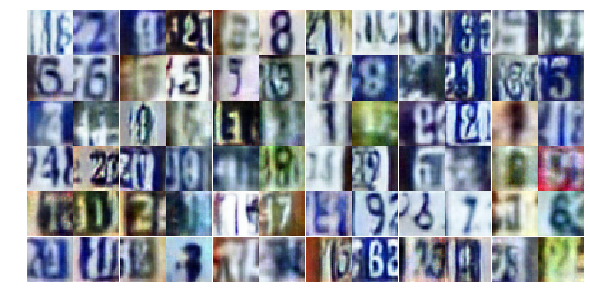

Epoch 14/25... Discriminator Loss: 0.8745... Generator Loss: 1.6178
Epoch 14/25... Discriminator Loss: 1.1318... Generator Loss: 0.5396
Epoch 14/25... Discriminator Loss: 0.5652... Generator Loss: 1.2236
Epoch 14/25... Discriminator Loss: 1.1586... Generator Loss: 0.5167
Epoch 14/25... Discriminator Loss: 0.6820... Generator Loss: 0.9694
Epoch 14/25... Discriminator Loss: 0.6831... Generator Loss: 1.0628
Epoch 14/25... Discriminator Loss: 0.6056... Generator Loss: 1.6562
Epoch 14/25... Discriminator Loss: 1.6202... Generator Loss: 0.3156
Epoch 14/25... Discriminator Loss: 1.0746... Generator Loss: 0.5811
Epoch 14/25... Discriminator Loss: 1.2740... Generator Loss: 0.4777


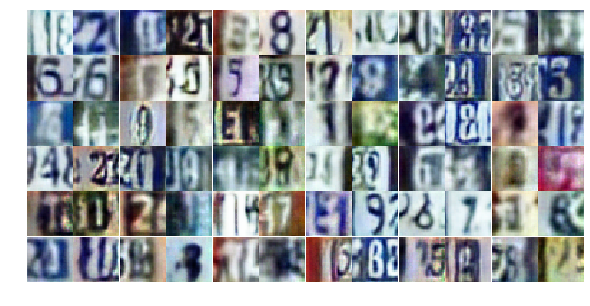

Epoch 14/25... Discriminator Loss: 0.7607... Generator Loss: 1.1514
Epoch 14/25... Discriminator Loss: 1.0425... Generator Loss: 0.6268
Epoch 15/25... Discriminator Loss: 0.5877... Generator Loss: 1.1481
Epoch 15/25... Discriminator Loss: 0.4471... Generator Loss: 1.7749
Epoch 15/25... Discriminator Loss: 0.6323... Generator Loss: 1.2326
Epoch 15/25... Discriminator Loss: 1.1118... Generator Loss: 0.5697
Epoch 15/25... Discriminator Loss: 0.8414... Generator Loss: 0.7594
Epoch 15/25... Discriminator Loss: 0.6093... Generator Loss: 1.2828
Epoch 15/25... Discriminator Loss: 1.7472... Generator Loss: 0.2570
Epoch 15/25... Discriminator Loss: 0.9649... Generator Loss: 0.7292


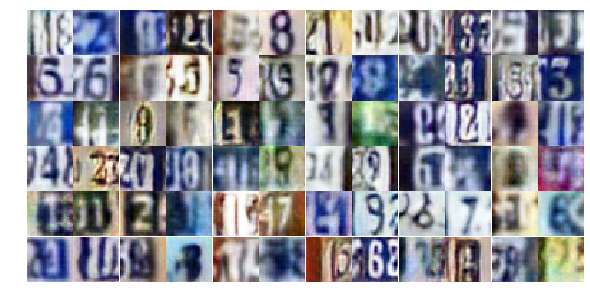

Epoch 15/25... Discriminator Loss: 0.9279... Generator Loss: 0.7256
Epoch 15/25... Discriminator Loss: 0.7121... Generator Loss: 1.6749
Epoch 15/25... Discriminator Loss: 1.1507... Generator Loss: 0.5936
Epoch 15/25... Discriminator Loss: 0.6401... Generator Loss: 1.1607
Epoch 15/25... Discriminator Loss: 0.7871... Generator Loss: 0.8775
Epoch 15/25... Discriminator Loss: 0.6245... Generator Loss: 1.1070
Epoch 15/25... Discriminator Loss: 1.4353... Generator Loss: 0.3858
Epoch 15/25... Discriminator Loss: 1.4939... Generator Loss: 3.2256
Epoch 15/25... Discriminator Loss: 0.7612... Generator Loss: 2.5158
Epoch 15/25... Discriminator Loss: 1.6085... Generator Loss: 0.3599


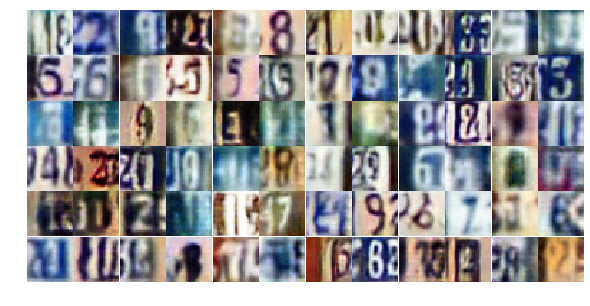

Epoch 15/25... Discriminator Loss: 0.9330... Generator Loss: 0.8339
Epoch 15/25... Discriminator Loss: 0.6535... Generator Loss: 1.1387
Epoch 15/25... Discriminator Loss: 0.5110... Generator Loss: 1.4446
Epoch 15/25... Discriminator Loss: 0.8365... Generator Loss: 0.8052
Epoch 15/25... Discriminator Loss: 1.1174... Generator Loss: 0.5879
Epoch 15/25... Discriminator Loss: 0.8943... Generator Loss: 0.7866
Epoch 15/25... Discriminator Loss: 0.8856... Generator Loss: 0.8358
Epoch 15/25... Discriminator Loss: 0.7167... Generator Loss: 0.9635
Epoch 15/25... Discriminator Loss: 0.5822... Generator Loss: 1.1730
Epoch 15/25... Discriminator Loss: 1.6804... Generator Loss: 0.3199


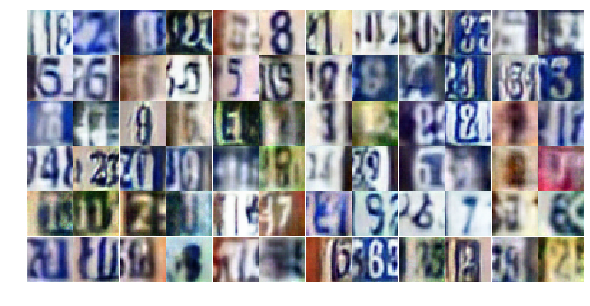

Epoch 15/25... Discriminator Loss: 0.6269... Generator Loss: 1.0912
Epoch 15/25... Discriminator Loss: 1.1250... Generator Loss: 0.5574
Epoch 15/25... Discriminator Loss: 0.5542... Generator Loss: 1.2563
Epoch 15/25... Discriminator Loss: 0.6805... Generator Loss: 1.0787
Epoch 15/25... Discriminator Loss: 0.6927... Generator Loss: 0.9920
Epoch 15/25... Discriminator Loss: 0.8254... Generator Loss: 1.5222
Epoch 15/25... Discriminator Loss: 0.5206... Generator Loss: 1.4520
Epoch 15/25... Discriminator Loss: 0.8340... Generator Loss: 0.8878
Epoch 15/25... Discriminator Loss: 0.5096... Generator Loss: 1.3731
Epoch 15/25... Discriminator Loss: 0.8049... Generator Loss: 0.8553


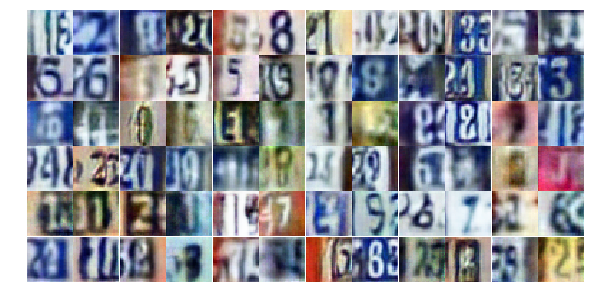

Epoch 15/25... Discriminator Loss: 0.6736... Generator Loss: 1.0546
Epoch 15/25... Discriminator Loss: 1.2992... Generator Loss: 0.4308
Epoch 15/25... Discriminator Loss: 0.6857... Generator Loss: 1.0487
Epoch 15/25... Discriminator Loss: 0.8138... Generator Loss: 0.8900
Epoch 15/25... Discriminator Loss: 0.4589... Generator Loss: 1.5057
Epoch 15/25... Discriminator Loss: 1.8657... Generator Loss: 0.2675
Epoch 15/25... Discriminator Loss: 0.5303... Generator Loss: 1.7938
Epoch 15/25... Discriminator Loss: 0.6599... Generator Loss: 1.2196
Epoch 15/25... Discriminator Loss: 0.8589... Generator Loss: 0.7918
Epoch 15/25... Discriminator Loss: 0.7188... Generator Loss: 1.0412


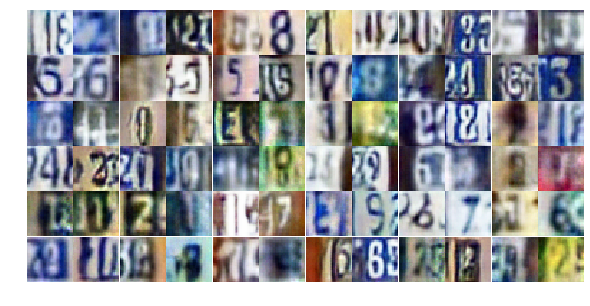

Epoch 15/25... Discriminator Loss: 0.6758... Generator Loss: 1.0118
Epoch 15/25... Discriminator Loss: 0.9583... Generator Loss: 0.9245
Epoch 15/25... Discriminator Loss: 0.6014... Generator Loss: 1.3803
Epoch 15/25... Discriminator Loss: 1.9979... Generator Loss: 0.2978
Epoch 15/25... Discriminator Loss: 0.7021... Generator Loss: 0.9418
Epoch 15/25... Discriminator Loss: 0.7680... Generator Loss: 1.7408
Epoch 15/25... Discriminator Loss: 0.7186... Generator Loss: 1.2749
Epoch 15/25... Discriminator Loss: 0.6621... Generator Loss: 1.2683
Epoch 15/25... Discriminator Loss: 1.2688... Generator Loss: 0.4772
Epoch 16/25... Discriminator Loss: 1.0386... Generator Loss: 0.6029


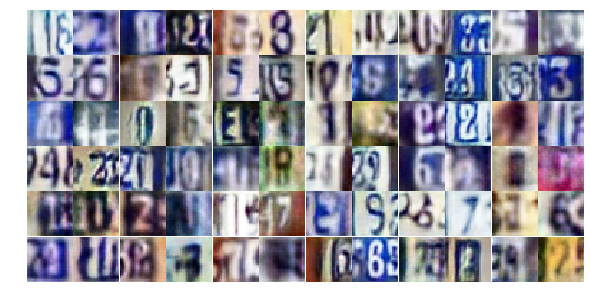

Epoch 16/25... Discriminator Loss: 0.7408... Generator Loss: 0.8833
Epoch 16/25... Discriminator Loss: 0.6874... Generator Loss: 1.0440
Epoch 16/25... Discriminator Loss: 1.6898... Generator Loss: 0.2904
Epoch 16/25... Discriminator Loss: 0.8845... Generator Loss: 0.7706
Epoch 16/25... Discriminator Loss: 0.7032... Generator Loss: 0.9853
Epoch 16/25... Discriminator Loss: 0.7325... Generator Loss: 2.2322
Epoch 16/25... Discriminator Loss: 1.6524... Generator Loss: 0.2807
Epoch 16/25... Discriminator Loss: 1.2378... Generator Loss: 0.5365
Epoch 16/25... Discriminator Loss: 0.6353... Generator Loss: 1.0702
Epoch 16/25... Discriminator Loss: 0.7535... Generator Loss: 0.8714


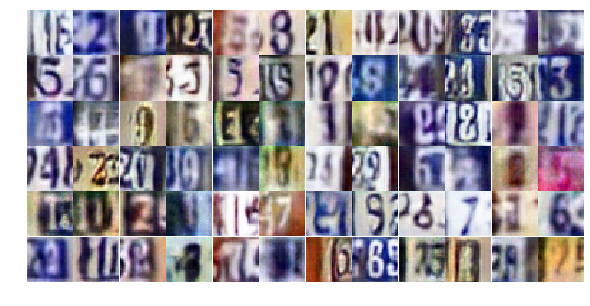

Epoch 16/25... Discriminator Loss: 1.2756... Generator Loss: 0.4579
Epoch 16/25... Discriminator Loss: 1.0021... Generator Loss: 0.6773
Epoch 16/25... Discriminator Loss: 0.8500... Generator Loss: 0.8882
Epoch 16/25... Discriminator Loss: 1.2348... Generator Loss: 0.4567
Epoch 16/25... Discriminator Loss: 0.6275... Generator Loss: 1.0146
Epoch 16/25... Discriminator Loss: 0.9266... Generator Loss: 0.6811
Epoch 16/25... Discriminator Loss: 1.1137... Generator Loss: 0.5789
Epoch 16/25... Discriminator Loss: 0.8560... Generator Loss: 1.0152
Epoch 16/25... Discriminator Loss: 0.5139... Generator Loss: 1.3167
Epoch 16/25... Discriminator Loss: 0.5478... Generator Loss: 1.2414


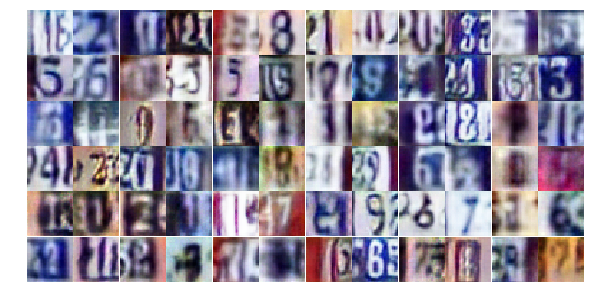

Epoch 16/25... Discriminator Loss: 0.7446... Generator Loss: 1.2566
Epoch 16/25... Discriminator Loss: 0.6876... Generator Loss: 0.9756
Epoch 16/25... Discriminator Loss: 0.8946... Generator Loss: 0.7375
Epoch 16/25... Discriminator Loss: 1.4851... Generator Loss: 0.3755
Epoch 16/25... Discriminator Loss: 0.8308... Generator Loss: 0.8541
Epoch 16/25... Discriminator Loss: 0.7545... Generator Loss: 1.5354
Epoch 16/25... Discriminator Loss: 0.7354... Generator Loss: 0.9030
Epoch 16/25... Discriminator Loss: 0.5603... Generator Loss: 1.2098
Epoch 16/25... Discriminator Loss: 0.8970... Generator Loss: 1.1049
Epoch 16/25... Discriminator Loss: 0.7690... Generator Loss: 0.9162


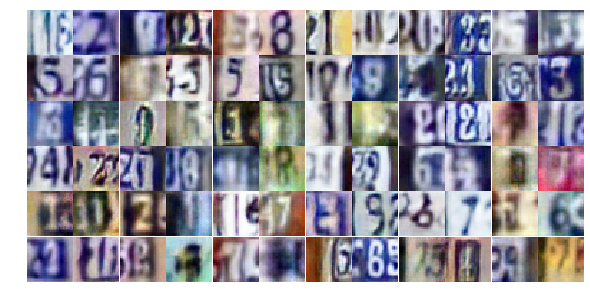

Epoch 16/25... Discriminator Loss: 0.6488... Generator Loss: 0.9741
Epoch 16/25... Discriminator Loss: 0.6918... Generator Loss: 1.0157
Epoch 16/25... Discriminator Loss: 0.6566... Generator Loss: 1.4238
Epoch 16/25... Discriminator Loss: 0.9407... Generator Loss: 2.6937
Epoch 16/25... Discriminator Loss: 0.7974... Generator Loss: 1.7274
Epoch 16/25... Discriminator Loss: 1.1600... Generator Loss: 0.5178
Epoch 16/25... Discriminator Loss: 1.1983... Generator Loss: 0.5303
Epoch 16/25... Discriminator Loss: 1.3707... Generator Loss: 0.3931
Epoch 16/25... Discriminator Loss: 0.9286... Generator Loss: 0.7419
Epoch 16/25... Discriminator Loss: 0.4355... Generator Loss: 2.3419


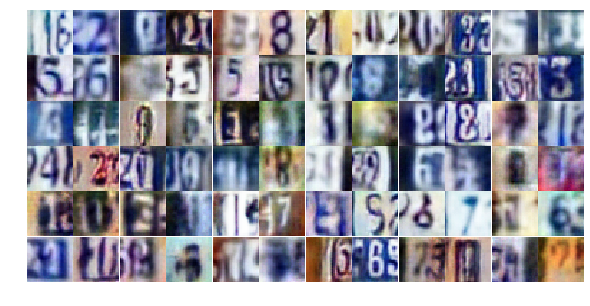

Epoch 16/25... Discriminator Loss: 0.5496... Generator Loss: 1.7193
Epoch 16/25... Discriminator Loss: 0.5775... Generator Loss: 1.7062
Epoch 16/25... Discriminator Loss: 1.4183... Generator Loss: 0.3915
Epoch 16/25... Discriminator Loss: 1.5937... Generator Loss: 2.6954
Epoch 16/25... Discriminator Loss: 0.8893... Generator Loss: 2.0963
Epoch 16/25... Discriminator Loss: 1.4708... Generator Loss: 0.3816
Epoch 16/25... Discriminator Loss: 0.5849... Generator Loss: 1.1627
Epoch 16/25... Discriminator Loss: 0.9504... Generator Loss: 0.7872
Epoch 16/25... Discriminator Loss: 0.5893... Generator Loss: 1.1490
Epoch 16/25... Discriminator Loss: 0.8568... Generator Loss: 0.7883


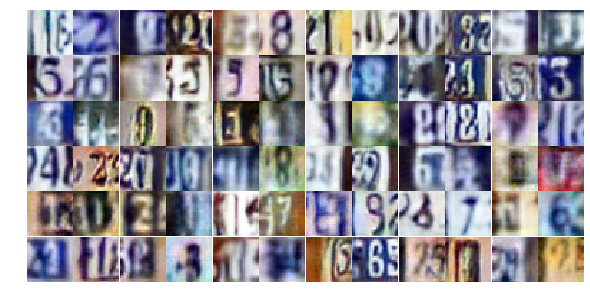

Epoch 16/25... Discriminator Loss: 1.1681... Generator Loss: 0.5639
Epoch 16/25... Discriminator Loss: 0.7278... Generator Loss: 0.9183
Epoch 16/25... Discriminator Loss: 1.4841... Generator Loss: 0.3908
Epoch 16/25... Discriminator Loss: 0.8304... Generator Loss: 0.8052
Epoch 16/25... Discriminator Loss: 0.6616... Generator Loss: 1.0353
Epoch 16/25... Discriminator Loss: 0.7694... Generator Loss: 0.9111
Epoch 17/25... Discriminator Loss: 0.9201... Generator Loss: 0.7561
Epoch 17/25... Discriminator Loss: 0.8451... Generator Loss: 0.8343
Epoch 17/25... Discriminator Loss: 0.9338... Generator Loss: 0.7609
Epoch 17/25... Discriminator Loss: 0.7057... Generator Loss: 1.0094


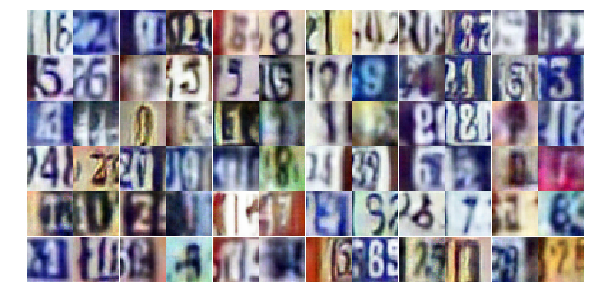

Epoch 17/25... Discriminator Loss: 0.4591... Generator Loss: 1.5259
Epoch 17/25... Discriminator Loss: 0.7163... Generator Loss: 1.1007
Epoch 17/25... Discriminator Loss: 1.0981... Generator Loss: 0.6018
Epoch 17/25... Discriminator Loss: 0.8451... Generator Loss: 0.7210
Epoch 17/25... Discriminator Loss: 1.0469... Generator Loss: 0.5787
Epoch 17/25... Discriminator Loss: 1.2596... Generator Loss: 0.4723
Epoch 17/25... Discriminator Loss: 0.7038... Generator Loss: 1.0002
Epoch 17/25... Discriminator Loss: 0.6139... Generator Loss: 1.1549
Epoch 17/25... Discriminator Loss: 0.4916... Generator Loss: 1.3634
Epoch 17/25... Discriminator Loss: 0.6625... Generator Loss: 1.0417


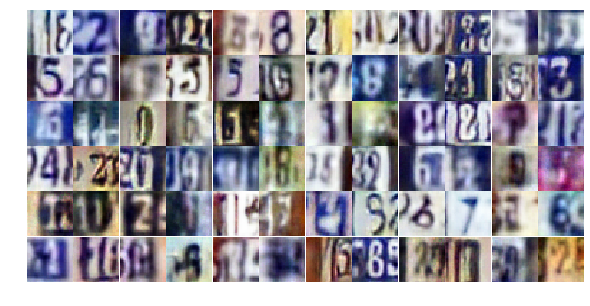

Epoch 17/25... Discriminator Loss: 1.0627... Generator Loss: 0.5991
Epoch 17/25... Discriminator Loss: 0.5811... Generator Loss: 1.2897
Epoch 17/25... Discriminator Loss: 0.5808... Generator Loss: 1.1788
Epoch 17/25... Discriminator Loss: 1.7120... Generator Loss: 0.3260
Epoch 17/25... Discriminator Loss: 0.8293... Generator Loss: 1.1618
Epoch 17/25... Discriminator Loss: 0.9884... Generator Loss: 0.6937
Epoch 17/25... Discriminator Loss: 0.6223... Generator Loss: 1.2732
Epoch 17/25... Discriminator Loss: 0.5511... Generator Loss: 1.3396
Epoch 17/25... Discriminator Loss: 0.7846... Generator Loss: 0.8941
Epoch 17/25... Discriminator Loss: 0.5088... Generator Loss: 1.2541


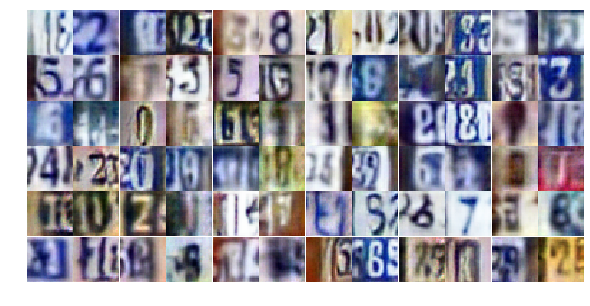

Epoch 17/25... Discriminator Loss: 1.5140... Generator Loss: 0.3340
Epoch 17/25... Discriminator Loss: 0.4816... Generator Loss: 1.2874
Epoch 17/25... Discriminator Loss: 0.3923... Generator Loss: 1.6544
Epoch 17/25... Discriminator Loss: 1.1994... Generator Loss: 0.4881
Epoch 17/25... Discriminator Loss: 1.6719... Generator Loss: 0.3524
Epoch 17/25... Discriminator Loss: 0.8653... Generator Loss: 0.9172
Epoch 17/25... Discriminator Loss: 0.7968... Generator Loss: 0.8728
Epoch 17/25... Discriminator Loss: 0.9452... Generator Loss: 0.7040
Epoch 17/25... Discriminator Loss: 0.8890... Generator Loss: 0.8664
Epoch 17/25... Discriminator Loss: 0.4609... Generator Loss: 1.4109


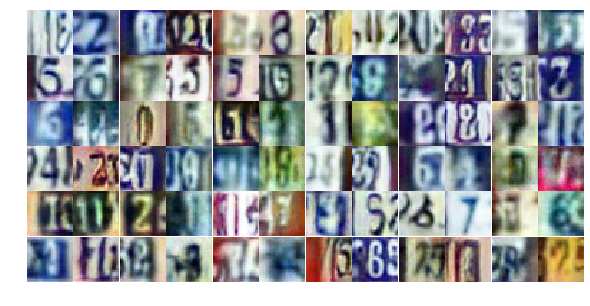

Epoch 17/25... Discriminator Loss: 0.7143... Generator Loss: 1.1957
Epoch 17/25... Discriminator Loss: 1.5495... Generator Loss: 0.4506
Epoch 17/25... Discriminator Loss: 0.5339... Generator Loss: 1.6099
Epoch 17/25... Discriminator Loss: 0.8504... Generator Loss: 0.9428
Epoch 17/25... Discriminator Loss: 1.1170... Generator Loss: 0.5830
Epoch 17/25... Discriminator Loss: 0.6073... Generator Loss: 1.3036
Epoch 17/25... Discriminator Loss: 0.7535... Generator Loss: 1.3464
Epoch 17/25... Discriminator Loss: 0.5105... Generator Loss: 1.5012
Epoch 17/25... Discriminator Loss: 0.4695... Generator Loss: 2.2371
Epoch 17/25... Discriminator Loss: 1.1447... Generator Loss: 0.5369


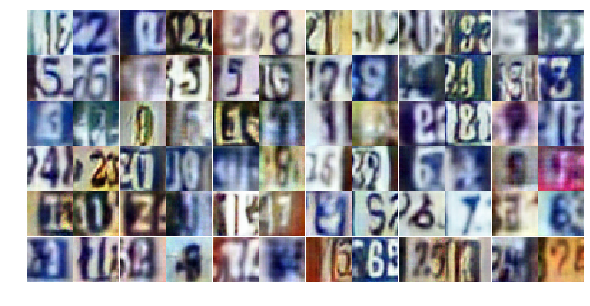

Epoch 17/25... Discriminator Loss: 1.1725... Generator Loss: 1.9824
Epoch 17/25... Discriminator Loss: 0.4409... Generator Loss: 1.3110
Epoch 17/25... Discriminator Loss: 0.8014... Generator Loss: 1.1695
Epoch 17/25... Discriminator Loss: 0.5135... Generator Loss: 1.1766
Epoch 17/25... Discriminator Loss: 1.0336... Generator Loss: 0.5812
Epoch 17/25... Discriminator Loss: 0.9699... Generator Loss: 0.6668
Epoch 17/25... Discriminator Loss: 1.0892... Generator Loss: 0.5311
Epoch 17/25... Discriminator Loss: 0.4798... Generator Loss: 1.9875
Epoch 17/25... Discriminator Loss: 0.7029... Generator Loss: 1.1117
Epoch 17/25... Discriminator Loss: 1.9390... Generator Loss: 0.2320


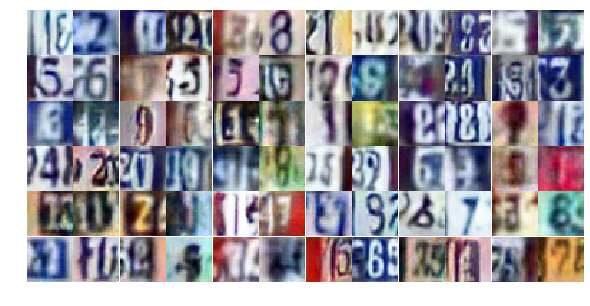

Epoch 17/25... Discriminator Loss: 1.3918... Generator Loss: 0.5520
Epoch 17/25... Discriminator Loss: 0.9414... Generator Loss: 0.8645
Epoch 17/25... Discriminator Loss: 0.5573... Generator Loss: 1.1381
Epoch 17/25... Discriminator Loss: 0.5482... Generator Loss: 1.5988
Epoch 18/25... Discriminator Loss: 1.2020... Generator Loss: 0.5095
Epoch 18/25... Discriminator Loss: 1.0216... Generator Loss: 0.6360
Epoch 18/25... Discriminator Loss: 0.7358... Generator Loss: 0.9756
Epoch 18/25... Discriminator Loss: 0.9039... Generator Loss: 0.7400
Epoch 18/25... Discriminator Loss: 1.1462... Generator Loss: 2.0688
Epoch 18/25... Discriminator Loss: 0.8579... Generator Loss: 0.8291


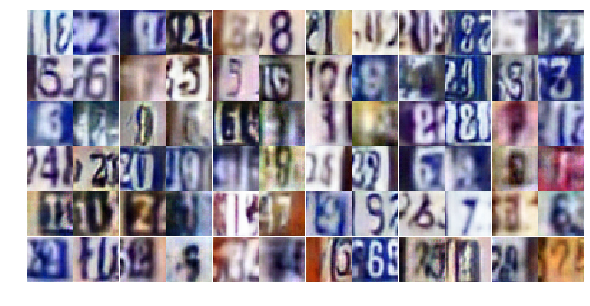

Epoch 18/25... Discriminator Loss: 0.5509... Generator Loss: 1.2848
Epoch 18/25... Discriminator Loss: 1.2275... Generator Loss: 0.4756
Epoch 18/25... Discriminator Loss: 0.8393... Generator Loss: 0.7424
Epoch 18/25... Discriminator Loss: 0.5410... Generator Loss: 1.2290
Epoch 18/25... Discriminator Loss: 0.5916... Generator Loss: 1.2756
Epoch 18/25... Discriminator Loss: 1.3369... Generator Loss: 0.4943
Epoch 18/25... Discriminator Loss: 0.6390... Generator Loss: 1.1133
Epoch 18/25... Discriminator Loss: 1.2641... Generator Loss: 0.4327
Epoch 18/25... Discriminator Loss: 0.5863... Generator Loss: 2.2669
Epoch 18/25... Discriminator Loss: 0.2950... Generator Loss: 1.9841


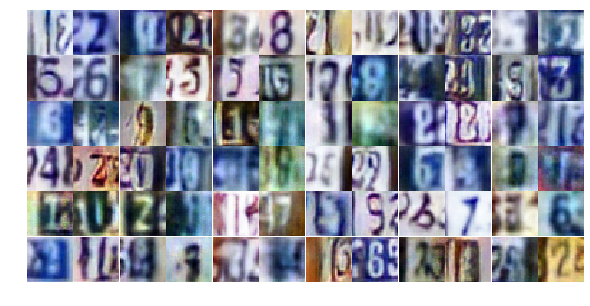

Epoch 18/25... Discriminator Loss: 0.6059... Generator Loss: 1.2557
Epoch 18/25... Discriminator Loss: 0.7977... Generator Loss: 1.1138
Epoch 18/25... Discriminator Loss: 1.1424... Generator Loss: 0.6301
Epoch 18/25... Discriminator Loss: 0.5340... Generator Loss: 1.4290
Epoch 18/25... Discriminator Loss: 0.9986... Generator Loss: 0.6648
Epoch 18/25... Discriminator Loss: 0.9538... Generator Loss: 0.6891
Epoch 18/25... Discriminator Loss: 0.9128... Generator Loss: 0.7688
Epoch 18/25... Discriminator Loss: 0.6962... Generator Loss: 1.0338
Epoch 18/25... Discriminator Loss: 0.9106... Generator Loss: 0.7973
Epoch 18/25... Discriminator Loss: 0.6585... Generator Loss: 0.9320


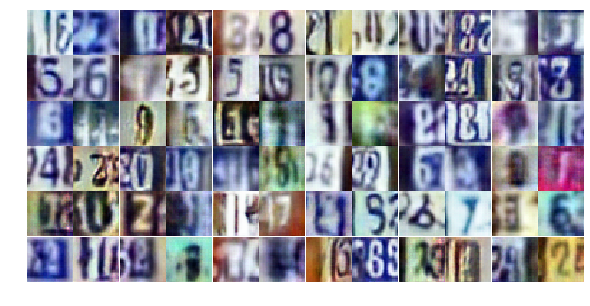

Epoch 18/25... Discriminator Loss: 0.5665... Generator Loss: 1.3377
Epoch 18/25... Discriminator Loss: 0.6091... Generator Loss: 1.4484
Epoch 18/25... Discriminator Loss: 0.8927... Generator Loss: 0.7143
Epoch 18/25... Discriminator Loss: 0.8726... Generator Loss: 1.1892
Epoch 18/25... Discriminator Loss: 0.7953... Generator Loss: 0.9718
Epoch 18/25... Discriminator Loss: 0.6025... Generator Loss: 1.2343
Epoch 18/25... Discriminator Loss: 0.8424... Generator Loss: 0.8348
Epoch 18/25... Discriminator Loss: 0.5264... Generator Loss: 1.2646
Epoch 18/25... Discriminator Loss: 0.7034... Generator Loss: 1.0847
Epoch 18/25... Discriminator Loss: 0.7503... Generator Loss: 1.3110


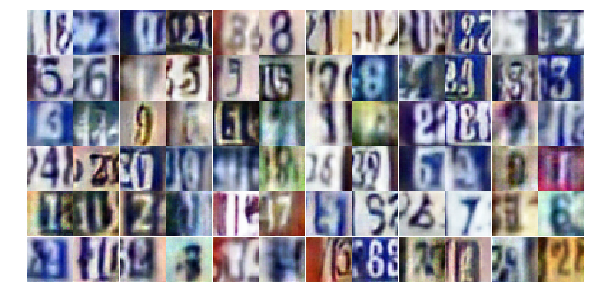

Epoch 18/25... Discriminator Loss: 0.8340... Generator Loss: 0.8841
Epoch 18/25... Discriminator Loss: 0.7476... Generator Loss: 0.9064
Epoch 18/25... Discriminator Loss: 1.0508... Generator Loss: 0.5888
Epoch 18/25... Discriminator Loss: 0.8205... Generator Loss: 0.9802
Epoch 18/25... Discriminator Loss: 0.8710... Generator Loss: 0.7693
Epoch 18/25... Discriminator Loss: 0.5052... Generator Loss: 1.1991
Epoch 18/25... Discriminator Loss: 0.8126... Generator Loss: 0.7968
Epoch 18/25... Discriminator Loss: 2.4055... Generator Loss: 3.7657
Epoch 18/25... Discriminator Loss: 0.6934... Generator Loss: 1.3514
Epoch 18/25... Discriminator Loss: 0.3722... Generator Loss: 1.7634


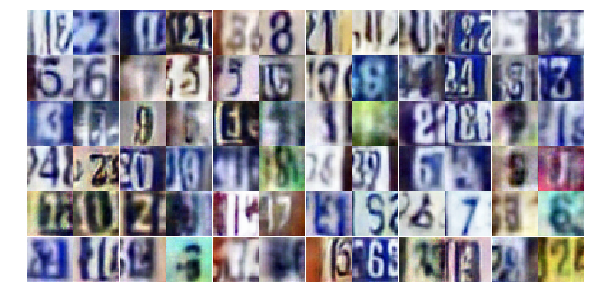

Epoch 18/25... Discriminator Loss: 0.5244... Generator Loss: 1.8079
Epoch 18/25... Discriminator Loss: 0.8126... Generator Loss: 0.8440
Epoch 18/25... Discriminator Loss: 0.8785... Generator Loss: 0.7880
Epoch 18/25... Discriminator Loss: 0.9708... Generator Loss: 0.7424
Epoch 18/25... Discriminator Loss: 0.6655... Generator Loss: 1.0184
Epoch 18/25... Discriminator Loss: 0.5650... Generator Loss: 1.4480
Epoch 18/25... Discriminator Loss: 0.8620... Generator Loss: 0.7584
Epoch 18/25... Discriminator Loss: 0.5877... Generator Loss: 1.5684
Epoch 18/25... Discriminator Loss: 1.3488... Generator Loss: 0.4284
Epoch 18/25... Discriminator Loss: 0.6895... Generator Loss: 1.0041


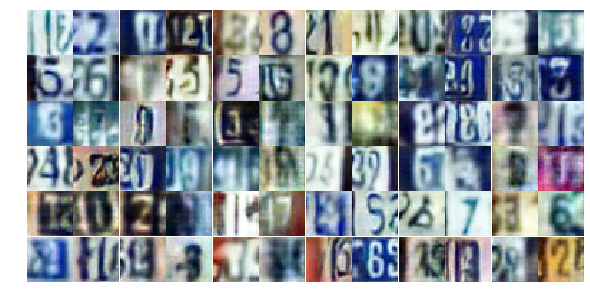

Epoch 18/25... Discriminator Loss: 0.6570... Generator Loss: 2.1775
Epoch 19/25... Discriminator Loss: 0.7551... Generator Loss: 1.3311
Epoch 19/25... Discriminator Loss: 1.1365... Generator Loss: 0.5476
Epoch 19/25... Discriminator Loss: 1.0653... Generator Loss: 0.5801
Epoch 19/25... Discriminator Loss: 0.6607... Generator Loss: 1.1402
Epoch 19/25... Discriminator Loss: 1.9615... Generator Loss: 0.2296
Epoch 19/25... Discriminator Loss: 0.6663... Generator Loss: 1.0380
Epoch 19/25... Discriminator Loss: 0.9575... Generator Loss: 0.7044
Epoch 19/25... Discriminator Loss: 0.8006... Generator Loss: 2.6351
Epoch 19/25... Discriminator Loss: 0.6826... Generator Loss: 1.2776


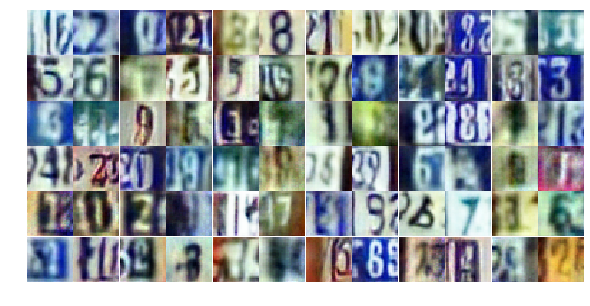

Epoch 19/25... Discriminator Loss: 0.8718... Generator Loss: 0.8447
Epoch 19/25... Discriminator Loss: 0.9881... Generator Loss: 0.6452
Epoch 19/25... Discriminator Loss: 0.7385... Generator Loss: 1.3020
Epoch 19/25... Discriminator Loss: 1.4761... Generator Loss: 0.3983
Epoch 19/25... Discriminator Loss: 0.9503... Generator Loss: 0.6662
Epoch 19/25... Discriminator Loss: 0.6087... Generator Loss: 1.4573
Epoch 19/25... Discriminator Loss: 0.8239... Generator Loss: 0.7892
Epoch 19/25... Discriminator Loss: 0.7692... Generator Loss: 0.8563
Epoch 19/25... Discriminator Loss: 5.4386... Generator Loss: 0.0791
Epoch 19/25... Discriminator Loss: 1.4456... Generator Loss: 0.5423


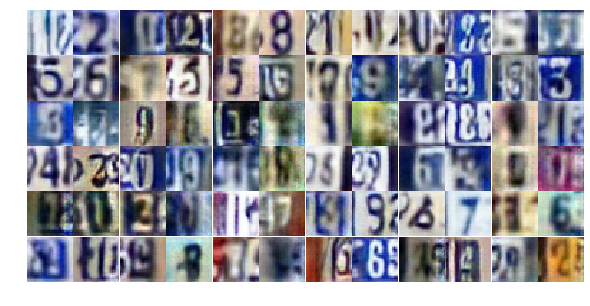

Epoch 19/25... Discriminator Loss: 1.2604... Generator Loss: 0.5319
Epoch 19/25... Discriminator Loss: 1.1064... Generator Loss: 0.6155
Epoch 19/25... Discriminator Loss: 0.8928... Generator Loss: 0.7877
Epoch 19/25... Discriminator Loss: 0.8591... Generator Loss: 0.9617
Epoch 19/25... Discriminator Loss: 1.1724... Generator Loss: 0.5961
Epoch 19/25... Discriminator Loss: 0.8523... Generator Loss: 1.1137
Epoch 19/25... Discriminator Loss: 0.8084... Generator Loss: 0.9563
Epoch 19/25... Discriminator Loss: 0.6410... Generator Loss: 1.0136
Epoch 19/25... Discriminator Loss: 0.7511... Generator Loss: 1.5426
Epoch 19/25... Discriminator Loss: 1.2284... Generator Loss: 0.4791


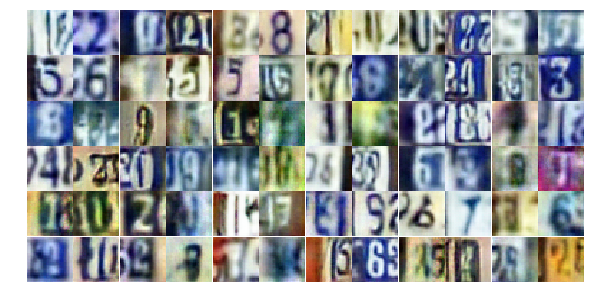

Epoch 19/25... Discriminator Loss: 1.1548... Generator Loss: 0.5531
Epoch 19/25... Discriminator Loss: 0.6750... Generator Loss: 0.9792
Epoch 19/25... Discriminator Loss: 1.0338... Generator Loss: 0.6180
Epoch 19/25... Discriminator Loss: 0.6591... Generator Loss: 1.0864
Epoch 19/25... Discriminator Loss: 0.5831... Generator Loss: 1.4443
Epoch 19/25... Discriminator Loss: 1.1717... Generator Loss: 0.4935
Epoch 19/25... Discriminator Loss: 0.7510... Generator Loss: 1.2557
Epoch 19/25... Discriminator Loss: 0.5115... Generator Loss: 1.7523
Epoch 19/25... Discriminator Loss: 0.8705... Generator Loss: 0.9113
Epoch 19/25... Discriminator Loss: 0.6862... Generator Loss: 0.9486


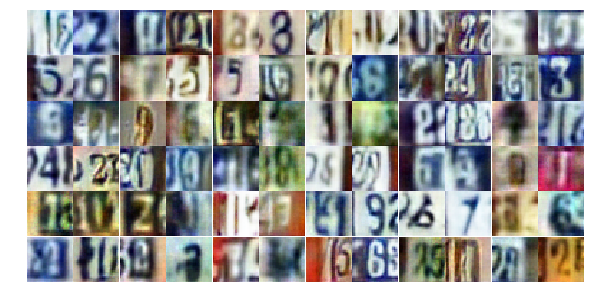

Epoch 19/25... Discriminator Loss: 0.5773... Generator Loss: 1.3071
Epoch 19/25... Discriminator Loss: 1.0506... Generator Loss: 0.6998
Epoch 19/25... Discriminator Loss: 1.3602... Generator Loss: 0.4072
Epoch 19/25... Discriminator Loss: 0.6843... Generator Loss: 0.9532
Epoch 19/25... Discriminator Loss: 1.0639... Generator Loss: 0.5762
Epoch 19/25... Discriminator Loss: 0.6082... Generator Loss: 1.2837
Epoch 19/25... Discriminator Loss: 0.8133... Generator Loss: 0.9413
Epoch 19/25... Discriminator Loss: 0.5298... Generator Loss: 1.2758
Epoch 19/25... Discriminator Loss: 0.5692... Generator Loss: 1.3974
Epoch 19/25... Discriminator Loss: 0.8594... Generator Loss: 0.8736


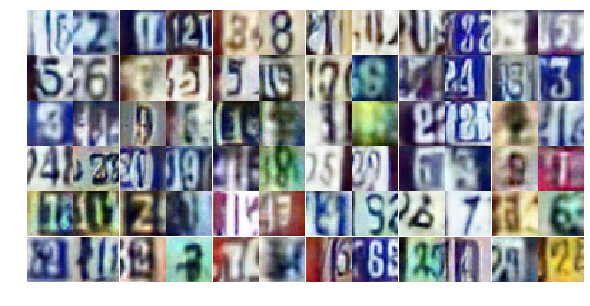

Epoch 19/25... Discriminator Loss: 1.0673... Generator Loss: 0.6147
Epoch 19/25... Discriminator Loss: 0.6475... Generator Loss: 1.1331
Epoch 19/25... Discriminator Loss: 0.6918... Generator Loss: 1.6849
Epoch 19/25... Discriminator Loss: 0.7536... Generator Loss: 1.0178
Epoch 19/25... Discriminator Loss: 1.1675... Generator Loss: 2.6984
Epoch 19/25... Discriminator Loss: 0.7121... Generator Loss: 1.1566
Epoch 19/25... Discriminator Loss: 1.1254... Generator Loss: 0.5162
Epoch 19/25... Discriminator Loss: 0.6837... Generator Loss: 1.2077
Epoch 20/25... Discriminator Loss: 0.7933... Generator Loss: 1.0161
Epoch 20/25... Discriminator Loss: 0.8411... Generator Loss: 0.8182


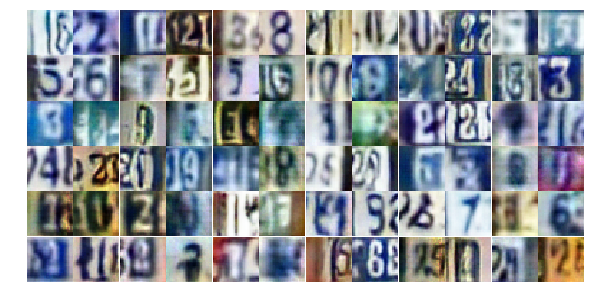

Epoch 20/25... Discriminator Loss: 0.5680... Generator Loss: 1.1916
Epoch 20/25... Discriminator Loss: 0.9403... Generator Loss: 0.7041
Epoch 20/25... Discriminator Loss: 1.0023... Generator Loss: 0.7094
Epoch 20/25... Discriminator Loss: 0.6220... Generator Loss: 1.1602
Epoch 20/25... Discriminator Loss: 0.7806... Generator Loss: 0.9312
Epoch 20/25... Discriminator Loss: 1.1023... Generator Loss: 0.6036
Epoch 20/25... Discriminator Loss: 0.6761... Generator Loss: 1.5004
Epoch 20/25... Discriminator Loss: 0.8182... Generator Loss: 1.9990
Epoch 20/25... Discriminator Loss: 0.9984... Generator Loss: 0.6778
Epoch 20/25... Discriminator Loss: 0.7889... Generator Loss: 0.8799


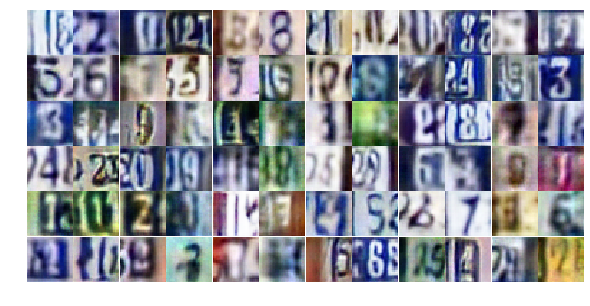

Epoch 20/25... Discriminator Loss: 1.6424... Generator Loss: 0.3379
Epoch 20/25... Discriminator Loss: 1.0016... Generator Loss: 0.7061
Epoch 20/25... Discriminator Loss: 0.6453... Generator Loss: 1.3138
Epoch 20/25... Discriminator Loss: 0.6065... Generator Loss: 1.3086
Epoch 20/25... Discriminator Loss: 1.1385... Generator Loss: 0.5369
Epoch 20/25... Discriminator Loss: 1.4020... Generator Loss: 0.4092
Epoch 20/25... Discriminator Loss: 2.2249... Generator Loss: 0.1883
Epoch 20/25... Discriminator Loss: 0.7160... Generator Loss: 2.2969
Epoch 20/25... Discriminator Loss: 1.2784... Generator Loss: 0.4318
Epoch 20/25... Discriminator Loss: 1.3196... Generator Loss: 0.5626


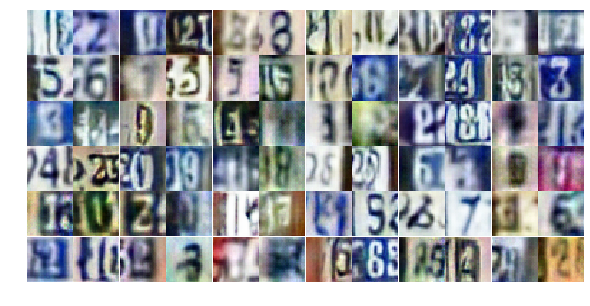

Epoch 20/25... Discriminator Loss: 0.5960... Generator Loss: 1.1249
Epoch 20/25... Discriminator Loss: 0.7370... Generator Loss: 0.9544
Epoch 20/25... Discriminator Loss: 0.3506... Generator Loss: 2.0847
Epoch 20/25... Discriminator Loss: 1.1095... Generator Loss: 0.6161
Epoch 20/25... Discriminator Loss: 0.7969... Generator Loss: 0.9279
Epoch 20/25... Discriminator Loss: 0.5580... Generator Loss: 1.3037
Epoch 20/25... Discriminator Loss: 0.5555... Generator Loss: 2.0803
Epoch 20/25... Discriminator Loss: 1.5900... Generator Loss: 0.2985
Epoch 20/25... Discriminator Loss: 1.0714... Generator Loss: 0.5959
Epoch 20/25... Discriminator Loss: 0.4980... Generator Loss: 1.1900


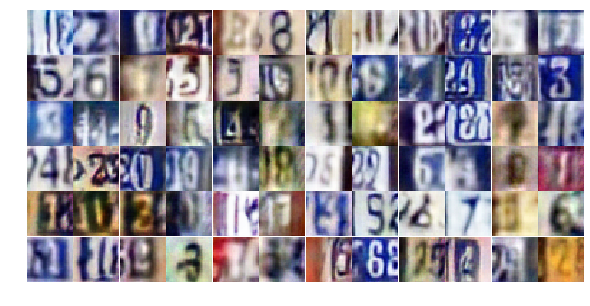

Epoch 20/25... Discriminator Loss: 0.9667... Generator Loss: 1.7963
Epoch 20/25... Discriminator Loss: 0.7715... Generator Loss: 0.9267
Epoch 20/25... Discriminator Loss: 1.0169... Generator Loss: 0.6637
Epoch 20/25... Discriminator Loss: 0.7319... Generator Loss: 1.2929
Epoch 20/25... Discriminator Loss: 0.9706... Generator Loss: 0.7424
Epoch 20/25... Discriminator Loss: 0.7374... Generator Loss: 0.9511
Epoch 20/25... Discriminator Loss: 0.9713... Generator Loss: 0.6991
Epoch 20/25... Discriminator Loss: 1.2620... Generator Loss: 0.4712
Epoch 20/25... Discriminator Loss: 0.7235... Generator Loss: 1.0615
Epoch 20/25... Discriminator Loss: 1.3173... Generator Loss: 0.4103


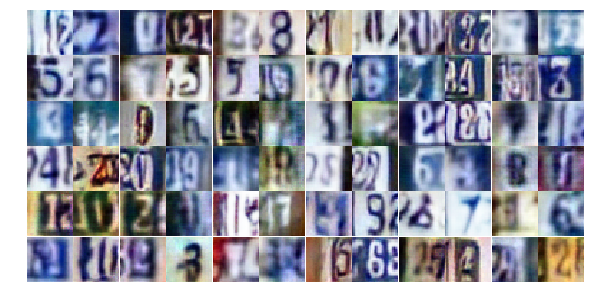

Epoch 20/25... Discriminator Loss: 1.4077... Generator Loss: 0.4633
Epoch 20/25... Discriminator Loss: 0.7891... Generator Loss: 1.2717
Epoch 20/25... Discriminator Loss: 0.7216... Generator Loss: 0.9561
Epoch 20/25... Discriminator Loss: 0.8570... Generator Loss: 1.0860
Epoch 20/25... Discriminator Loss: 0.6641... Generator Loss: 1.1534
Epoch 20/25... Discriminator Loss: 1.2949... Generator Loss: 0.4786
Epoch 20/25... Discriminator Loss: 1.2944... Generator Loss: 0.4768
Epoch 20/25... Discriminator Loss: 0.5517... Generator Loss: 1.2929
Epoch 20/25... Discriminator Loss: 0.6624... Generator Loss: 1.1600
Epoch 20/25... Discriminator Loss: 0.8538... Generator Loss: 0.8123


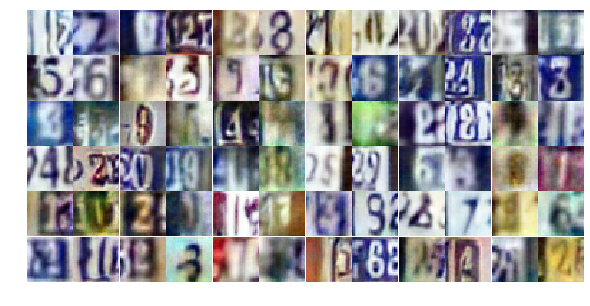

Epoch 20/25... Discriminator Loss: 0.5827... Generator Loss: 2.9511
Epoch 20/25... Discriminator Loss: 0.6725... Generator Loss: 1.2160
Epoch 20/25... Discriminator Loss: 0.5329... Generator Loss: 1.5573
Epoch 20/25... Discriminator Loss: 1.0605... Generator Loss: 0.7566
Epoch 20/25... Discriminator Loss: 0.5547... Generator Loss: 1.3010
Epoch 20/25... Discriminator Loss: 0.4048... Generator Loss: 1.5635
Epoch 21/25... Discriminator Loss: 0.9796... Generator Loss: 0.7273
Epoch 21/25... Discriminator Loss: 0.8978... Generator Loss: 0.6905
Epoch 21/25... Discriminator Loss: 1.2062... Generator Loss: 0.5221
Epoch 21/25... Discriminator Loss: 1.5805... Generator Loss: 0.3337


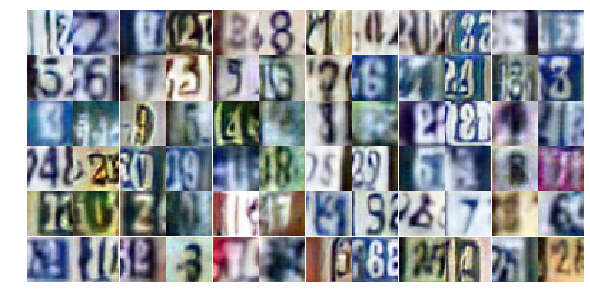

Epoch 21/25... Discriminator Loss: 0.7616... Generator Loss: 1.0717
Epoch 21/25... Discriminator Loss: 1.6850... Generator Loss: 0.2772
Epoch 21/25... Discriminator Loss: 0.3701... Generator Loss: 2.1165
Epoch 21/25... Discriminator Loss: 0.4087... Generator Loss: 1.5164
Epoch 21/25... Discriminator Loss: 0.5385... Generator Loss: 1.2445
Epoch 21/25... Discriminator Loss: 0.4289... Generator Loss: 1.5911
Epoch 21/25... Discriminator Loss: 0.7064... Generator Loss: 1.0680
Epoch 21/25... Discriminator Loss: 1.2277... Generator Loss: 0.5338
Epoch 21/25... Discriminator Loss: 0.7187... Generator Loss: 1.0068
Epoch 21/25... Discriminator Loss: 1.2413... Generator Loss: 0.4963


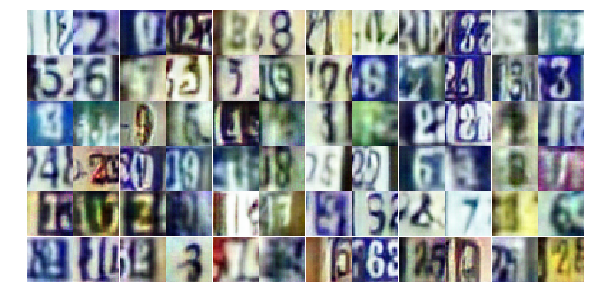

Epoch 21/25... Discriminator Loss: 0.4823... Generator Loss: 1.2473
Epoch 21/25... Discriminator Loss: 0.8548... Generator Loss: 0.7807
Epoch 21/25... Discriminator Loss: 1.4101... Generator Loss: 0.5456
Epoch 21/25... Discriminator Loss: 0.9023... Generator Loss: 0.9945
Epoch 21/25... Discriminator Loss: 0.5593... Generator Loss: 1.4716
Epoch 21/25... Discriminator Loss: 0.7973... Generator Loss: 0.8586
Epoch 21/25... Discriminator Loss: 0.8205... Generator Loss: 0.8243
Epoch 21/25... Discriminator Loss: 0.4218... Generator Loss: 1.7729
Epoch 21/25... Discriminator Loss: 0.5010... Generator Loss: 1.3223
Epoch 21/25... Discriminator Loss: 0.9927... Generator Loss: 0.6333


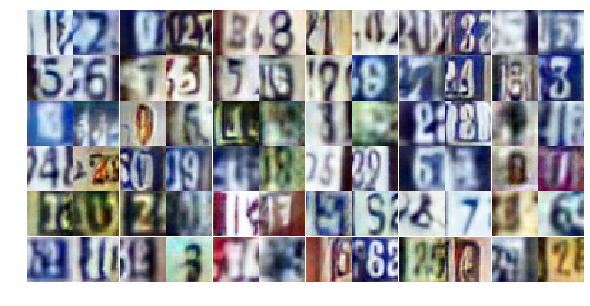

Epoch 21/25... Discriminator Loss: 1.0354... Generator Loss: 0.6451
Epoch 21/25... Discriminator Loss: 0.3855... Generator Loss: 1.6953
Epoch 21/25... Discriminator Loss: 1.0154... Generator Loss: 0.6326
Epoch 21/25... Discriminator Loss: 0.9206... Generator Loss: 0.8459
Epoch 21/25... Discriminator Loss: 0.8110... Generator Loss: 0.8972
Epoch 21/25... Discriminator Loss: 0.7477... Generator Loss: 1.0474
Epoch 21/25... Discriminator Loss: 0.6309... Generator Loss: 1.0558
Epoch 21/25... Discriminator Loss: 0.9860... Generator Loss: 0.7872
Epoch 21/25... Discriminator Loss: 1.5621... Generator Loss: 0.3696
Epoch 21/25... Discriminator Loss: 1.5707... Generator Loss: 0.3809


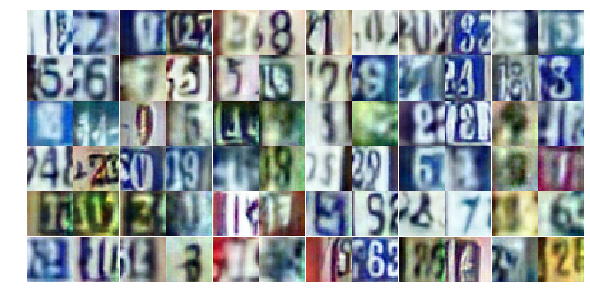

Epoch 21/25... Discriminator Loss: 0.8174... Generator Loss: 0.8360
Epoch 21/25... Discriminator Loss: 0.9979... Generator Loss: 0.7152
Epoch 21/25... Discriminator Loss: 1.3062... Generator Loss: 0.4514
Epoch 21/25... Discriminator Loss: 0.4333... Generator Loss: 1.4002
Epoch 21/25... Discriminator Loss: 0.5209... Generator Loss: 1.3907
Epoch 21/25... Discriminator Loss: 1.2880... Generator Loss: 0.4554
Epoch 21/25... Discriminator Loss: 0.9914... Generator Loss: 0.8681
Epoch 21/25... Discriminator Loss: 1.8127... Generator Loss: 0.2978
Epoch 21/25... Discriminator Loss: 1.1389... Generator Loss: 2.4023
Epoch 21/25... Discriminator Loss: 0.6913... Generator Loss: 1.3296


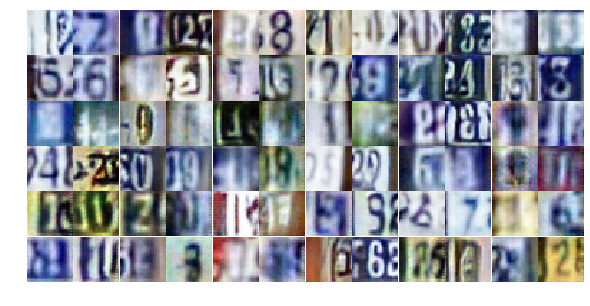

Epoch 21/25... Discriminator Loss: 1.1506... Generator Loss: 0.5760
Epoch 21/25... Discriminator Loss: 1.0956... Generator Loss: 0.5942
Epoch 21/25... Discriminator Loss: 0.7078... Generator Loss: 1.0241
Epoch 21/25... Discriminator Loss: 0.7531... Generator Loss: 1.1314
Epoch 21/25... Discriminator Loss: 0.4269... Generator Loss: 1.8176
Epoch 21/25... Discriminator Loss: 0.8893... Generator Loss: 0.9045
Epoch 21/25... Discriminator Loss: 1.0652... Generator Loss: 0.5772
Epoch 21/25... Discriminator Loss: 1.0386... Generator Loss: 0.6393
Epoch 21/25... Discriminator Loss: 0.9910... Generator Loss: 0.6842
Epoch 21/25... Discriminator Loss: 0.7549... Generator Loss: 1.0718


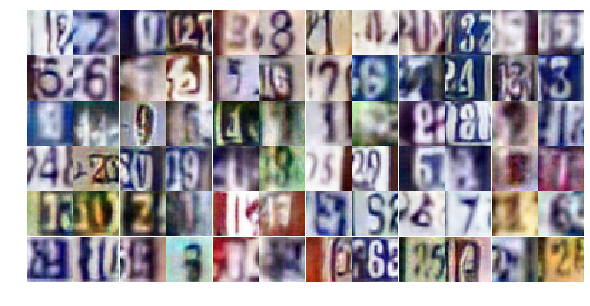

Epoch 21/25... Discriminator Loss: 0.6840... Generator Loss: 1.0960
Epoch 21/25... Discriminator Loss: 1.7246... Generator Loss: 0.3157
Epoch 21/25... Discriminator Loss: 1.0707... Generator Loss: 0.9509
Epoch 22/25... Discriminator Loss: 0.6959... Generator Loss: 1.4637
Epoch 22/25... Discriminator Loss: 1.0311... Generator Loss: 0.6347
Epoch 22/25... Discriminator Loss: 0.7805... Generator Loss: 0.9648
Epoch 22/25... Discriminator Loss: 0.5684... Generator Loss: 1.3868
Epoch 22/25... Discriminator Loss: 0.7447... Generator Loss: 0.8717
Epoch 22/25... Discriminator Loss: 1.3241... Generator Loss: 0.4376
Epoch 22/25... Discriminator Loss: 1.0611... Generator Loss: 0.6505


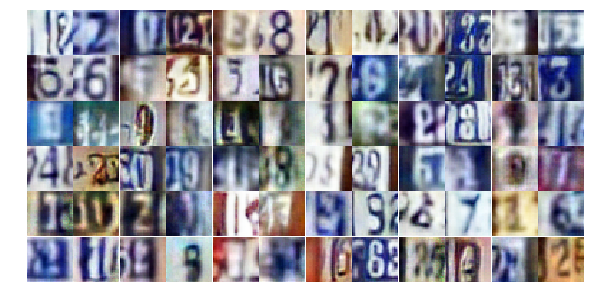

Epoch 22/25... Discriminator Loss: 0.5798... Generator Loss: 1.3896
Epoch 22/25... Discriminator Loss: 0.6411... Generator Loss: 1.1133
Epoch 22/25... Discriminator Loss: 1.1181... Generator Loss: 0.6480
Epoch 22/25... Discriminator Loss: 0.9602... Generator Loss: 0.8293
Epoch 22/25... Discriminator Loss: 1.0163... Generator Loss: 0.6972
Epoch 22/25... Discriminator Loss: 0.5863... Generator Loss: 1.4254
Epoch 22/25... Discriminator Loss: 0.7142... Generator Loss: 1.0079
Epoch 22/25... Discriminator Loss: 0.5558... Generator Loss: 1.5818
Epoch 22/25... Discriminator Loss: 1.2005... Generator Loss: 0.5438
Epoch 22/25... Discriminator Loss: 1.6827... Generator Loss: 0.2877


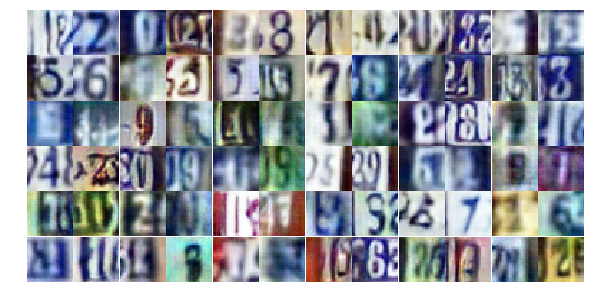

Epoch 22/25... Discriminator Loss: 0.5354... Generator Loss: 1.9943
Epoch 22/25... Discriminator Loss: 0.6545... Generator Loss: 1.0762
Epoch 22/25... Discriminator Loss: 1.1786... Generator Loss: 0.5230
Epoch 22/25... Discriminator Loss: 0.7272... Generator Loss: 0.8982
Epoch 22/25... Discriminator Loss: 0.5524... Generator Loss: 1.2385
Epoch 22/25... Discriminator Loss: 1.1379... Generator Loss: 0.5563
Epoch 22/25... Discriminator Loss: 0.3965... Generator Loss: 1.6611
Epoch 22/25... Discriminator Loss: 0.4430... Generator Loss: 1.6761
Epoch 22/25... Discriminator Loss: 0.7628... Generator Loss: 0.9030
Epoch 22/25... Discriminator Loss: 1.0467... Generator Loss: 0.6838


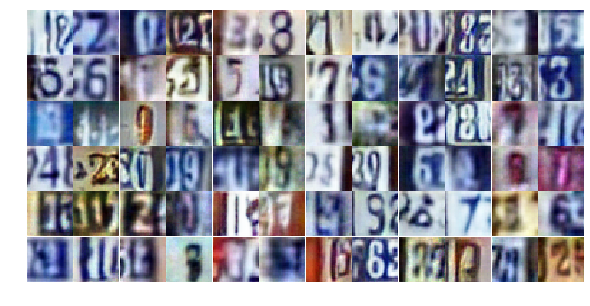

Epoch 22/25... Discriminator Loss: 0.4959... Generator Loss: 1.3352
Epoch 22/25... Discriminator Loss: 0.5176... Generator Loss: 1.9059
Epoch 22/25... Discriminator Loss: 0.6059... Generator Loss: 1.1305
Epoch 22/25... Discriminator Loss: 0.7523... Generator Loss: 0.8593
Epoch 22/25... Discriminator Loss: 0.9029... Generator Loss: 0.7998
Epoch 22/25... Discriminator Loss: 0.8908... Generator Loss: 0.7499
Epoch 22/25... Discriminator Loss: 1.7998... Generator Loss: 0.2821
Epoch 22/25... Discriminator Loss: 0.7458... Generator Loss: 1.0521
Epoch 22/25... Discriminator Loss: 1.3538... Generator Loss: 0.4322
Epoch 22/25... Discriminator Loss: 1.3110... Generator Loss: 0.4196


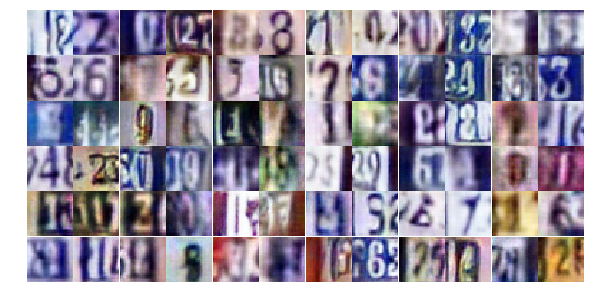

Epoch 22/25... Discriminator Loss: 0.6764... Generator Loss: 1.2082
Epoch 22/25... Discriminator Loss: 0.5071... Generator Loss: 1.4021
Epoch 22/25... Discriminator Loss: 0.3989... Generator Loss: 1.6959
Epoch 22/25... Discriminator Loss: 0.4876... Generator Loss: 1.4922
Epoch 22/25... Discriminator Loss: 0.5390... Generator Loss: 1.1748
Epoch 22/25... Discriminator Loss: 0.6447... Generator Loss: 1.2913
Epoch 22/25... Discriminator Loss: 0.5525... Generator Loss: 1.4021
Epoch 22/25... Discriminator Loss: 1.2437... Generator Loss: 0.5650
Epoch 22/25... Discriminator Loss: 1.0684... Generator Loss: 0.6376
Epoch 22/25... Discriminator Loss: 0.7902... Generator Loss: 1.0417


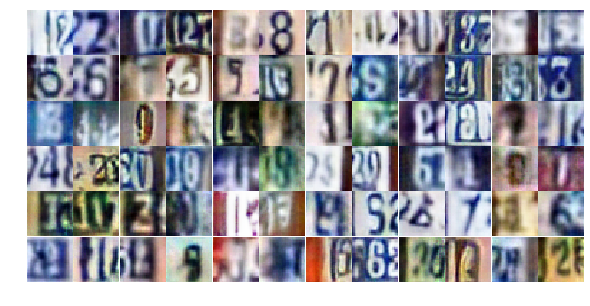

Epoch 22/25... Discriminator Loss: 1.2980... Generator Loss: 0.5089
Epoch 22/25... Discriminator Loss: 0.5618... Generator Loss: 1.1570
Epoch 22/25... Discriminator Loss: 1.0136... Generator Loss: 0.6232
Epoch 22/25... Discriminator Loss: 0.8415... Generator Loss: 0.9219
Epoch 22/25... Discriminator Loss: 0.6284... Generator Loss: 1.1670
Epoch 22/25... Discriminator Loss: 1.2379... Generator Loss: 0.5195
Epoch 22/25... Discriminator Loss: 0.8885... Generator Loss: 1.5099
Epoch 22/25... Discriminator Loss: 0.6222... Generator Loss: 1.1690
Epoch 22/25... Discriminator Loss: 0.8021... Generator Loss: 1.0629
Epoch 22/25... Discriminator Loss: 0.7000... Generator Loss: 1.0013


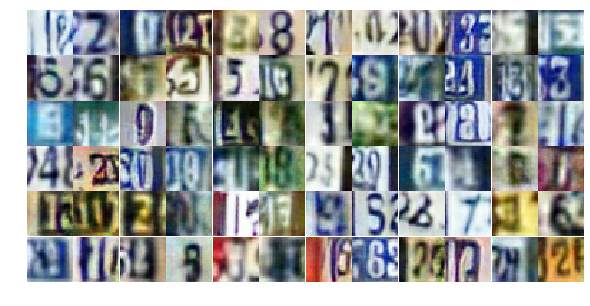

Epoch 23/25... Discriminator Loss: 0.7058... Generator Loss: 3.7777
Epoch 23/25... Discriminator Loss: 0.5725... Generator Loss: 1.2122
Epoch 23/25... Discriminator Loss: 1.0322... Generator Loss: 0.6327
Epoch 23/25... Discriminator Loss: 0.7472... Generator Loss: 0.9640
Epoch 23/25... Discriminator Loss: 0.8720... Generator Loss: 0.7428
Epoch 23/25... Discriminator Loss: 1.1764... Generator Loss: 0.5229
Epoch 23/25... Discriminator Loss: 1.0958... Generator Loss: 0.5954
Epoch 23/25... Discriminator Loss: 0.6251... Generator Loss: 1.3610
Epoch 23/25... Discriminator Loss: 0.6265... Generator Loss: 1.0934
Epoch 23/25... Discriminator Loss: 0.4582... Generator Loss: 1.6823


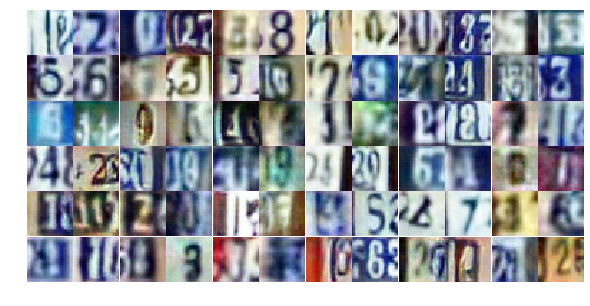

Epoch 23/25... Discriminator Loss: 0.6119... Generator Loss: 1.3579
Epoch 23/25... Discriminator Loss: 0.7845... Generator Loss: 0.9073
Epoch 23/25... Discriminator Loss: 0.6221... Generator Loss: 1.4517
Epoch 23/25... Discriminator Loss: 0.6828... Generator Loss: 1.0954
Epoch 23/25... Discriminator Loss: 0.4939... Generator Loss: 1.3816
Epoch 23/25... Discriminator Loss: 0.8308... Generator Loss: 0.9272
Epoch 23/25... Discriminator Loss: 0.7975... Generator Loss: 0.9553
Epoch 23/25... Discriminator Loss: 0.6551... Generator Loss: 1.0782
Epoch 23/25... Discriminator Loss: 0.7617... Generator Loss: 1.5943
Epoch 23/25... Discriminator Loss: 0.6671... Generator Loss: 1.3639


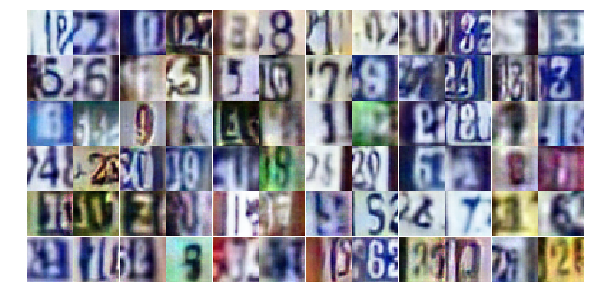

Epoch 23/25... Discriminator Loss: 0.7630... Generator Loss: 1.0886
Epoch 23/25... Discriminator Loss: 0.7940... Generator Loss: 0.8663
Epoch 23/25... Discriminator Loss: 1.2922... Generator Loss: 0.4724
Epoch 23/25... Discriminator Loss: 0.7396... Generator Loss: 0.8522
Epoch 23/25... Discriminator Loss: 0.7137... Generator Loss: 0.9575
Epoch 23/25... Discriminator Loss: 1.0132... Generator Loss: 3.2302
Epoch 23/25... Discriminator Loss: 0.9174... Generator Loss: 0.7230
Epoch 23/25... Discriminator Loss: 0.8730... Generator Loss: 0.7874
Epoch 23/25... Discriminator Loss: 0.5461... Generator Loss: 1.3770
Epoch 23/25... Discriminator Loss: 0.9519... Generator Loss: 0.7379


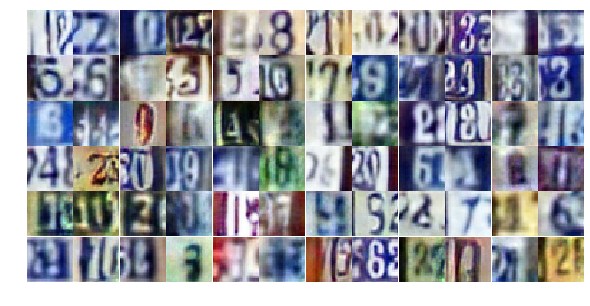

Epoch 23/25... Discriminator Loss: 0.6935... Generator Loss: 0.9883
Epoch 23/25... Discriminator Loss: 0.6673... Generator Loss: 1.0675
Epoch 23/25... Discriminator Loss: 0.7494... Generator Loss: 0.9401
Epoch 23/25... Discriminator Loss: 0.9970... Generator Loss: 0.6720
Epoch 23/25... Discriminator Loss: 0.9694... Generator Loss: 0.7617
Epoch 23/25... Discriminator Loss: 1.3625... Generator Loss: 0.4379
Epoch 23/25... Discriminator Loss: 0.8713... Generator Loss: 0.8285
Epoch 23/25... Discriminator Loss: 0.6810... Generator Loss: 1.1071
Epoch 23/25... Discriminator Loss: 0.5234... Generator Loss: 1.3999
Epoch 23/25... Discriminator Loss: 0.5981... Generator Loss: 1.1501


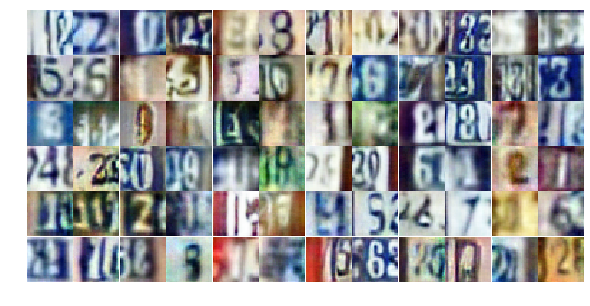

Epoch 23/25... Discriminator Loss: 0.6576... Generator Loss: 1.1350
Epoch 23/25... Discriminator Loss: 0.6775... Generator Loss: 1.0408
Epoch 23/25... Discriminator Loss: 1.1613... Generator Loss: 0.5268
Epoch 23/25... Discriminator Loss: 1.0022... Generator Loss: 0.7490
Epoch 23/25... Discriminator Loss: 1.2068... Generator Loss: 0.8619
Epoch 23/25... Discriminator Loss: 1.2520... Generator Loss: 3.5659
Epoch 23/25... Discriminator Loss: 0.7276... Generator Loss: 1.6123
Epoch 23/25... Discriminator Loss: 0.9824... Generator Loss: 1.2606
Epoch 23/25... Discriminator Loss: 0.9554... Generator Loss: 0.7553
Epoch 23/25... Discriminator Loss: 0.8755... Generator Loss: 0.9524


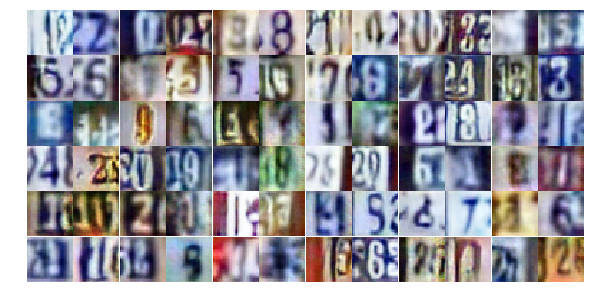

Epoch 23/25... Discriminator Loss: 0.6332... Generator Loss: 1.2790
Epoch 23/25... Discriminator Loss: 1.0612... Generator Loss: 0.6237
Epoch 23/25... Discriminator Loss: 0.7649... Generator Loss: 1.0858
Epoch 23/25... Discriminator Loss: 0.4975... Generator Loss: 1.2899
Epoch 23/25... Discriminator Loss: 1.1205... Generator Loss: 0.6977
Epoch 23/25... Discriminator Loss: 0.7400... Generator Loss: 2.0872
Epoch 23/25... Discriminator Loss: 0.7669... Generator Loss: 1.0598
Epoch 24/25... Discriminator Loss: 0.8883... Generator Loss: 0.8425
Epoch 24/25... Discriminator Loss: 0.8276... Generator Loss: 0.9582
Epoch 24/25... Discriminator Loss: 1.2215... Generator Loss: 0.5510


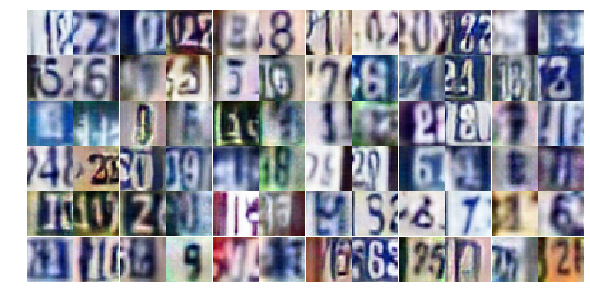

Epoch 24/25... Discriminator Loss: 0.5651... Generator Loss: 1.3817
Epoch 24/25... Discriminator Loss: 0.7900... Generator Loss: 1.0915
Epoch 24/25... Discriminator Loss: 0.8470... Generator Loss: 0.8201
Epoch 24/25... Discriminator Loss: 0.8022... Generator Loss: 0.9271
Epoch 24/25... Discriminator Loss: 0.8425... Generator Loss: 0.8009
Epoch 24/25... Discriminator Loss: 0.5070... Generator Loss: 1.4053
Epoch 24/25... Discriminator Loss: 0.8153... Generator Loss: 0.8316
Epoch 24/25... Discriminator Loss: 0.9487... Generator Loss: 0.7173
Epoch 24/25... Discriminator Loss: 0.5227... Generator Loss: 1.2565
Epoch 24/25... Discriminator Loss: 0.5471... Generator Loss: 2.3973


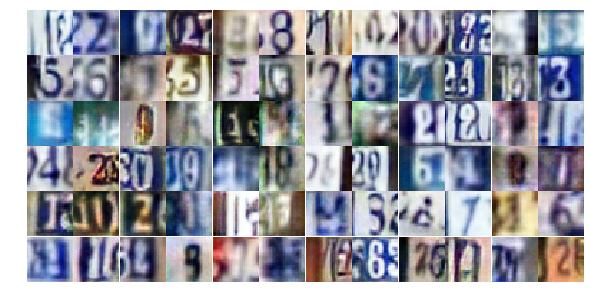

Epoch 24/25... Discriminator Loss: 1.1366... Generator Loss: 0.5558
Epoch 24/25... Discriminator Loss: 1.3152... Generator Loss: 0.4740
Epoch 24/25... Discriminator Loss: 1.0589... Generator Loss: 0.6205
Epoch 24/25... Discriminator Loss: 0.8141... Generator Loss: 0.7841
Epoch 24/25... Discriminator Loss: 0.4846... Generator Loss: 2.0042
Epoch 24/25... Discriminator Loss: 0.9189... Generator Loss: 0.7917
Epoch 24/25... Discriminator Loss: 0.5841... Generator Loss: 1.2244
Epoch 24/25... Discriminator Loss: 1.1504... Generator Loss: 0.5469
Epoch 24/25... Discriminator Loss: 1.1475... Generator Loss: 0.5963
Epoch 24/25... Discriminator Loss: 0.7567... Generator Loss: 0.9155


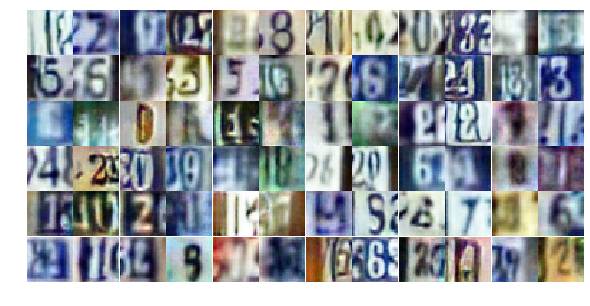

Epoch 24/25... Discriminator Loss: 0.9249... Generator Loss: 0.7731
Epoch 24/25... Discriminator Loss: 0.5673... Generator Loss: 1.2707
Epoch 24/25... Discriminator Loss: 0.4094... Generator Loss: 1.7812
Epoch 24/25... Discriminator Loss: 1.9304... Generator Loss: 0.2885
Epoch 24/25... Discriminator Loss: 0.9233... Generator Loss: 0.7091
Epoch 24/25... Discriminator Loss: 0.6138... Generator Loss: 1.1265
Epoch 24/25... Discriminator Loss: 0.7416... Generator Loss: 2.7176
Epoch 24/25... Discriminator Loss: 0.6017... Generator Loss: 2.8332
Epoch 24/25... Discriminator Loss: 0.9666... Generator Loss: 0.7463
Epoch 24/25... Discriminator Loss: 0.9312... Generator Loss: 0.8699


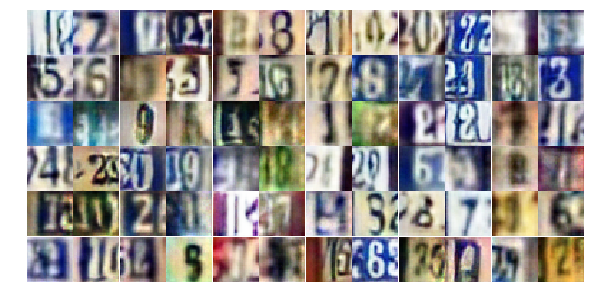

Epoch 24/25... Discriminator Loss: 0.9201... Generator Loss: 0.7708
Epoch 24/25... Discriminator Loss: 0.5524... Generator Loss: 1.4651
Epoch 24/25... Discriminator Loss: 0.9062... Generator Loss: 0.7569
Epoch 24/25... Discriminator Loss: 1.9076... Generator Loss: 0.2400
Epoch 24/25... Discriminator Loss: 1.1095... Generator Loss: 0.5938
Epoch 24/25... Discriminator Loss: 0.9179... Generator Loss: 0.8162
Epoch 24/25... Discriminator Loss: 1.0194... Generator Loss: 0.6322
Epoch 24/25... Discriminator Loss: 1.0397... Generator Loss: 0.6825
Epoch 24/25... Discriminator Loss: 0.6110... Generator Loss: 1.2914
Epoch 24/25... Discriminator Loss: 0.7419... Generator Loss: 1.7273


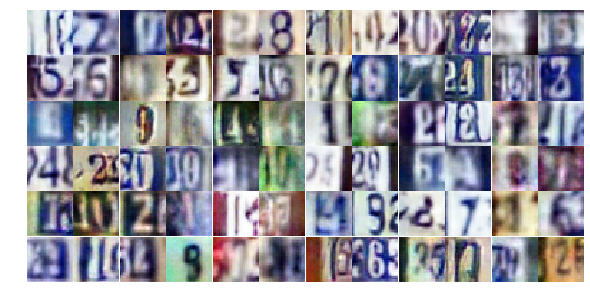

Epoch 24/25... Discriminator Loss: 0.6207... Generator Loss: 1.0977
Epoch 24/25... Discriminator Loss: 2.8776... Generator Loss: 0.1032
Epoch 24/25... Discriminator Loss: 2.2020... Generator Loss: 0.2195
Epoch 24/25... Discriminator Loss: 1.3957... Generator Loss: 0.4503
Epoch 24/25... Discriminator Loss: 1.0744... Generator Loss: 0.7248
Epoch 24/25... Discriminator Loss: 0.7411... Generator Loss: 1.0470
Epoch 24/25... Discriminator Loss: 0.9177... Generator Loss: 0.8169
Epoch 24/25... Discriminator Loss: 0.7302... Generator Loss: 1.0286
Epoch 24/25... Discriminator Loss: 0.8924... Generator Loss: 0.8220
Epoch 24/25... Discriminator Loss: 0.9928... Generator Loss: 0.6948


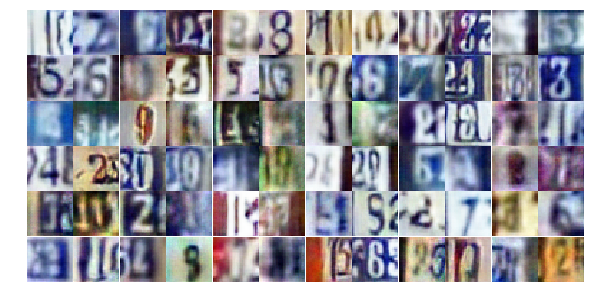

Epoch 24/25... Discriminator Loss: 0.7988... Generator Loss: 1.1751
Epoch 24/25... Discriminator Loss: 1.8370... Generator Loss: 0.2319
Epoch 24/25... Discriminator Loss: 0.8569... Generator Loss: 0.8424
Epoch 24/25... Discriminator Loss: 1.2768... Generator Loss: 0.4687
Epoch 24/25... Discriminator Loss: 1.4601... Generator Loss: 0.3743
Epoch 25/25... Discriminator Loss: 0.5923... Generator Loss: 1.4429
Epoch 25/25... Discriminator Loss: 0.6069... Generator Loss: 1.7128
Epoch 25/25... Discriminator Loss: 0.7635... Generator Loss: 0.9567
Epoch 25/25... Discriminator Loss: 0.9185... Generator Loss: 0.7428
Epoch 25/25... Discriminator Loss: 1.0189... Generator Loss: 0.6667


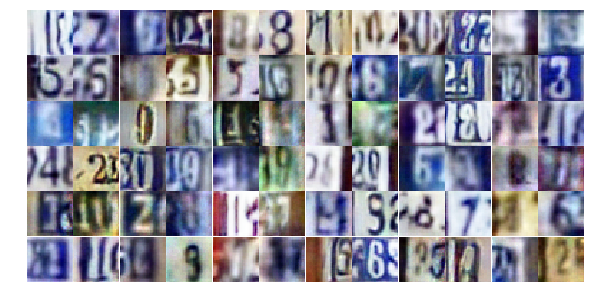

Epoch 25/25... Discriminator Loss: 1.0783... Generator Loss: 0.7155
Epoch 25/25... Discriminator Loss: 1.3941... Generator Loss: 0.4393
Epoch 25/25... Discriminator Loss: 0.7547... Generator Loss: 1.0382
Epoch 25/25... Discriminator Loss: 0.6842... Generator Loss: 1.1709
Epoch 25/25... Discriminator Loss: 0.9299... Generator Loss: 0.7955
Epoch 25/25... Discriminator Loss: 0.7343... Generator Loss: 0.8766
Epoch 25/25... Discriminator Loss: 0.6254... Generator Loss: 1.3830
Epoch 25/25... Discriminator Loss: 0.5769... Generator Loss: 1.1785
Epoch 25/25... Discriminator Loss: 0.5928... Generator Loss: 1.1632
Epoch 25/25... Discriminator Loss: 1.0175... Generator Loss: 0.6399


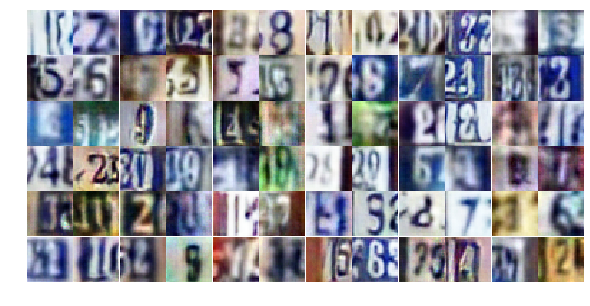

Epoch 25/25... Discriminator Loss: 0.8966... Generator Loss: 0.8148
Epoch 25/25... Discriminator Loss: 0.6680... Generator Loss: 2.2541
Epoch 25/25... Discriminator Loss: 1.4067... Generator Loss: 0.4728
Epoch 25/25... Discriminator Loss: 1.0407... Generator Loss: 0.6977
Epoch 25/25... Discriminator Loss: 0.6588... Generator Loss: 1.0469
Epoch 25/25... Discriminator Loss: 0.5896... Generator Loss: 1.4007
Epoch 25/25... Discriminator Loss: 1.1512... Generator Loss: 0.6259
Epoch 25/25... Discriminator Loss: 0.7458... Generator Loss: 1.2346
Epoch 25/25... Discriminator Loss: 0.6746... Generator Loss: 1.0513
Epoch 25/25... Discriminator Loss: 0.7898... Generator Loss: 0.8543


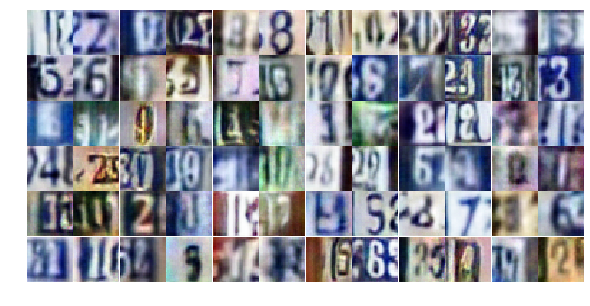

Epoch 25/25... Discriminator Loss: 1.1869... Generator Loss: 0.5913
Epoch 25/25... Discriminator Loss: 0.4689... Generator Loss: 1.6892
Epoch 25/25... Discriminator Loss: 1.3493... Generator Loss: 0.4833
Epoch 25/25... Discriminator Loss: 0.9230... Generator Loss: 0.8034
Epoch 25/25... Discriminator Loss: 0.8476... Generator Loss: 0.7992
Epoch 25/25... Discriminator Loss: 0.5868... Generator Loss: 1.2337
Epoch 25/25... Discriminator Loss: 0.8264... Generator Loss: 0.8174
Epoch 25/25... Discriminator Loss: 0.5874... Generator Loss: 1.3390
Epoch 25/25... Discriminator Loss: 0.8269... Generator Loss: 2.1629
Epoch 25/25... Discriminator Loss: 0.4136... Generator Loss: 1.8230


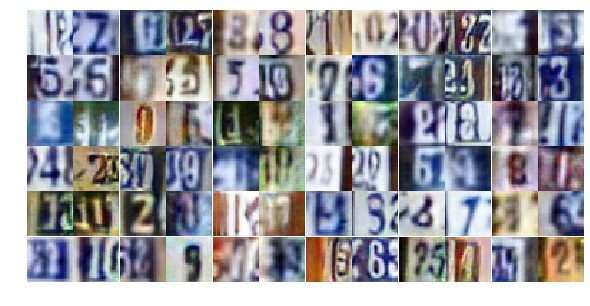

Epoch 25/25... Discriminator Loss: 1.0103... Generator Loss: 0.7142
Epoch 25/25... Discriminator Loss: 0.6391... Generator Loss: 1.1958
Epoch 25/25... Discriminator Loss: 0.7671... Generator Loss: 1.0322
Epoch 25/25... Discriminator Loss: 1.1036... Generator Loss: 0.6180
Epoch 25/25... Discriminator Loss: 0.8632... Generator Loss: 0.8778
Epoch 25/25... Discriminator Loss: 0.6897... Generator Loss: 1.0914
Epoch 25/25... Discriminator Loss: 1.0076... Generator Loss: 0.6806
Epoch 25/25... Discriminator Loss: 0.4798... Generator Loss: 1.3364
Epoch 25/25... Discriminator Loss: 1.9485... Generator Loss: 0.2754
Epoch 25/25... Discriminator Loss: 0.7366... Generator Loss: 0.8679


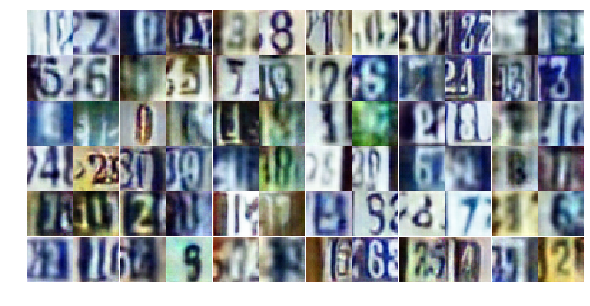

Epoch 25/25... Discriminator Loss: 0.5896... Generator Loss: 1.6543
Epoch 25/25... Discriminator Loss: 0.7727... Generator Loss: 0.8915
Epoch 25/25... Discriminator Loss: 0.8083... Generator Loss: 0.8883
Epoch 25/25... Discriminator Loss: 1.0898... Generator Loss: 0.6074
Epoch 25/25... Discriminator Loss: 0.8084... Generator Loss: 1.0197
Epoch 25/25... Discriminator Loss: 0.7869... Generator Loss: 0.8295
Epoch 25/25... Discriminator Loss: 0.8643... Generator Loss: 1.3162
Epoch 25/25... Discriminator Loss: 0.8879... Generator Loss: 0.7273
Epoch 25/25... Discriminator Loss: 1.1005... Generator Loss: 0.6108
Epoch 25/25... Discriminator Loss: 1.0428... Generator Loss: 0.6328


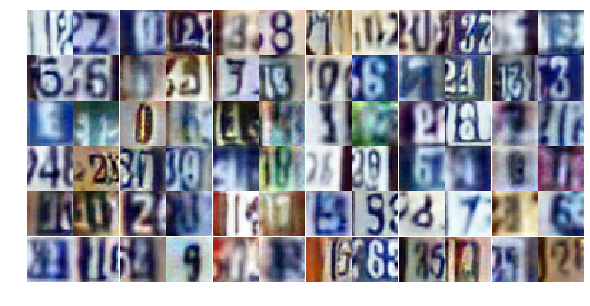

Epoch 25/25... Discriminator Loss: 0.5218... Generator Loss: 1.3156
Epoch 25/25... Discriminator Loss: 1.4155... Generator Loss: 0.4077


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

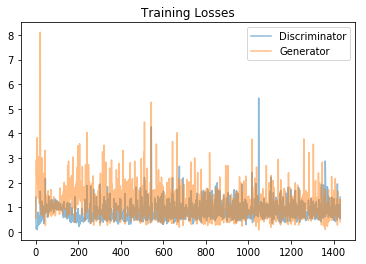

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

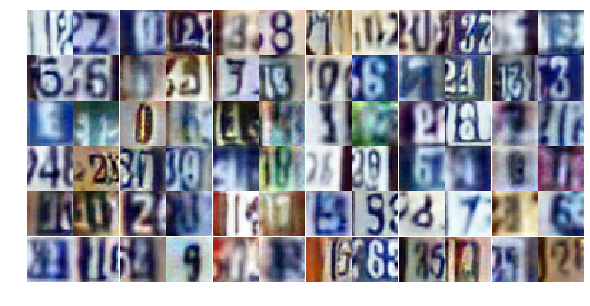

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))